# Supervised Learning - klasyfikacja
## 1. Klasyfikacja jako typ Supervised Learning
W przypadku klasyfikacji nie jest możliwe, aby oczekiwane wartości miały charakter ciągły, czyli były dowolnymi liczbami zmiennoprzecinkowymi. Musimy używać liczb całkowitych. Staramy się też wyznaczyć taką granicę pomiędzy klasami, tzw. "Decision Boundary", aby jak najlepiej je rozdzielić.
## 2. Klasyfikacja binarna
### Macierz omyłek
### Accuracy (Dokładność)
- Precision (Precyzja)
- Recall (Czułość)
- F1 score

In [7]:
import pandas as pd
diabetes = pd.read_csv('diabetes.csv')
diabetes

,PatientID,Pregnancies,PlasmaGlucose,DiastolicBloodPressure,TricepsThickness,SerumInsulin,BMI,DiabetesPedigree,Age,Diabetic
0,1354778,0,171,80,34,23,43.509726,1.213191,21,0
1,1147438,8,92,93,47,36,21.240576,0.158365,23,0
2,1640031,7,115,47,52,35,41.511523,0.079019,23,0
3,1883350,9,103,78,25,304,29.582192,1.282870,43,1
4,1424119,1,85,59,27,35,42.604536,0.549542,22,0
...,...,...,...,...,...,...,...,...,...,...
14995,1490300,10,65,60,46,177,33.512468,0.148327,41,1
14996,1744410,2,73,66,27,168,30.132636,0.862252,38,1
14997,1742742,0,93,89,43,57,18.690683,0.427049,24,0
14998,1099353,0,132,98,18,161,19.791645,0.302257,23,0


In [9]:
features = ['Pregnancies','PlasmaGlucose','DiastolicBloodPressure','TricepsThickness','SerumInsulin','BMI','DiabetesPedigree','Age']
target = 'Diabetic'
X, y = diabetes[features], diabetes[target]
print('X:')
display(X)
print('\ny:')
display(y)

X:


,Pregnancies,PlasmaGlucose,DiastolicBloodPressure,TricepsThickness,SerumInsulin,BMI,DiabetesPedigree,Age
0,0,171,80,34,23,43.509726,1.213191,21
1,8,92,93,47,36,21.240576,0.158365,23
2,7,115,47,52,35,41.511523,0.079019,23
3,9,103,78,25,304,29.582192,1.282870,43
4,1,85,59,27,35,42.604536,0.549542,22
...,...,...,...,...,...,...,...,...
14995,10,65,60,46,177,33.512468,0.148327,41
14996,2,73,66,27,168,30.132636,0.862252,38
14997,0,93,89,43,57,18.690683,0.427049,24
14998,0,132,98,18,161,19.791645,0.302257,23



y:


0        0
1        0
2        0
3        1
4        0
        ..
14995    1
14996    1
14997    0
14998    0
14999    1
Name: Diabetic, Length: 15000, dtype: int64

## 3. Eksploracyjna analiza danych dla klasyfikacji
### Zadaniem EDA jest zrozumienie danych

In [12]:
pd.Series(y).value_counts(normalize=True)

Diabetic
0    0.666667
1    0.333333
Name: proportion, dtype: float64

In [14]:
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15000 entries, 0 to 14999
Data columns (total 10 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   PatientID               15000 non-null  int64  
 1   Pregnancies             15000 non-null  int64  
 2   PlasmaGlucose           15000 non-null  int64  
 3   DiastolicBloodPressure  15000 non-null  int64  
 4   TricepsThickness        15000 non-null  int64  
 5   SerumInsulin            15000 non-null  int64  
 6   BMI                     15000 non-null  float64
 7   DiabetesPedigree        15000 non-null  float64
 8   Age                     15000 non-null  int64  
 9   Diabetic                15000 non-null  int64  
dtypes: float64(2), int64(8)
memory usage: 1.1 MB


In [16]:
X.describe()

,Pregnancies,PlasmaGlucose,DiastolicBloodPressure,TricepsThickness,SerumInsulin,BMI,DiabetesPedigree,Age
count,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000
mean,3.224533,107.856867,71.220667,28.814000,137.852133,31.509646,0.398968,30.137733
std,3.391020,31.981975,16.758716,14.555716,133.068252,9.759000,0.377944,12.089703
min,0.000000,44.000000,24.000000,7.000000,14.000000,18.200512,0.078044,21.000000
25%,0.000000,84.000000,58.000000,15.000000,39.000000,21.259887,0.137743,22.000000
50%,2.000000,104.000000,72.000000,31.000000,83.000000,31.767940,0.200297,24.000000
75%,6.000000,129.000000,85.000000,41.000000,195.000000,39.259692,0.616285,35.000000
max,14.000000,192.000000,117.000000,93.000000,799.000000,56.034628,2.301594,77.000000


Unique values: 15


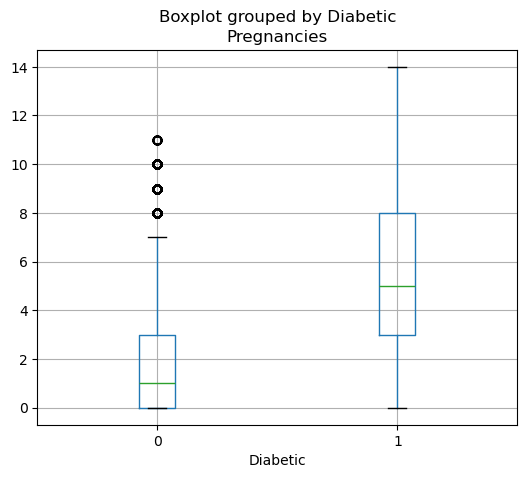

Unique values: 149


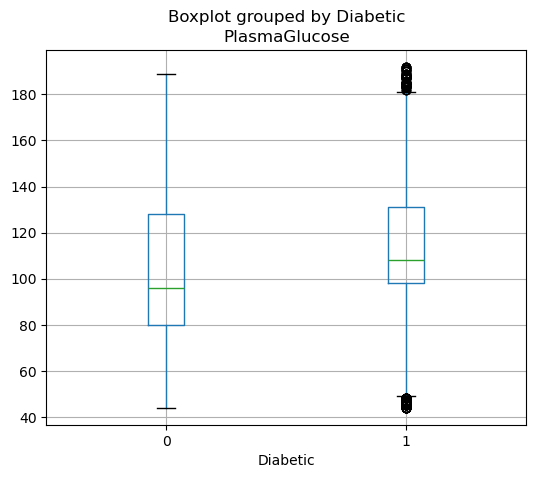

Unique values: 90


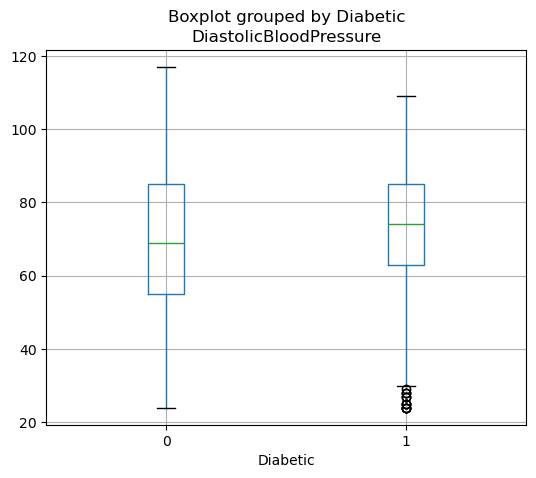

Unique values: 69


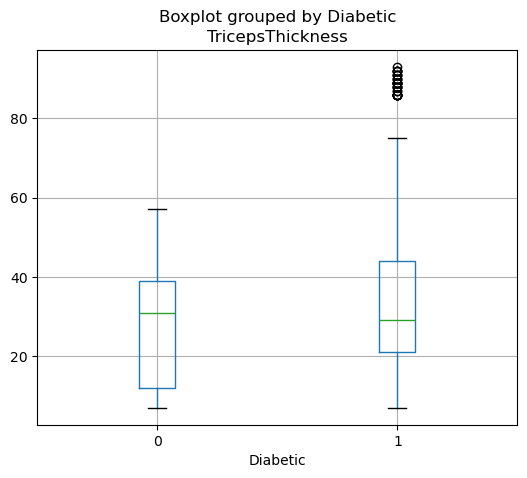

Unique values: 663


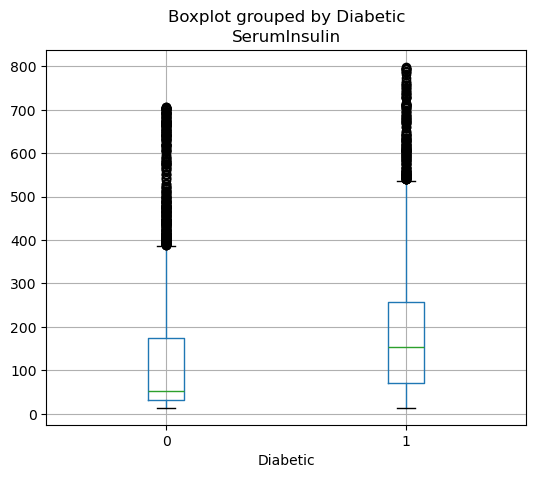

Unique values: 15000


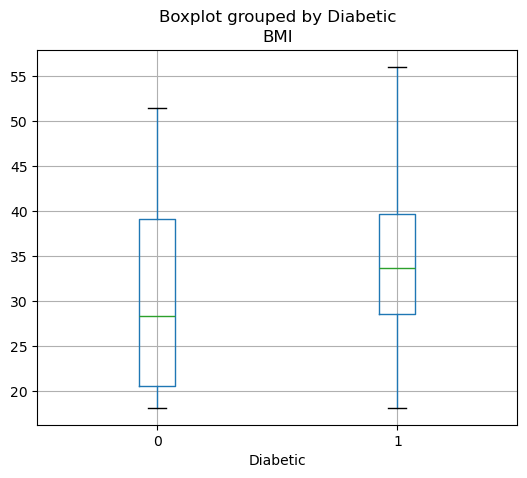

Unique values: 14999


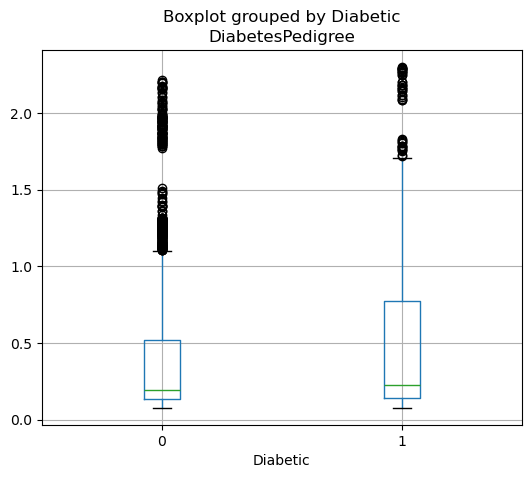

Unique values: 56


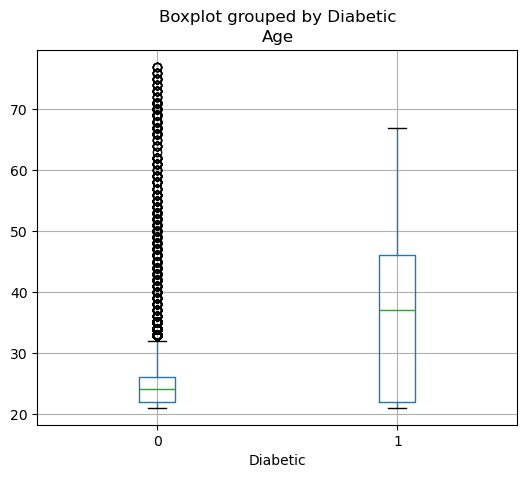

In [18]:
import matplotlib.pyplot as plt
for col in features:
    print(f'Unique values: {len(diabetes[col].unique())}')
    diabetes.boxplot(column=col, by='Diabetic', figsize=(6,5))
    plt.title(col)
    plt.show()

C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(diabetes.loc[diabetes['Diabetic']==0, col], kde=True, color='green', label='Osoba zdrowa')
C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe57

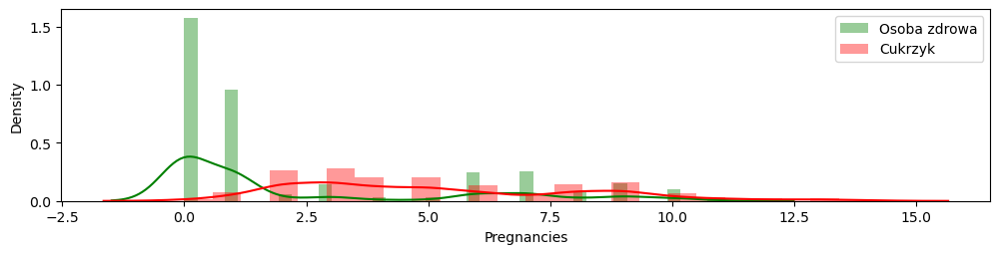

C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(diabetes.loc[diabetes['Diabetic']==0, col], kde=True, color='green', label='Osoba zdrowa')
C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe57

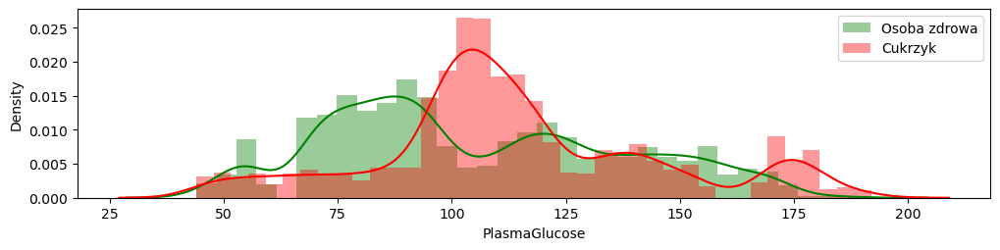

C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(diabetes.loc[diabetes['Diabetic']==0, col], kde=True, color='green', label='Osoba zdrowa')
C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe57

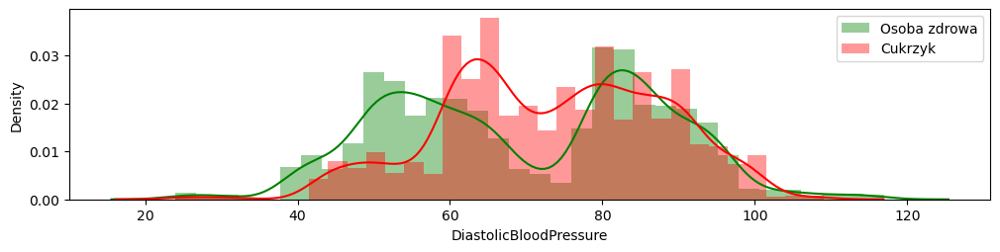

C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(diabetes.loc[diabetes['Diabetic']==0, col], kde=True, color='green', label='Osoba zdrowa')
C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe57

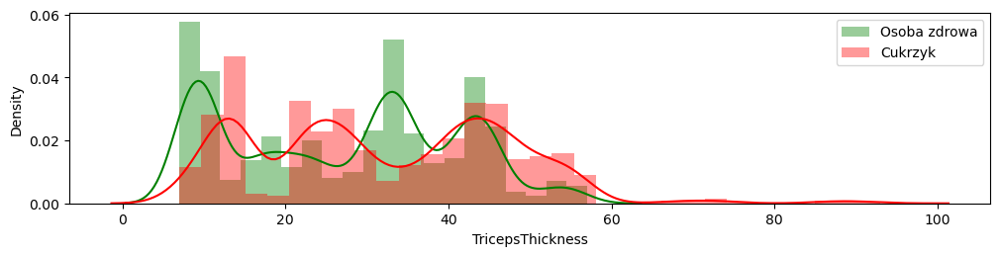

C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(diabetes.loc[diabetes['Diabetic']==0, col], kde=True, color='green', label='Osoba zdrowa')
C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe57

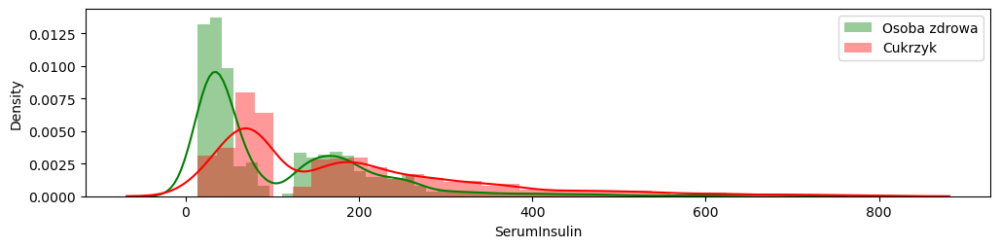

C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(diabetes.loc[diabetes['Diabetic']==0, col], kde=True, color='green', label='Osoba zdrowa')
C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe57

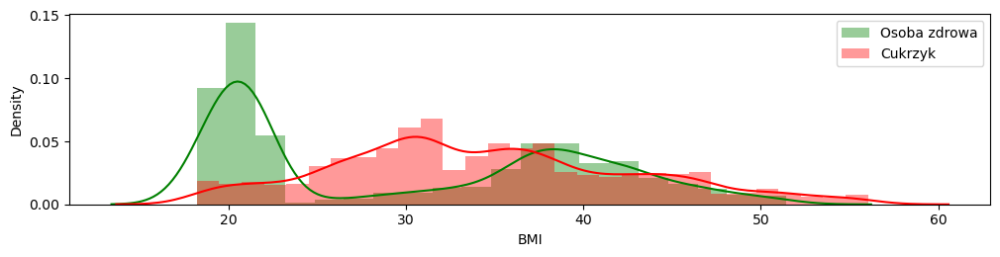

C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(diabetes.loc[diabetes['Diabetic']==0, col], kde=True, color='green', label='Osoba zdrowa')
C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe57

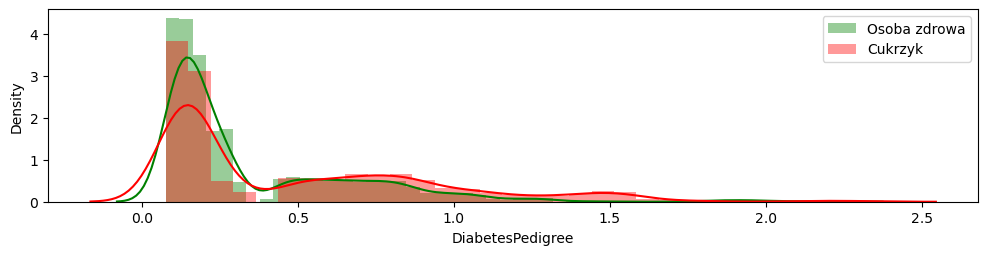

C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(diabetes.loc[diabetes['Diabetic']==0, col], kde=True, color='green', label='Osoba zdrowa')
C:\Users\User\AppData\Local\Temp\ipykernel_17856\3377817562.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe57

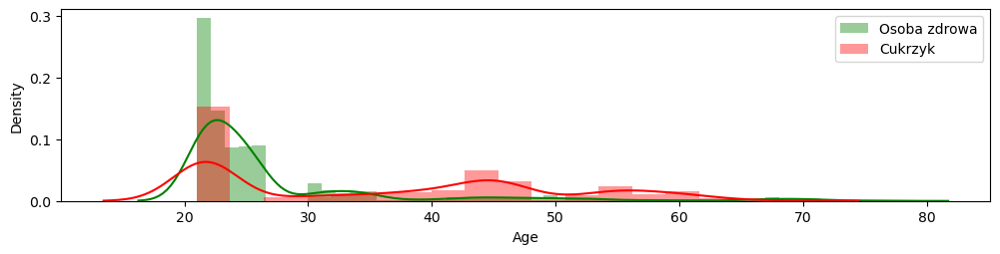

In [19]:
import seaborn as sns
for col in features:
    plt.figure(figsize=(12, 2.5))
    sns.distplot(diabetes.loc[diabetes['Diabetic']==0, col], kde=True, color='green', label='Osoba zdrowa')
    sns.distplot(diabetes.loc[diabetes['Diabetic']==1, col], kde=True, color='red', label='Cukrzyk')
    plt.legend(loc='upper right')
    plt.show()

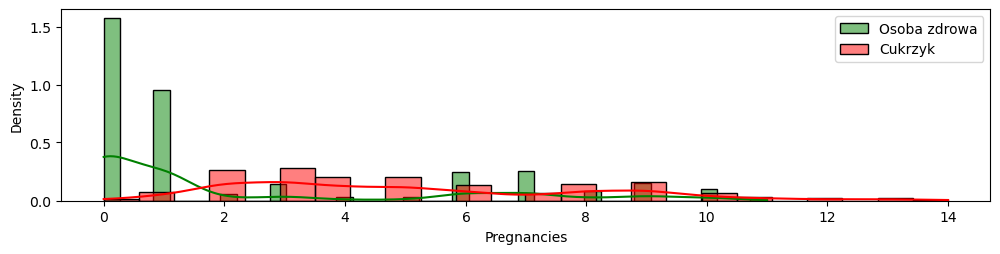

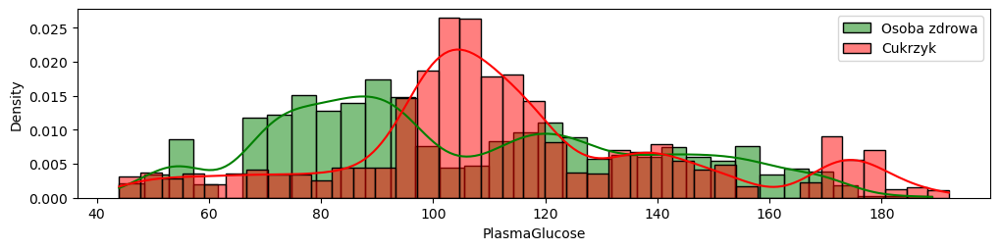

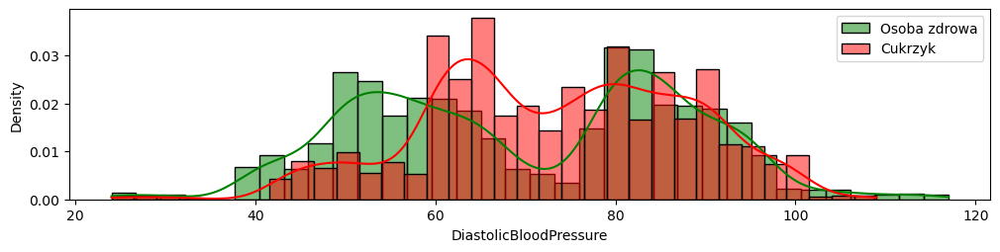

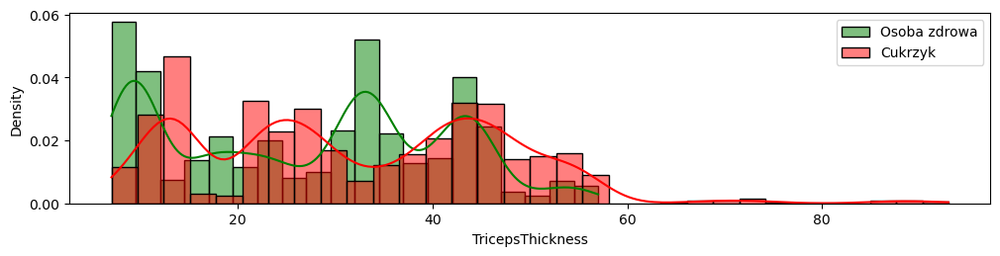

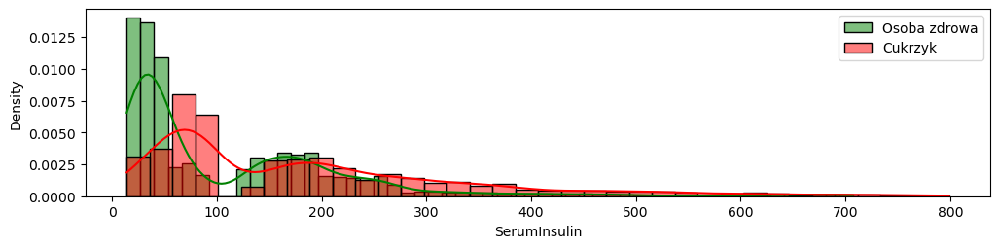

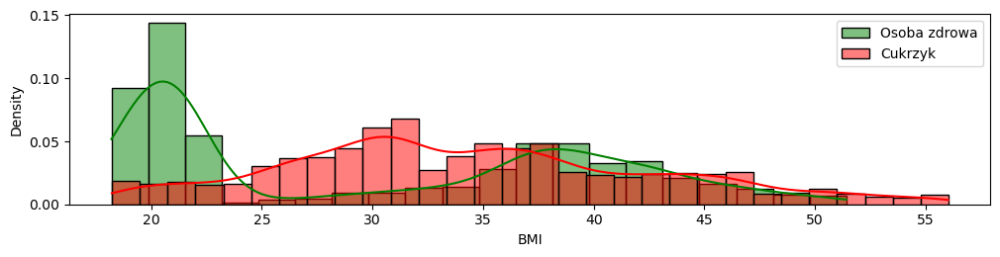

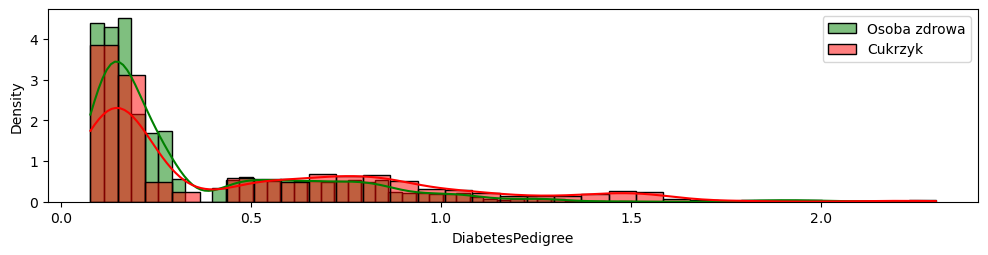

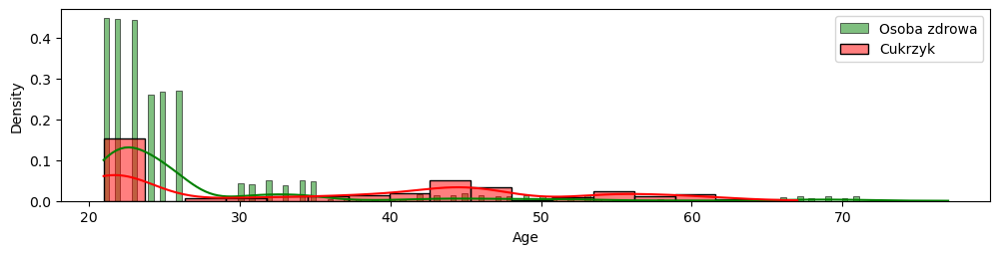

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt

for col in features:
    plt.figure(figsize=(12, 2.5))
    sns.histplot(diabetes.loc[diabetes['Diabetic']==0, col], kde=True, color='green', label='Osoba zdrowa', stat='density')
    sns.histplot(diabetes.loc[diabetes['Diabetic']==1, col], kde=True, color='red', label='Cukrzyk', stat='density')
    plt.legend(loc='upper right')
    plt.show()

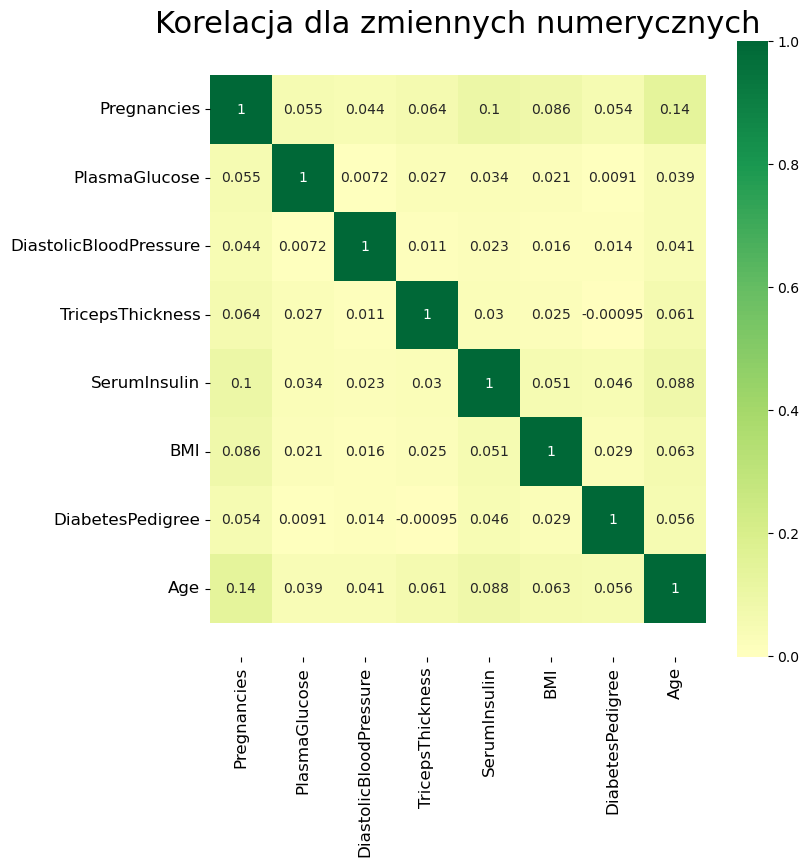

In [23]:
plt.figure(figsize=(8, 8))
ax = sns.heatmap(X.corr(),
                 xticklabels=X.corr().columns,
                 yticklabels=X.corr().columns,
                 cmap='RdYlGn',
                 center=0,
                 annot=True)

plt.title('Korelacja dla zmiennych numerycznych', fontsize=22)
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

In [26]:
from scipy import stats

corr_dict = {}
for col in features:
    corr_dict[col] = stats.pointbiserialr(X[col], y)[0]
pd.Series(corr_dict).sort_values(ascending=False)

Pregnancies               0.407315
Age                       0.342605
SerumInsulin              0.247375
BMI                       0.210508
DiabetesPedigree          0.170302
TricepsThickness          0.152505
PlasmaGlucose             0.128004
DiastolicBloodPressure    0.091307
dtype: float64

In [28]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X[['Pregnancies', 'Age']], y, test_size=0.30, random_state=0, stratify=y)
print ('Treningowe obserwacje: %d\nTestowe obserwacje: %d' % (X_train.shape[0], X_test.shape[0]))

Treningowe obserwacje: 10500
Testowe obserwacje: 4500


### Regresja logistyczna

In [31]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler

scaler_2var = StandardScaler()
X_train_standardized = scaler_2var.fit_transform(X_train)
X_test_standardized = scaler_2var.transform(X_test)
model_lr = LogisticRegression()
model_lr.fit(X_train_standardized, y_train)

LogisticRegression()

C:\Users\User\AppData\Local\Temp\ipykernel_17856\3056952232.py:43: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(X_plot[row_ix, 0], X_plot[row_ix, 1], cmap='Paired', alpha=0.3, label=class_value)


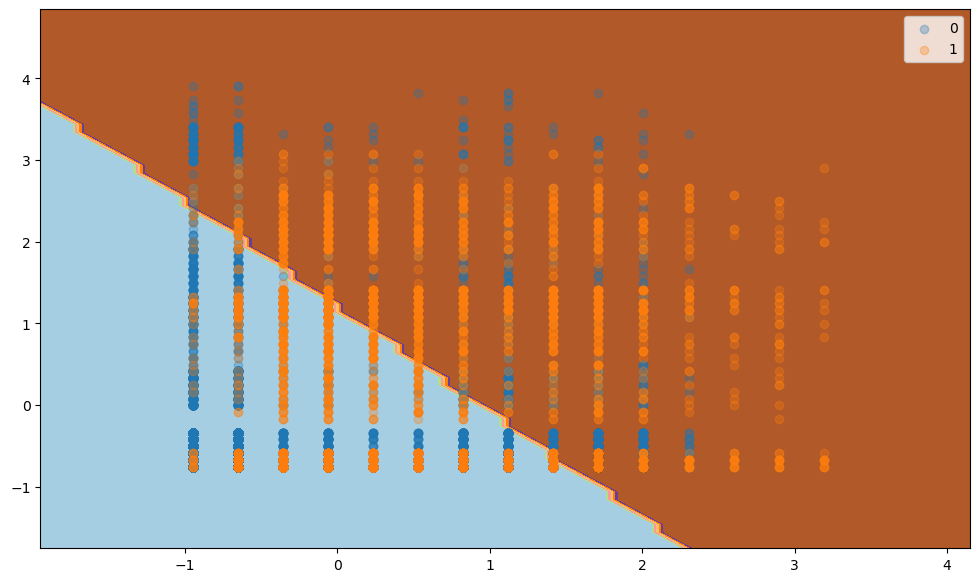

In [33]:
from numpy import where
from numpy import meshgrid
from numpy import arange
from numpy import hstack

def plot_classification_surface(X_plot, y_plot, trained_model):
    plt.figure(figsize=(12, 7))

    # określenie granic zbioru
    min1, max1 = X_plot[:, 0].min()-1, X_plot[:, 0].max()+1
    min2, max2 = X_plot[:, 1].min()-1, X_plot[:, 1].max()+1

    # skalowanie dla obu osi
    x1grid = arange(min1, max1, 0.1)
    x2grid = arange(min2, max2, 0.1)

    # utworzenie siatki
    xx, yy = meshgrid(x1grid, x2grid)

    # przetworzenie siatki w wektor
    r1, r2 = xx.flatten(), yy.flatten()
    r1, r2 = r1.reshape((len(r1), 1)), r2.reshape((len(r2), 1))

    # stworzenie zmiennych objaśniających dla modelu
    grid = hstack((r1,r2))

    # predykcja modelu zbioru
    yhat = trained_model.predict(grid)

    # przetworzenie predykcji na decyzji dla konkretnego punktu wykresu
    zz = yhat.reshape(xx.shape)

    # wizualizacja siatki z przyporządkowaną klasą
    plt.contourf(xx, yy, zz, cmap='Paired')

    # tworzenie wykresu punktowego dla klas ze zbioru X
    for class_value in range(2):

        # przyporządkowanie klasy (y) do obsewacji (X)
        row_ix = where(y_plot == class_value)

        # stworzenie wykresu punktowego
        plt.scatter(X_plot[row_ix, 0], X_plot[row_ix, 1], cmap='Paired', alpha=0.3, label=class_value)

    # wizualizacja wykresu
    plt.legend(loc='upper right')
    plt.show()

plot_classification_surface(X_plot=X_train_standardized, y_plot=y_train, trained_model=model_lr)

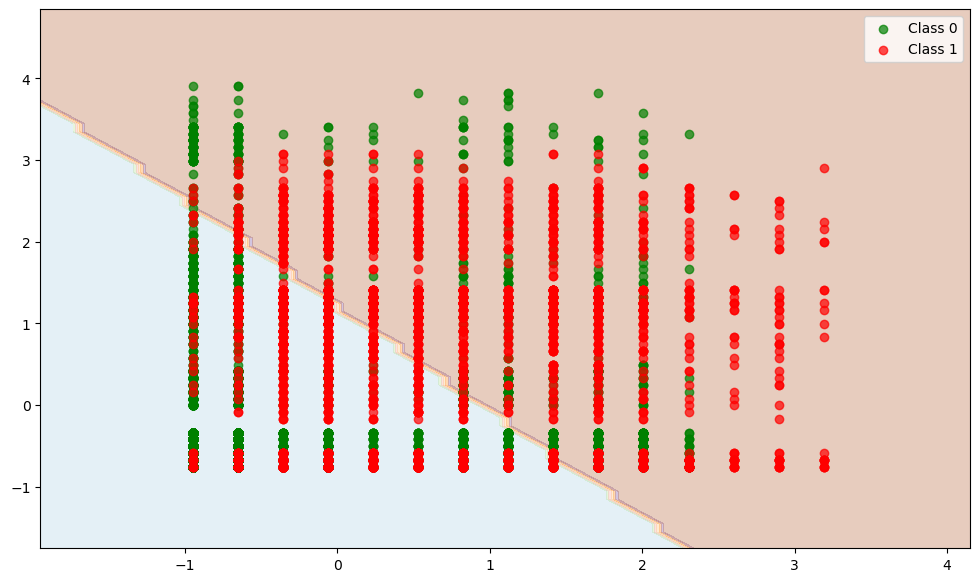

In [35]:
from numpy import where
from numpy import meshgrid
from numpy import arange
from numpy import hstack
import matplotlib.pyplot as plt

def plot_classification_surface(X_plot, y_plot, trained_model):
    plt.figure(figsize=(12, 7))

    # określenie granic zbioru
    min1, max1 = X_plot[:, 0].min()-1, X_plot[:, 0].max()+1
    min2, max2 = X_plot[:, 1].min()-1, X_plot[:, 1].max()+1

    # skalowanie dla obu osi
    x1grid = arange(min1, max1, 0.1)
    x2grid = arange(min2, max2, 0.1)

    # utworzenie siatki
    xx, yy = meshgrid(x1grid, x2grid)

    # przetworzenie siatki w wektor
    r1, r2 = xx.flatten(), yy.flatten()
    r1, r2 = r1.reshape((len(r1), 1)), r2.reshape((len(r2), 1))

    # stworzenie zmiennych objaśniających dla modelu
    grid = hstack((r1, r2))

    # predykcja modelu zbioru
    yhat = trained_model.predict(grid)

    # przetworzenie predykcji na decyzji dla konkretnego punktu wykresu
    zz = yhat.reshape(xx.shape)

    # wizualizacja siatki z przyporządkowaną klasą
    plt.contourf(xx, yy, zz, cmap='Paired', alpha=0.3)

    # tworzenie wykresu punktowego dla klas ze zbioru X
    for class_value in range(2):
        # przyporządkowanie klasy (y) do obserwacji (X)
        row_ix = where(y_plot == class_value)

        # stworzenie wykresu punktowego z jawnie przypisanym kolorem
        plt.scatter(
            X_plot[row_ix, 0], 
            X_plot[row_ix, 1], 
            c=['green' if class_value == 0 else 'red'],  # jawne kolory
            alpha=0.7, 
            label=f"Class {class_value}"
        )

    # wizualizacja wykresu
    plt.legend(loc='upper right')
    plt.show()

plot_classification_surface(X_plot=X_train_standardized, y_plot=y_train, trained_model=model_lr)

### Ocena modelu

In [38]:
predictions_lr = model_lr.predict(X_test_standardized)
print('Predicted labels: ', predictions_lr[:5], predictions_lr[-5:])
print('Actual labels:    ' , y_test[:5].values, y_test[-5:].values)

Predicted labels:  [0 0 1 0 0] [1 0 1 0 0]
Actual labels:     [0 1 0 0 0] [1 1 0 0 0]


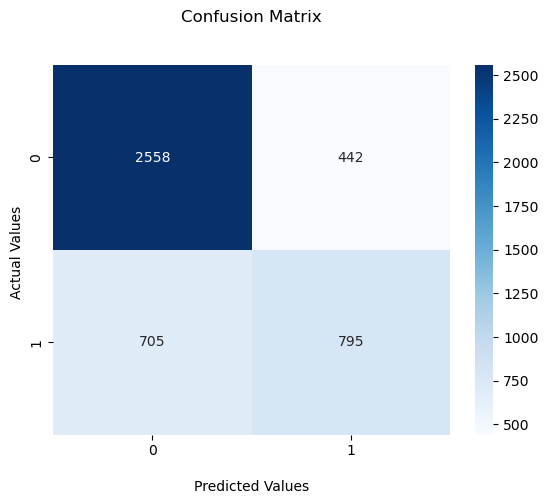

In [40]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

cm = confusion_matrix(y_test, predictions_lr)
ax = sns.heatmap(cm, annot=True, cmap='Blues', fmt='.0f')
ax.set_title('Confusion Matrix\n\n')
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ')
plt.show()

In [42]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

print('Accuracy: ', accuracy_score(y_test, predictions_lr))
print("Precision:", precision_score(y_test, predictions_lr))
print("Recall:", recall_score(y_test, predictions_lr))
print("F1_score:", f1_score(y_test, predictions_lr))

Accuracy:  0.7451111111111111
Precision: 0.6426839126919968
Recall: 0.53
F1_score: 0.5809280233832663


In [44]:
from sklearn.metrics import classification_report

print(classification_report(y_test, predictions_lr))

              precision    recall  f1-score   support

           0       0.78      0.85      0.82      3000
           1       0.64      0.53      0.58      1500

    accuracy                           0.75      4500
   macro avg       0.71      0.69      0.70      4500
weighted avg       0.74      0.75      0.74      4500



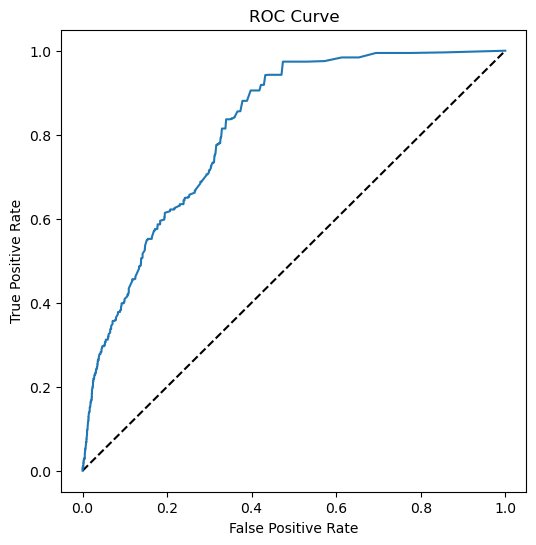

AUC: 0.8164931111111111


In [46]:
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

# prognoza prawdopodobieństwa
predictions_probability_lr = model_lr.predict_proba(X_test_standardized)

# obliczenie FPR oraz TPR w zależności od punktu odcięcia
fpr, tpr, thresholds = roc_curve(y_test, predictions_probability_lr[:,1])

# wizualizacja ROC Curve
fig = plt.figure(figsize=(6, 6))

# rysowanie prostej dla modelu losowego
plt.plot([0, 1], [0, 1], 'k--')
plt.plot(fpr, tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.show()

# obliczenie AUC
auc = roc_auc_score(y_test, predictions_probability_lr[:,1])
print('AUC: ' + str(auc))

              precision    recall  f1-score   support

           0       0.78      0.85      0.82      3000
           1       0.64      0.53      0.58      1500

    accuracy                           0.75      4500
   macro avg       0.71      0.69      0.70      4500
weighted avg       0.74      0.75      0.74      4500



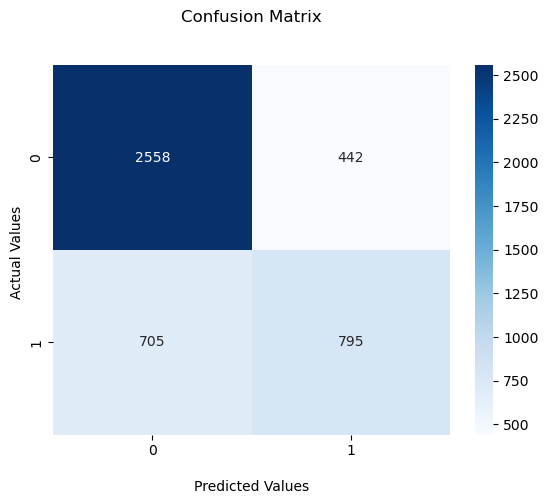

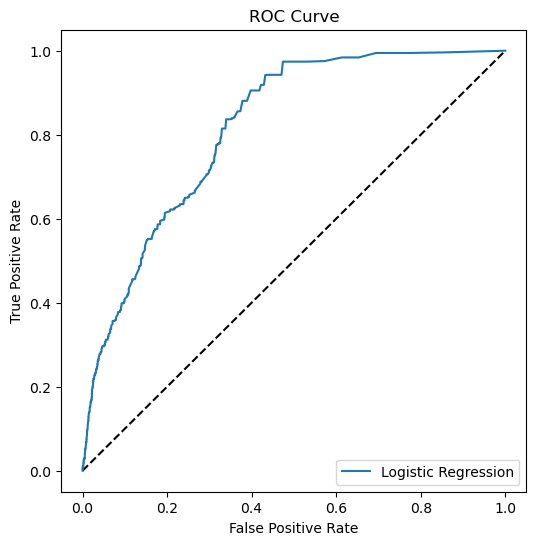

AttributeError: 'DataFrame' object has no attribute 'append'

In [48]:
metrics_dataframe = pd.DataFrame(columns = ['Model', 'F1_score', 'AUC'])
metrics_dataframe
models = []
models_names = []
predictions_proba_list = []
def calculate_metrics(model, name, X_checked, y_checked):
    models.append(model)
    models_names.append(name)
    global metrics_dataframe
    predictions = model.predict(X_checked)
    predictions_proba = model.predict_proba(X_checked)
    predictions_proba_list.append(predictions_proba[:,1])

    ############## metryki dla sprawdzanego modelu ################
    # Precision, Recall, F1, Accuracy
    print(classification_report(y_checked, predictions))

    # Confusion matrix
    plt.figure()
    cm = confusion_matrix(y_checked, predictions)
    ax = sns.heatmap(cm, annot=True, cmap='Blues', fmt='.0f')
    ax.set_title('Confusion Matrix\n\n')
    ax.set_xlabel('\nPredicted Values')
    ax.set_ylabel('Actual Values ')
    plt.show()

    # plot ROC curve
    fig = plt.figure(figsize=(6, 6))
    plt.plot([0, 1], [0, 1], 'k--')
    for model_selected, name_selected, pred_proba in zip(models, models_names, predictions_proba_list):
        fpr, tpr, thresholds = roc_curve(y_checked, pred_proba)
        plt.plot(fpr, tpr, label=name_selected)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend(loc='lower right')
    plt.show()

    f1_metric = f1_score(y_checked, predictions)
    auc_metric = roc_auc_score(y_checked, predictions_proba[:,1])
    metrics_dataframe = metrics_dataframe.append({'Model': name, 'F1_score': f1_metric, 'AUC': auc_metric},
                                                 ignore_index=True)
    return metrics_dataframe


calculate_metrics(model_lr, 'Logistic Regression', X_test_standardized, y_test)

              precision    recall  f1-score   support

           0       0.78      0.85      0.82      3000
           1       0.64      0.53      0.58      1500

    accuracy                           0.75      4500
   macro avg       0.71      0.69      0.70      4500
weighted avg       0.74      0.75      0.74      4500



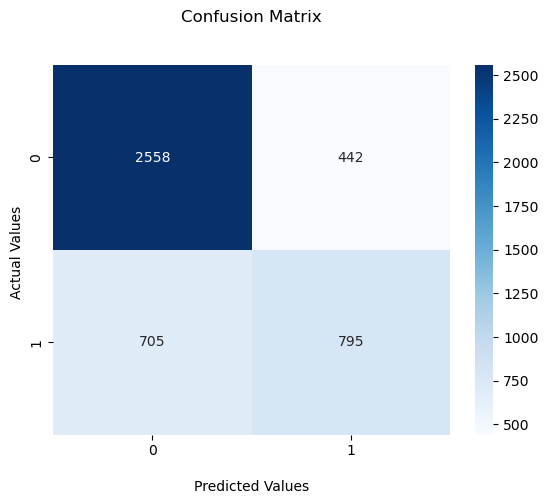

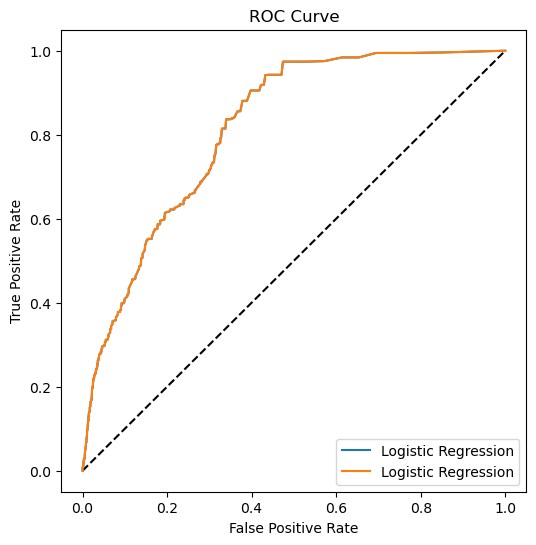

C:\Users\User\AppData\Local\Temp\ipykernel_17856\1958032431.py:45: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  metrics_dataframe = pd.concat([metrics_dataframe, new_row], ignore_index=True)


,Model,F1_score,AUC
0,Logistic Regression,0.580928,0.816493


In [50]:
def calculate_metrics(model, name, X_checked, y_checked):
    models.append(model)
    models_names.append(name)
    global metrics_dataframe
    
    predictions = model.predict(X_checked)
    predictions_proba = model.predict_proba(X_checked)
    predictions_proba_list.append(predictions_proba[:,1])

    ############## metryki dla sprawdzanego modelu ################
    # Precision, Recall, F1, Accuracy
    print(classification_report(y_checked, predictions))

    # Confusion matrix
    plt.figure()
    cm = confusion_matrix(y_checked, predictions)
    ax = sns.heatmap(cm, annot=True, cmap='Blues', fmt='.0f')
    ax.set_title('Confusion Matrix\n\n')
    ax.set_xlabel('\nPredicted Values')
    ax.set_ylabel('Actual Values ')
    plt.show()

    # plot ROC curve
    fig = plt.figure(figsize=(6, 6))
    plt.plot([0, 1], [0, 1], 'k--')
    for model_selected, name_selected, pred_proba in zip(models, models_names, predictions_proba_list):
        fpr, tpr, thresholds = roc_curve(y_checked, pred_proba)
        plt.plot(fpr, tpr, label=name_selected)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend(loc='lower right')
    plt.show()

    f1_metric = f1_score(y_checked, predictions)
    auc_metric = roc_auc_score(y_checked, predictions_proba[:,1])
    
    # Nowy sposób dodawania wiersza - tworzenie nowego DataFrame i łączenie
    new_row = pd.DataFrame({
        'Model': [name],
        'F1_score': [f1_metric],
        'AUC': [auc_metric]
    })
    
    metrics_dataframe = pd.concat([metrics_dataframe, new_row], ignore_index=True)
    
    return metrics_dataframe

calculate_metrics(model_lr, 'Logistic Regression', X_test_standardized, y_test)

              precision    recall  f1-score   support

           0       0.78      0.85      0.82      3000
           1       0.64      0.53      0.58      1500

    accuracy                           0.75      4500
   macro avg       0.71      0.69      0.70      4500
weighted avg       0.74      0.75      0.74      4500



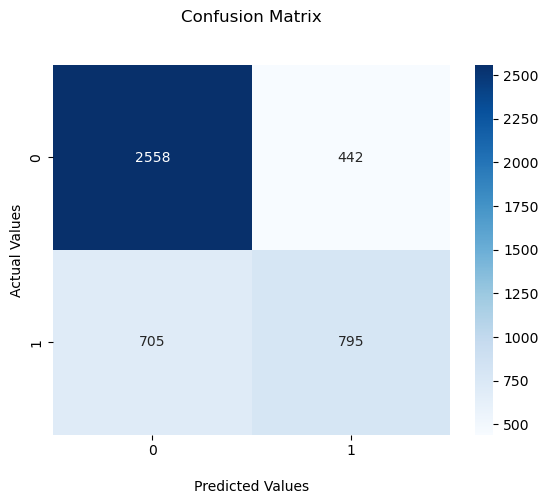

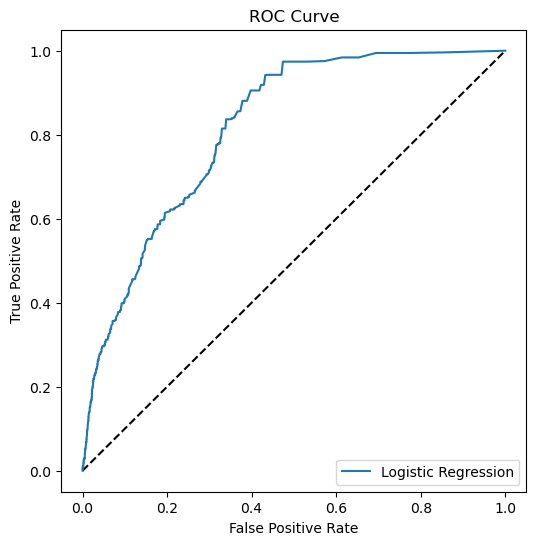

,Model,F1_score,AUC
0,Logistic Regression,0.580928,0.816493


In [52]:
metrics_dataframe = pd.DataFrame(columns=['Model', 'F1_score', 'AUC'])
models = []
models_names = []
predictions_proba_list = []

def calculate_metrics(model, name, X_checked, y_checked):
    models.append(model)
    models_names.append(name)
    global metrics_dataframe
    
    predictions = model.predict(X_checked)
    predictions_proba = model.predict_proba(X_checked)
    predictions_proba_list.append(predictions_proba[:,1])

    print(classification_report(y_checked, predictions))

    plt.figure()
    cm = confusion_matrix(y_checked, predictions)
    ax = sns.heatmap(cm, annot=True, cmap='Blues', fmt='.0f')
    ax.set_title('Confusion Matrix\n\n')
    ax.set_xlabel('\nPredicted Values')
    ax.set_ylabel('Actual Values')
    plt.show()

    fig = plt.figure(figsize=(6, 6))
    plt.plot([0, 1], [0, 1], 'k--')
    for model_selected, name_selected, pred_proba in zip(models, models_names, predictions_proba_list):
        fpr, tpr, thresholds = roc_curve(y_checked, pred_proba)
        plt.plot(fpr, tpr, label=name_selected)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend(loc='lower right')
    plt.show()

    f1_metric = f1_score(y_checked, predictions)
    auc_metric = roc_auc_score(y_checked, predictions_proba[:,1])
    
    new_row = pd.DataFrame({
        'Model': [name],
        'F1_score': [f1_metric],
        'AUC': [auc_metric]
    })
    
    if metrics_dataframe.empty:
        metrics_dataframe = new_row
    else:
        metrics_dataframe = pd.concat([metrics_dataframe, new_row], ignore_index=True)
    
    return metrics_dataframe

calculate_metrics(model_lr, 'Logistic Regression', X_test_standardized, y_test)

## 4. Klasyfikatory
### KNN (K Nearest Neighbours) – K najbliższych sąsiadów

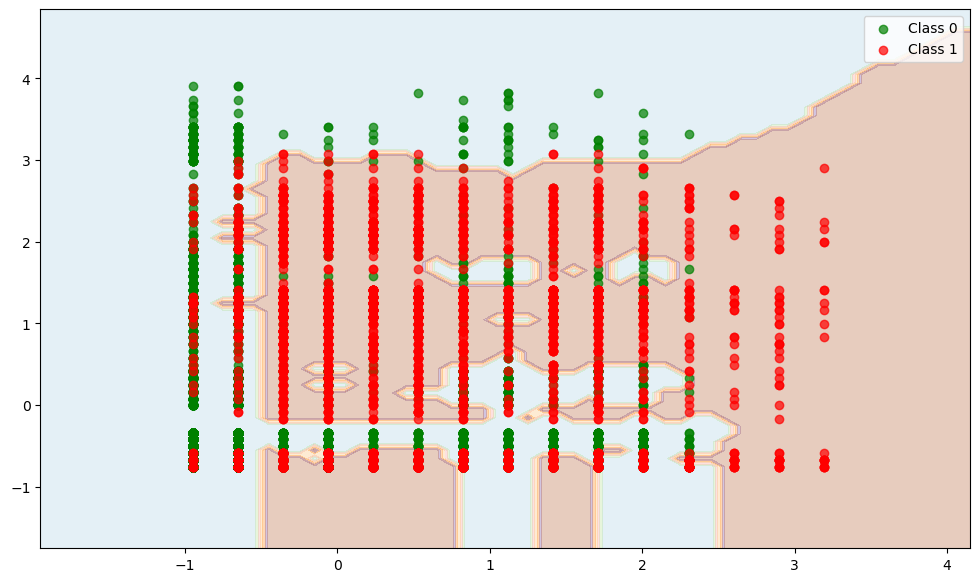

In [55]:
from sklearn.neighbors import KNeighborsClassifier

model_knn = KNeighborsClassifier(n_neighbors= int(X_train_standardized.shape[0]*0.001))
model_knn.fit(X_train_standardized, y_train)
plot_classification_surface(X_plot=X_train_standardized, y_plot=y_train, trained_model=model_knn)

### Ćwiczenie
Sprawdź jak zachowuje się model dla różnych K i metryk. Zwizualizuj działanie modelu z wykorzystaniem funkcji plot_classification_surface oraz za każdym razem oblicz F1_score na zbiorze treningowym oraz testowym.


Testing KNN with metric: euclidean

K = 1
Train F1 score: 0.8021
Test F1 score: 0.7835


<Figure size 1000x600 with 0 Axes>

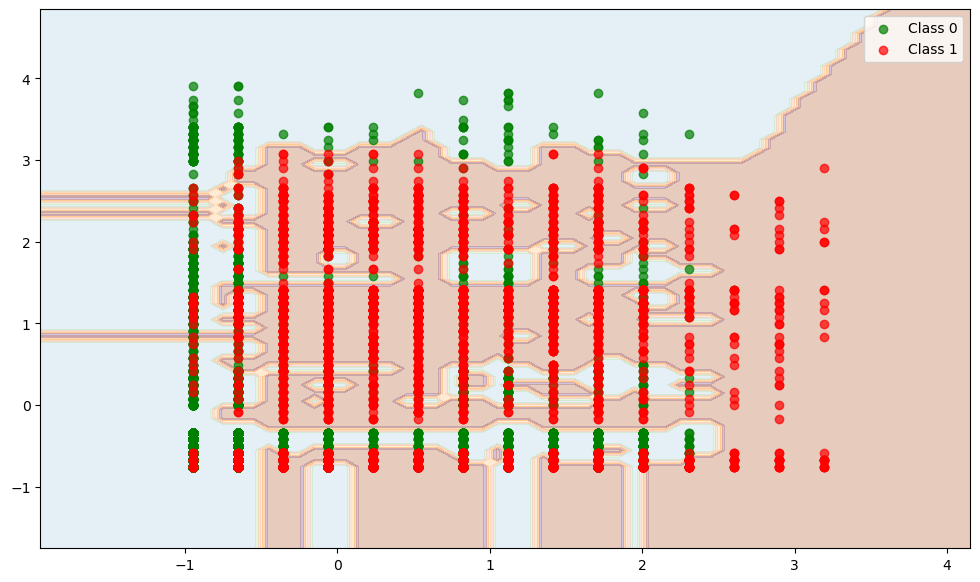

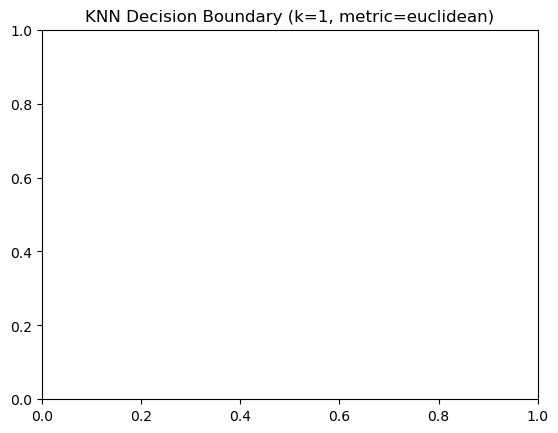

              precision    recall  f1-score   support

           0       0.91      0.86      0.88      3000
           1       0.75      0.82      0.78      1500

    accuracy                           0.85      4500
   macro avg       0.83      0.84      0.83      4500
weighted avg       0.85      0.85      0.85      4500



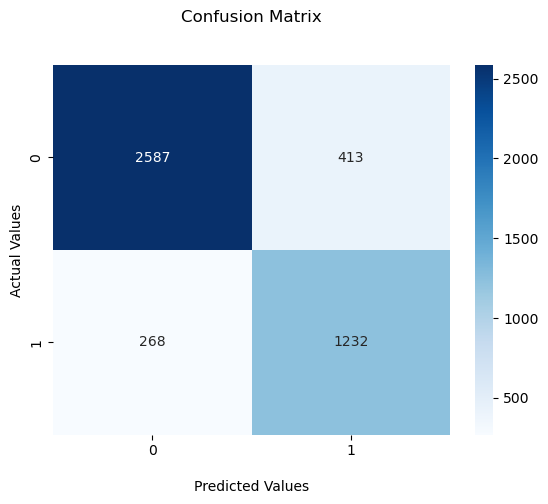

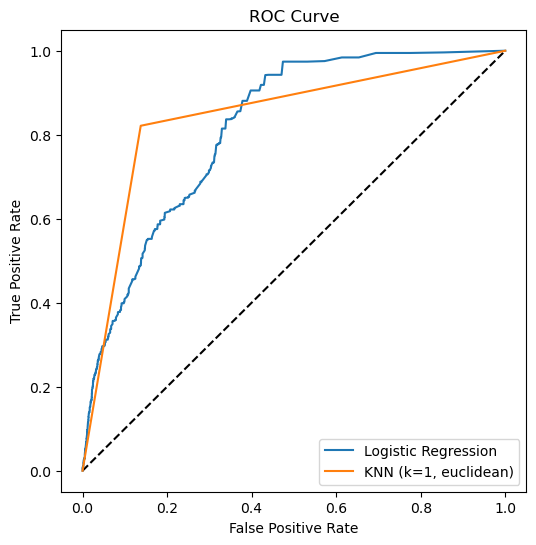


K = 3
Train F1 score: 0.8190
Test F1 score: 0.8008


<Figure size 1000x600 with 0 Axes>

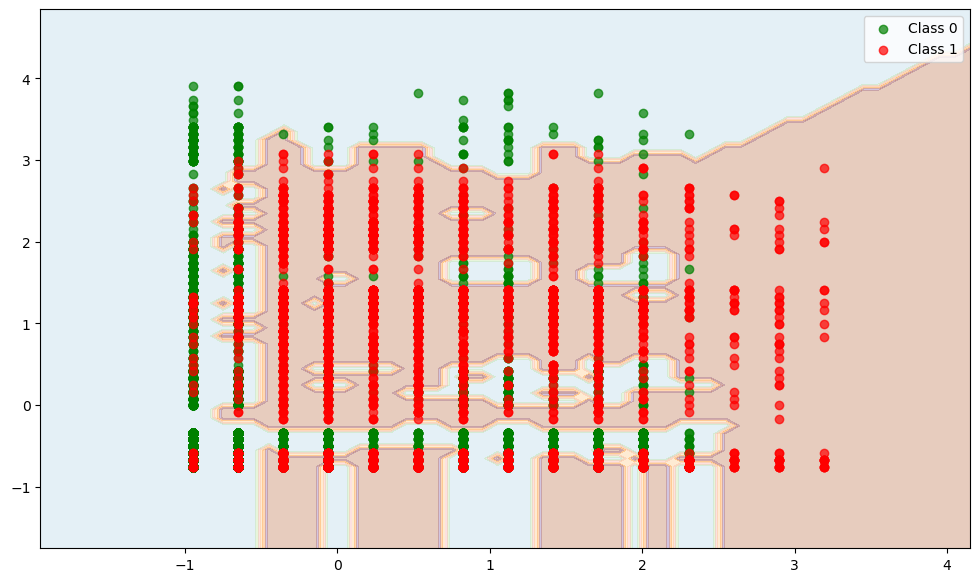

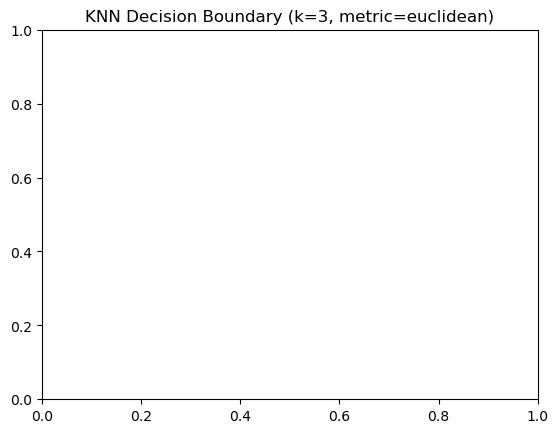

              precision    recall  f1-score   support

           0       0.91      0.89      0.90      3000
           1       0.78      0.82      0.80      1500

    accuracy                           0.86      4500
   macro avg       0.85      0.85      0.85      4500
weighted avg       0.87      0.86      0.86      4500



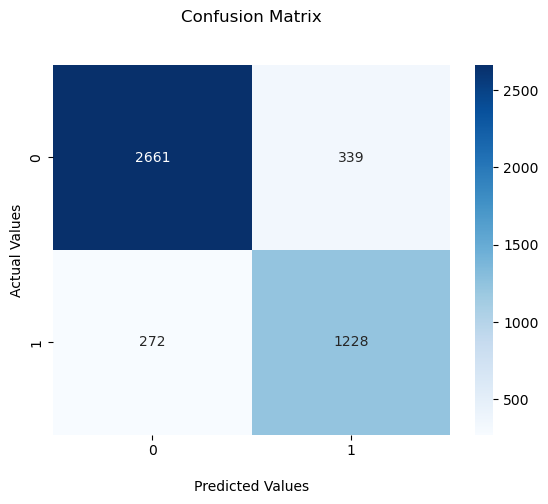

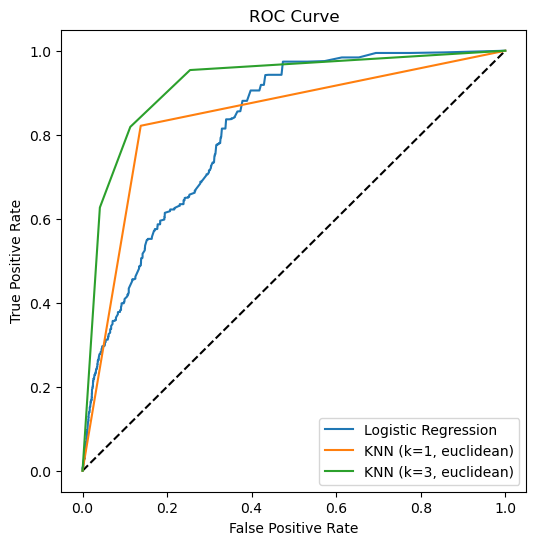


K = 5
Train F1 score: 0.8129
Test F1 score: 0.8009


<Figure size 1000x600 with 0 Axes>

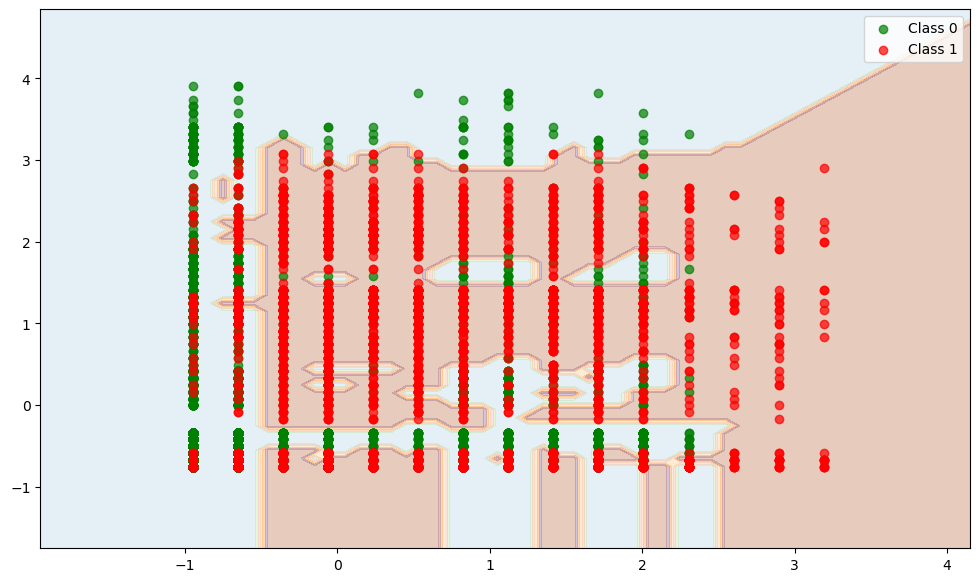

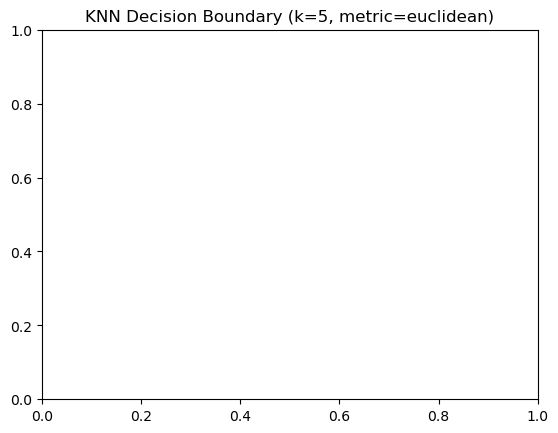

              precision    recall  f1-score   support

           0       0.90      0.91      0.90      3000
           1       0.81      0.79      0.80      1500

    accuracy                           0.87      4500
   macro avg       0.85      0.85      0.85      4500
weighted avg       0.87      0.87      0.87      4500



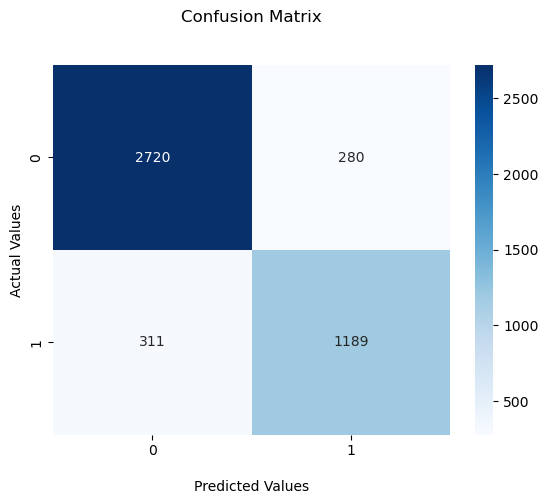

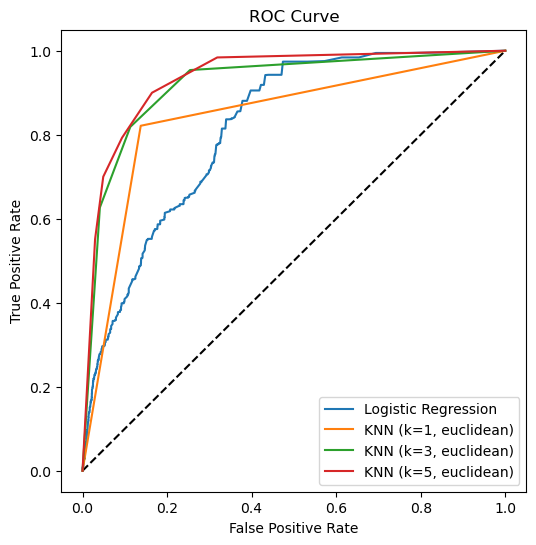


K = 10
Train F1 score: 0.8190
Test F1 score: 0.8082


<Figure size 1000x600 with 0 Axes>

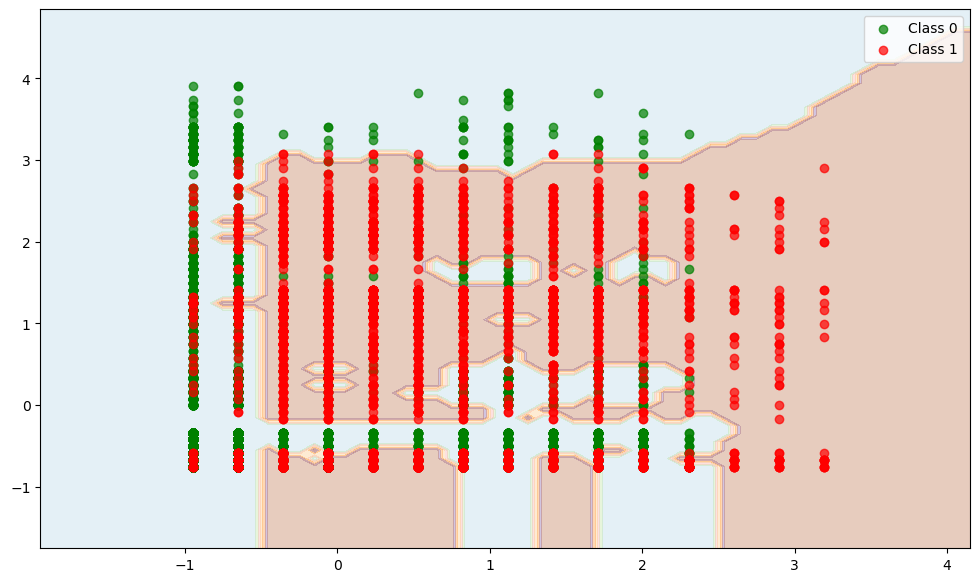

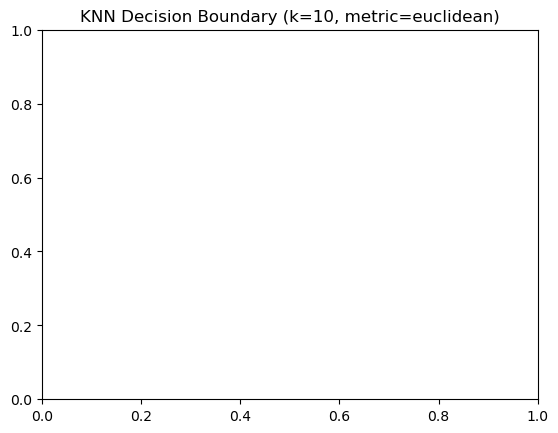

              precision    recall  f1-score   support

           0       0.90      0.91      0.91      3000
           1       0.81      0.80      0.81      1500

    accuracy                           0.87      4500
   macro avg       0.86      0.86      0.86      4500
weighted avg       0.87      0.87      0.87      4500



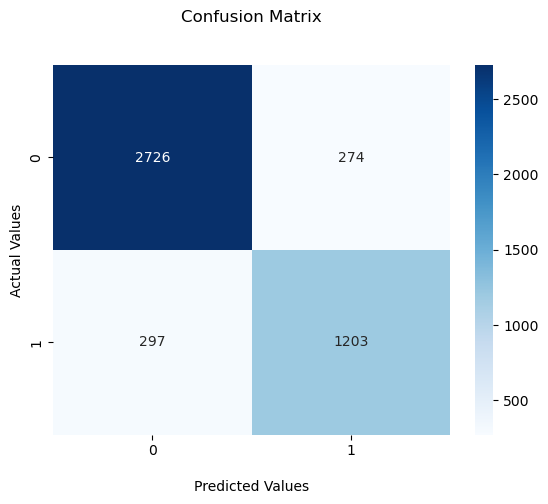

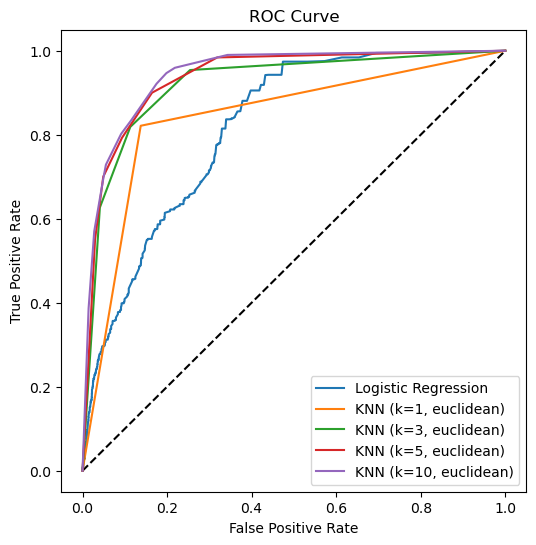


K = 20
Train F1 score: 0.8222
Test F1 score: 0.8092


<Figure size 1000x600 with 0 Axes>

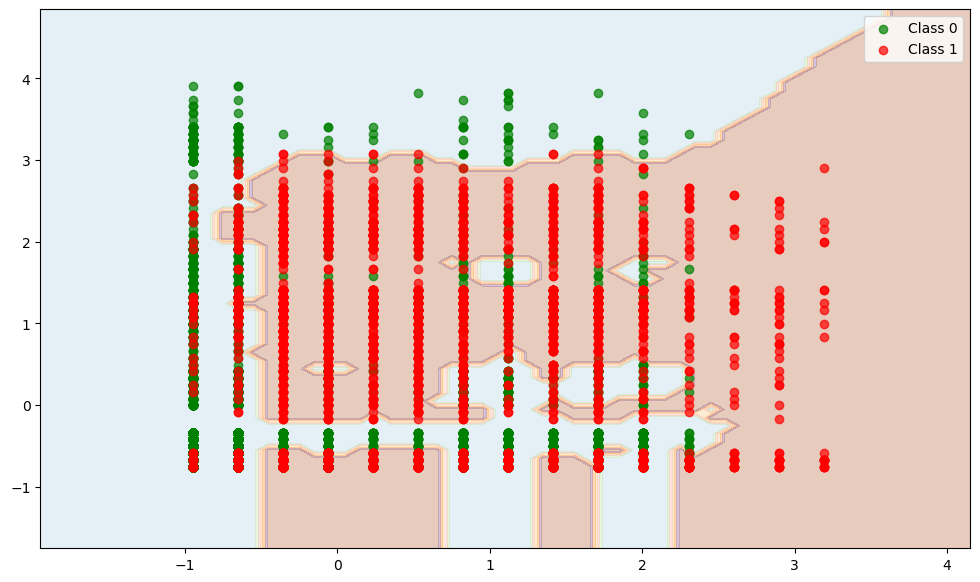

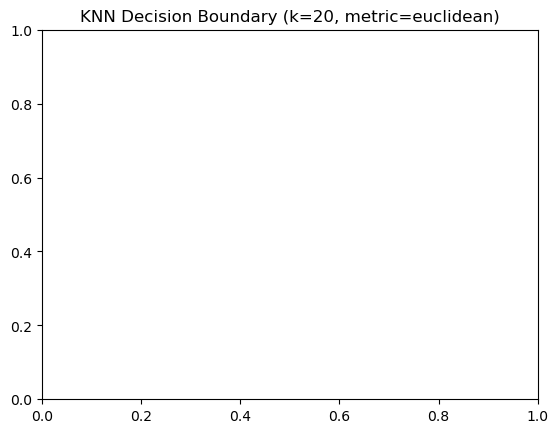

              precision    recall  f1-score   support

           0       0.90      0.92      0.91      3000
           1       0.83      0.79      0.81      1500

    accuracy                           0.88      4500
   macro avg       0.86      0.85      0.86      4500
weighted avg       0.87      0.88      0.87      4500



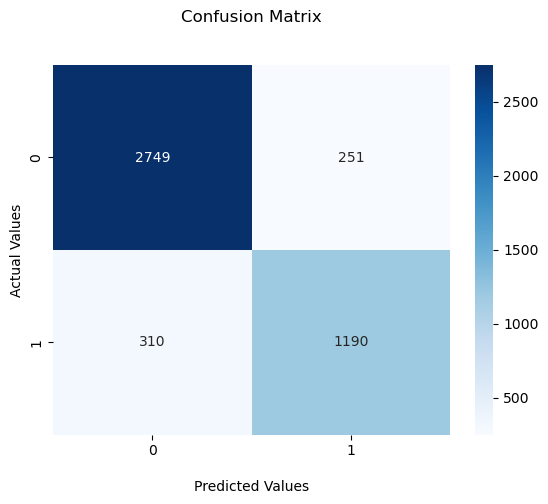

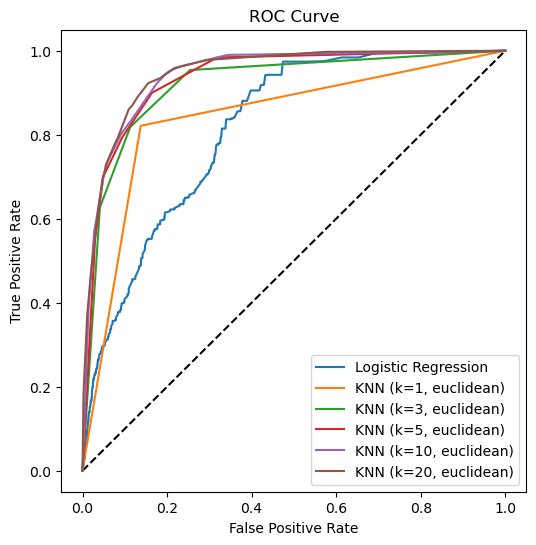


K = 50
Train F1 score: 0.8244
Test F1 score: 0.8189


<Figure size 1000x600 with 0 Axes>

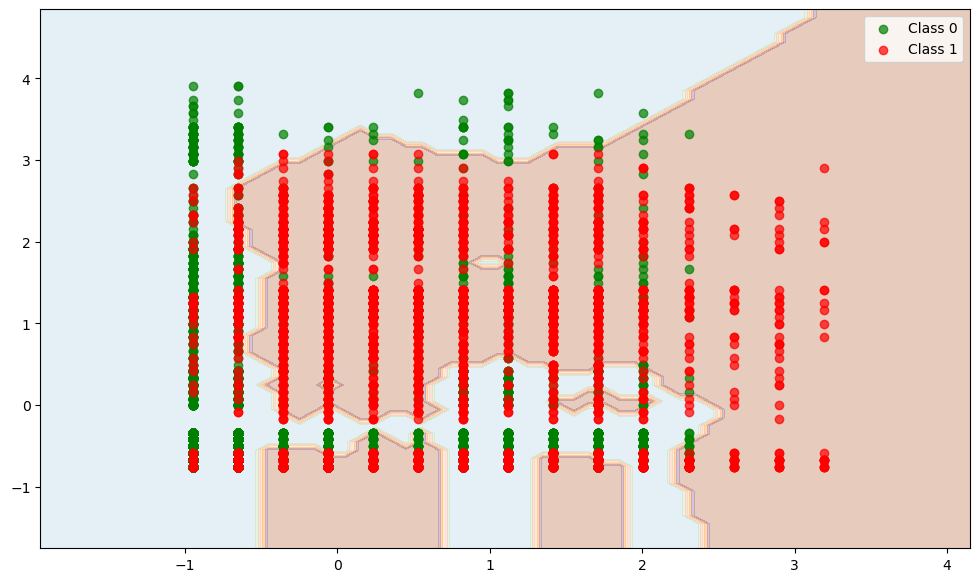

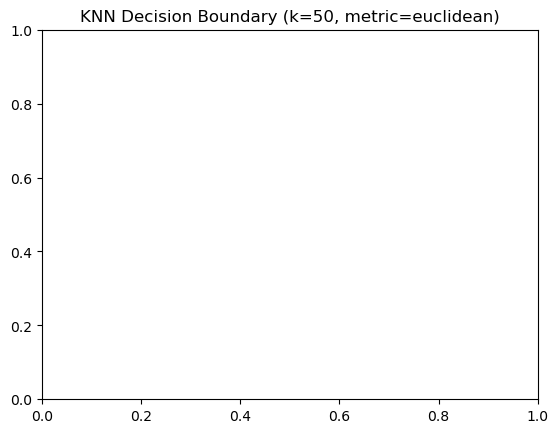

              precision    recall  f1-score   support

           0       0.92      0.89      0.90      3000
           1       0.79      0.85      0.82      1500

    accuracy                           0.87      4500
   macro avg       0.86      0.87      0.86      4500
weighted avg       0.88      0.87      0.88      4500



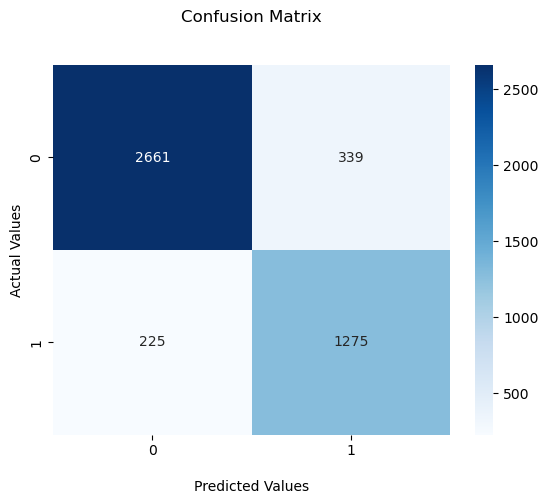

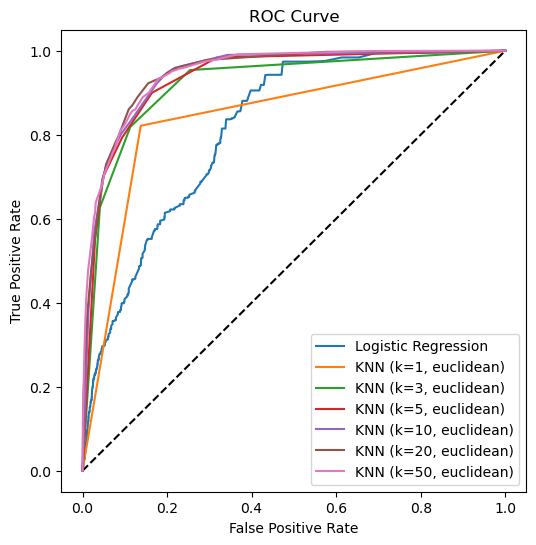


K = 100
Train F1 score: 0.8136
Test F1 score: 0.8077


<Figure size 1000x600 with 0 Axes>

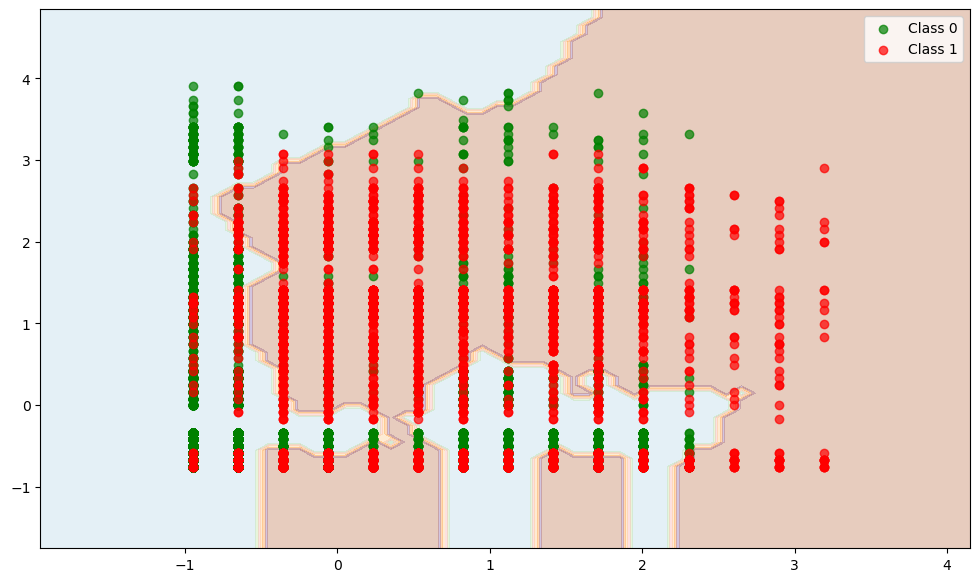

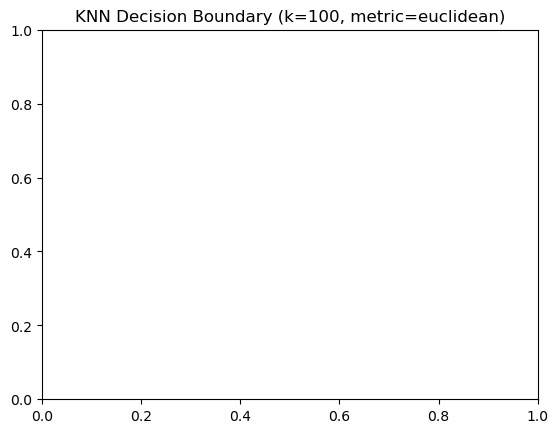

              precision    recall  f1-score   support

           0       0.91      0.89      0.90      3000
           1       0.79      0.82      0.81      1500

    accuracy                           0.87      4500
   macro avg       0.85      0.86      0.85      4500
weighted avg       0.87      0.87      0.87      4500



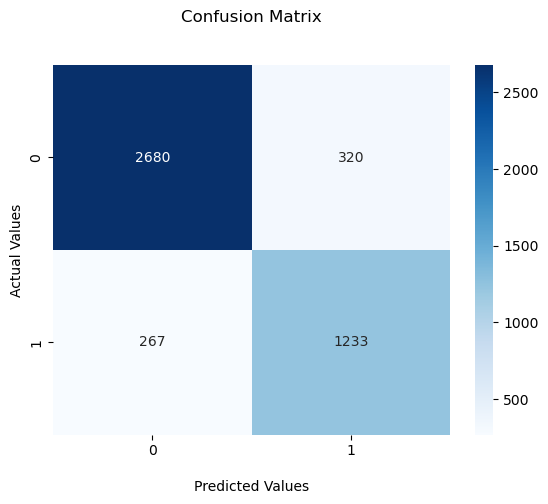

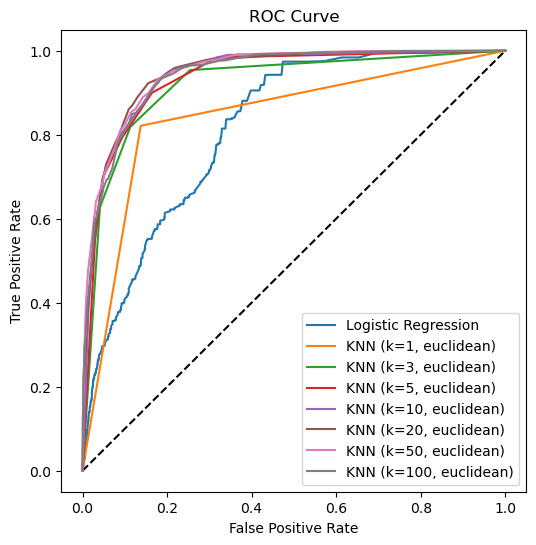


Testing KNN with metric: manhattan

K = 1
Train F1 score: 0.8021
Test F1 score: 0.7835


<Figure size 1000x600 with 0 Axes>

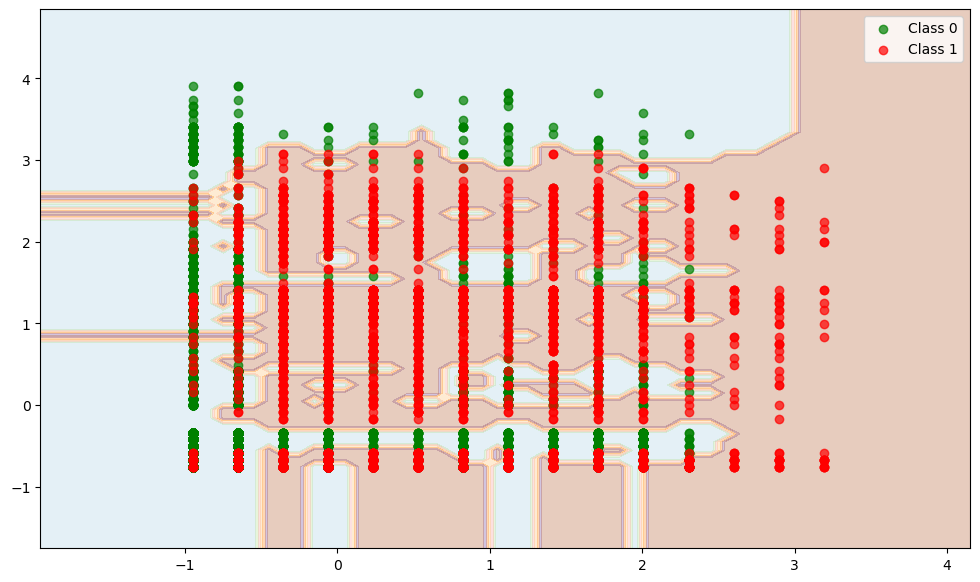

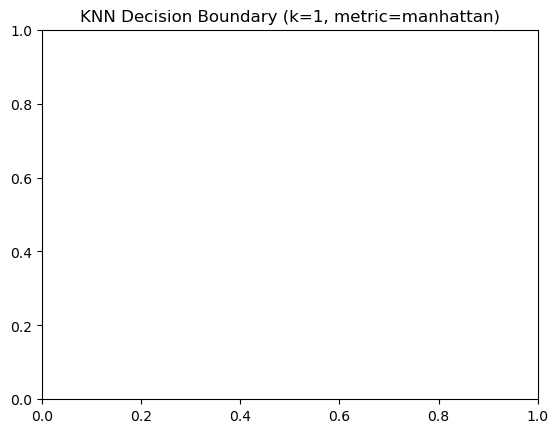

              precision    recall  f1-score   support

           0       0.91      0.86      0.88      3000
           1       0.75      0.82      0.78      1500

    accuracy                           0.85      4500
   macro avg       0.83      0.84      0.83      4500
weighted avg       0.85      0.85      0.85      4500



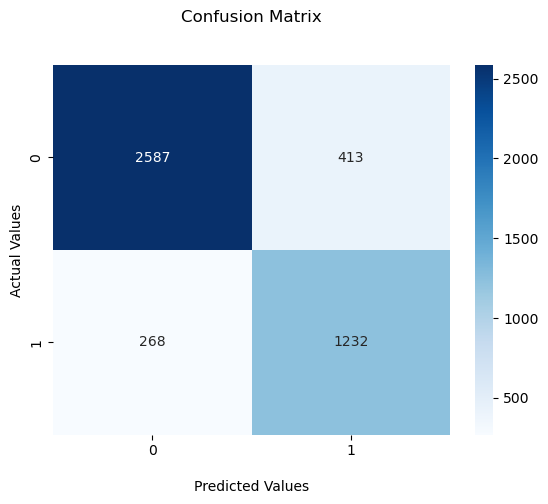

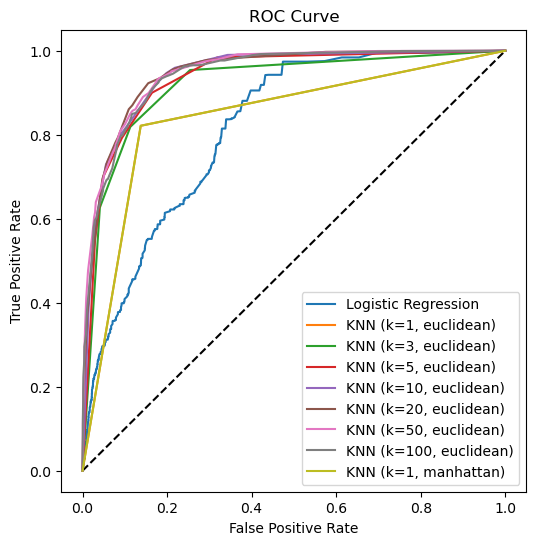


K = 3
Train F1 score: 0.8190
Test F1 score: 0.8008


<Figure size 1000x600 with 0 Axes>

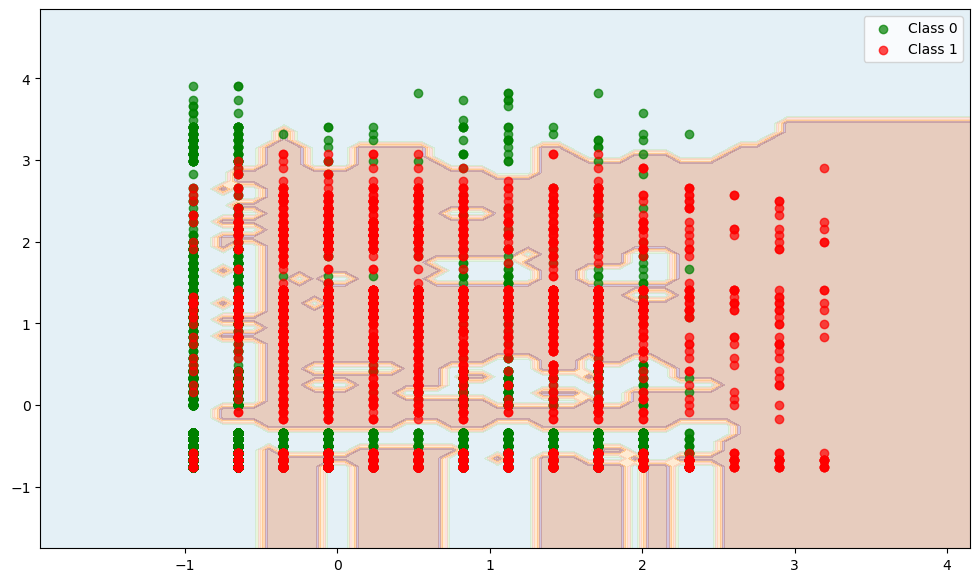

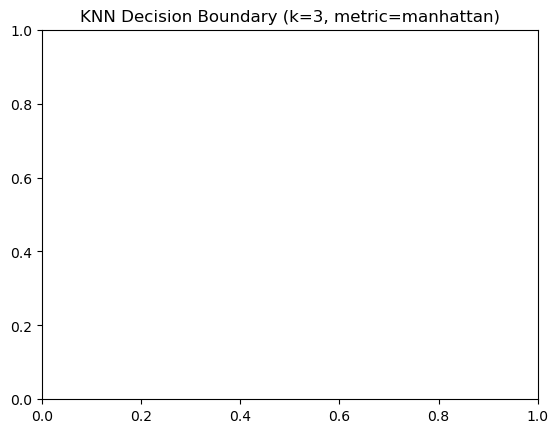

              precision    recall  f1-score   support

           0       0.91      0.89      0.90      3000
           1       0.78      0.82      0.80      1500

    accuracy                           0.86      4500
   macro avg       0.85      0.85      0.85      4500
weighted avg       0.87      0.86      0.86      4500



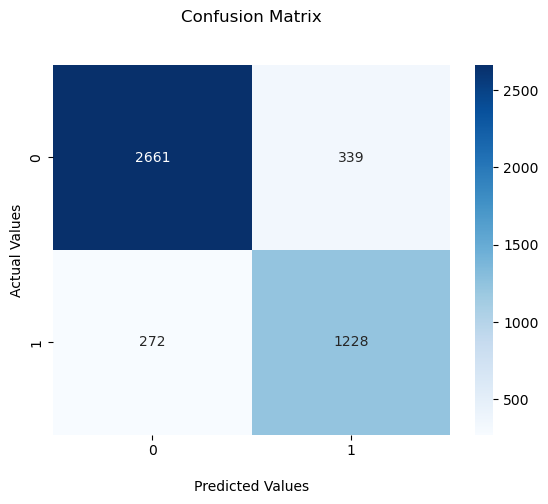

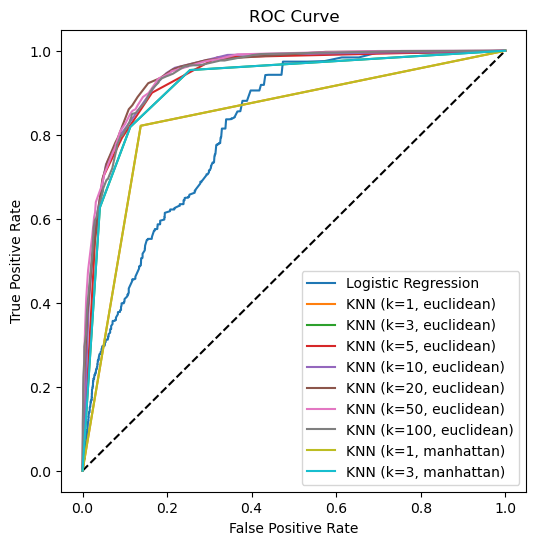


K = 5
Train F1 score: 0.8129
Test F1 score: 0.8009


<Figure size 1000x600 with 0 Axes>

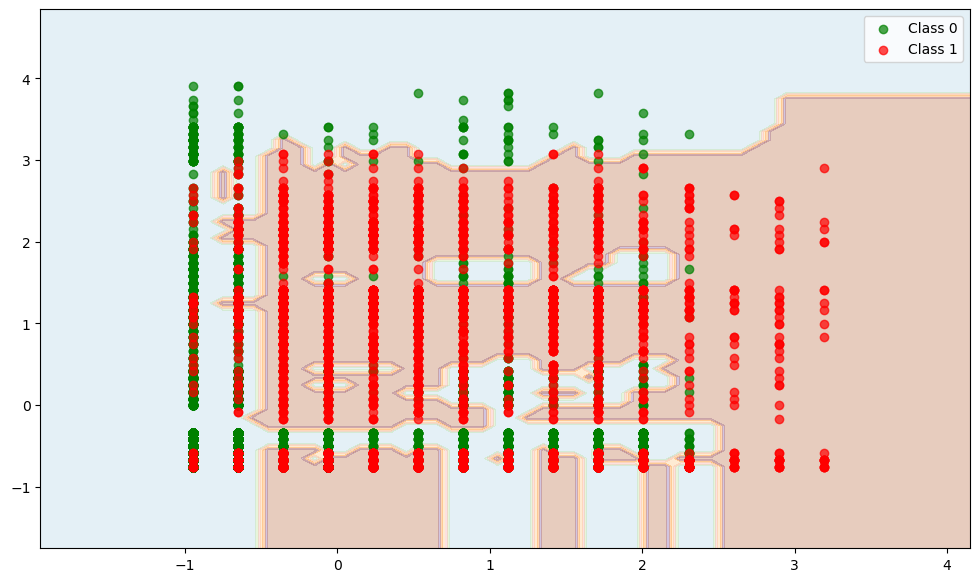

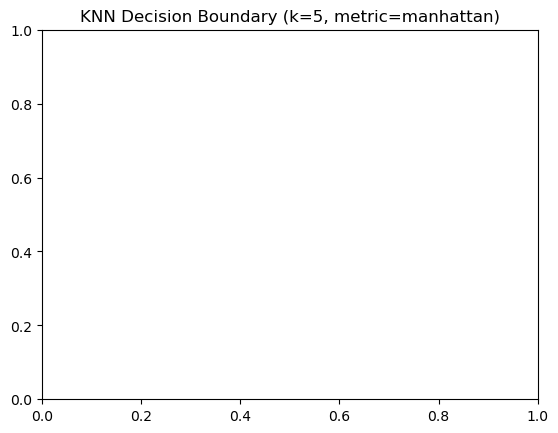

              precision    recall  f1-score   support

           0       0.90      0.91      0.90      3000
           1       0.81      0.79      0.80      1500

    accuracy                           0.87      4500
   macro avg       0.85      0.85      0.85      4500
weighted avg       0.87      0.87      0.87      4500



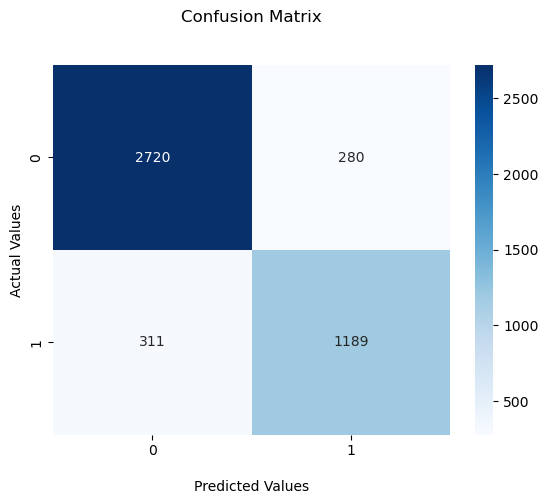

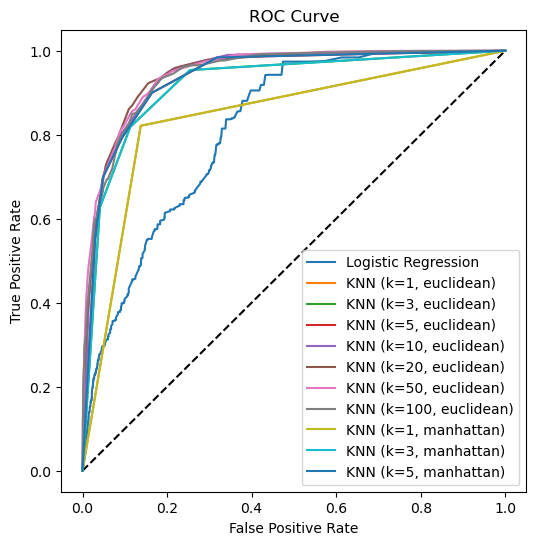


K = 10
Train F1 score: 0.8196
Test F1 score: 0.8093


<Figure size 1000x600 with 0 Axes>

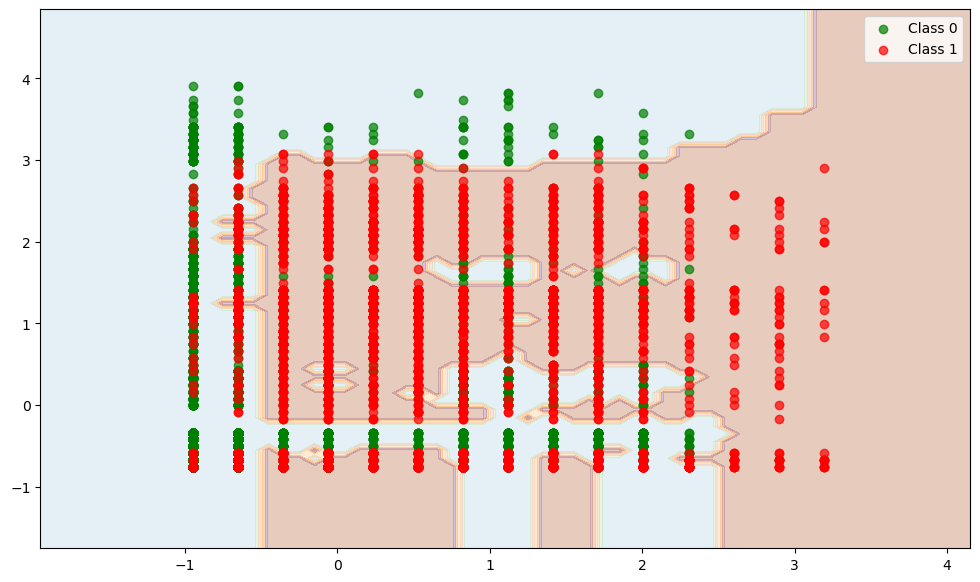

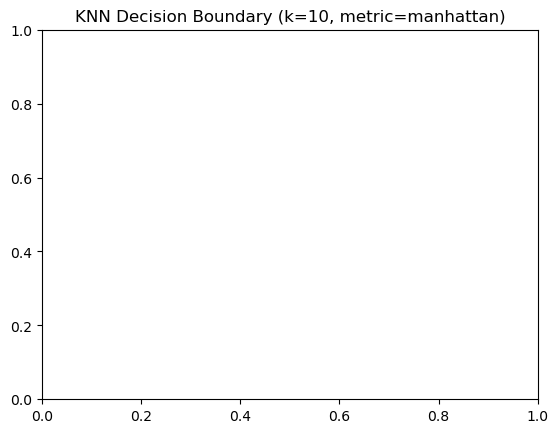

              precision    recall  f1-score   support

           0       0.90      0.91      0.91      3000
           1       0.82      0.80      0.81      1500

    accuracy                           0.87      4500
   macro avg       0.86      0.86      0.86      4500
weighted avg       0.87      0.87      0.87      4500



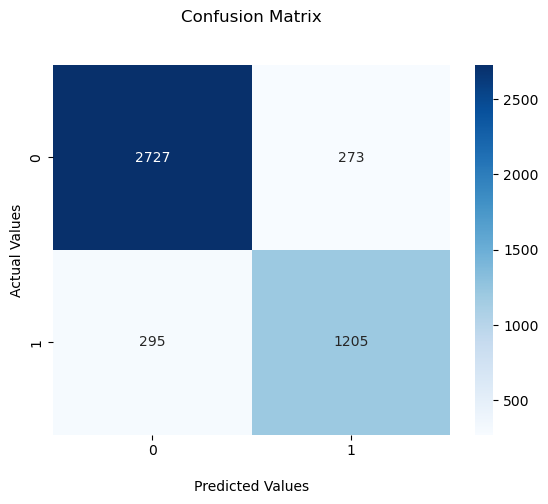

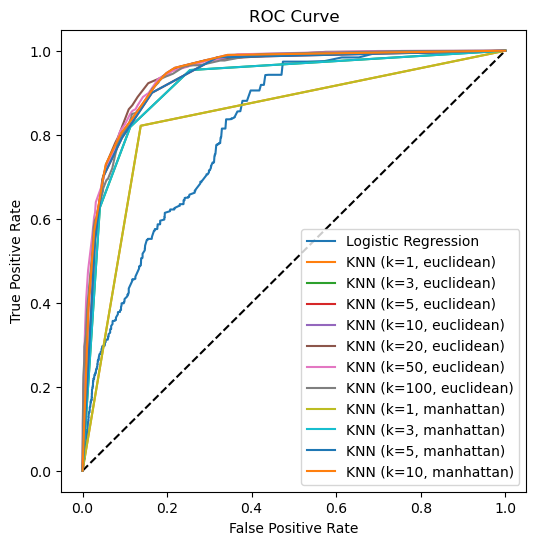


K = 20
Train F1 score: 0.8229
Test F1 score: 0.8081


<Figure size 1000x600 with 0 Axes>

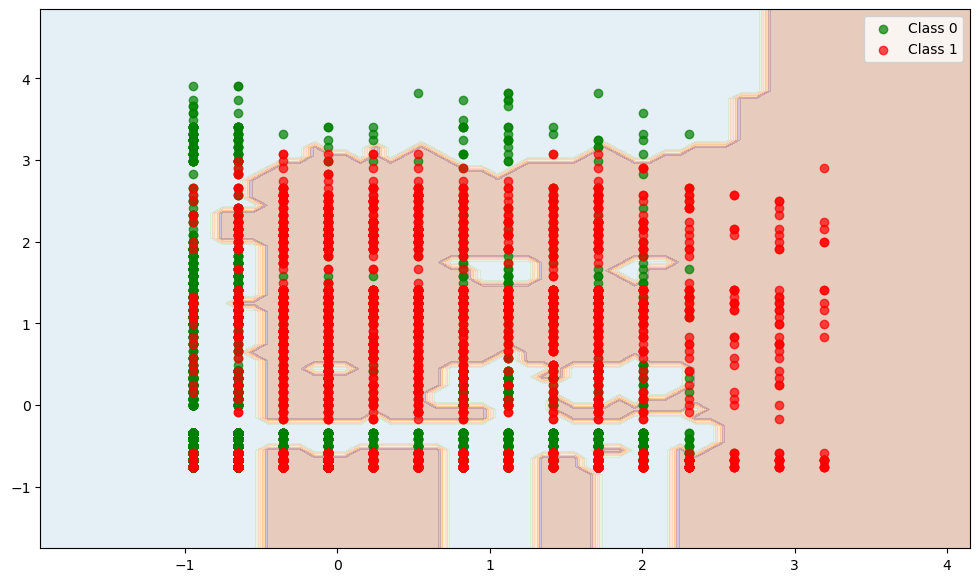

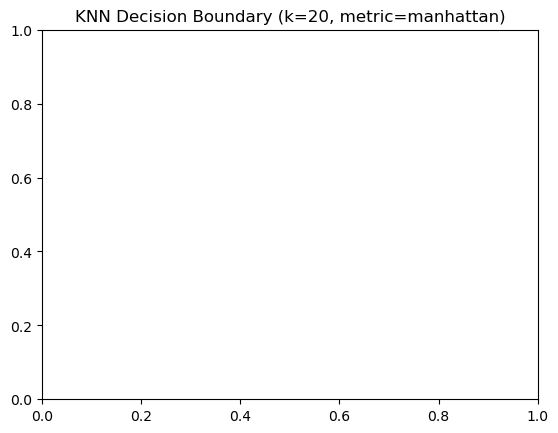

              precision    recall  f1-score   support

           0       0.90      0.92      0.91      3000
           1       0.82      0.79      0.81      1500

    accuracy                           0.87      4500
   macro avg       0.86      0.85      0.86      4500
weighted avg       0.87      0.87      0.87      4500



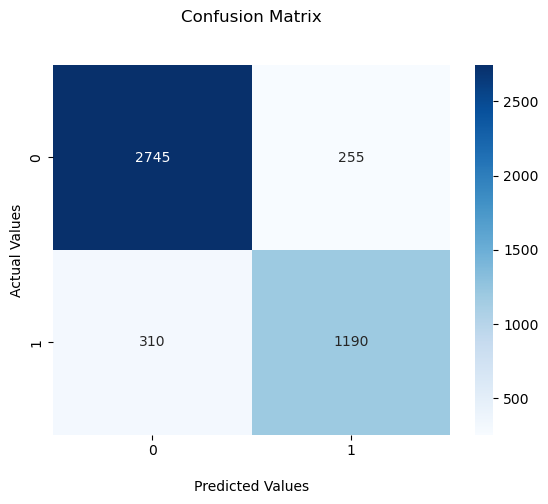

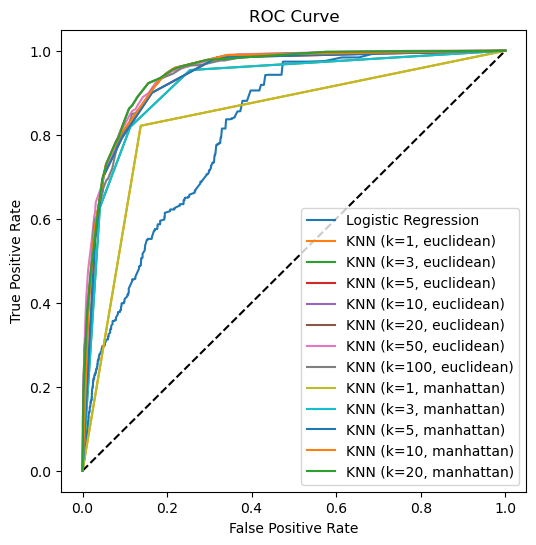


K = 50
Train F1 score: 0.8246
Test F1 score: 0.8207


<Figure size 1000x600 with 0 Axes>

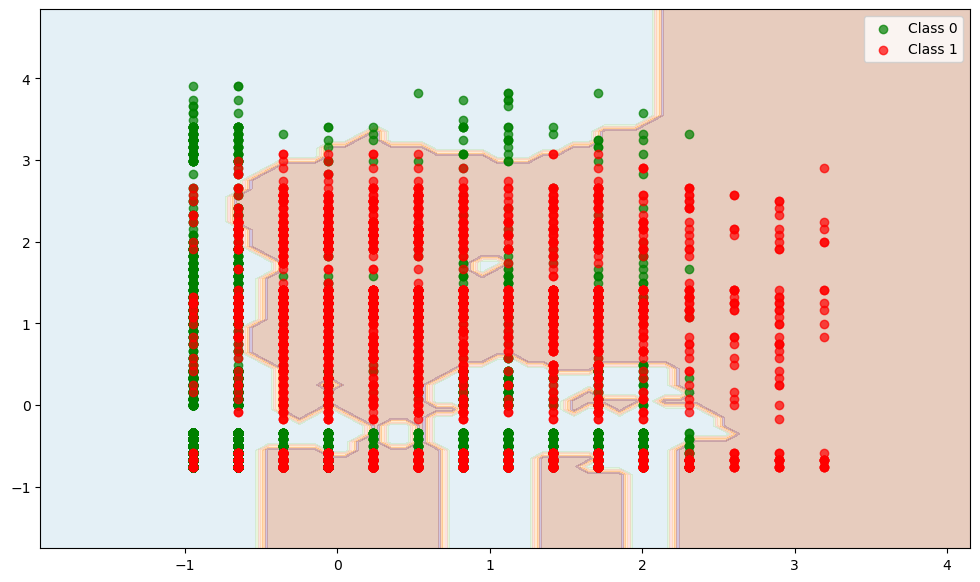

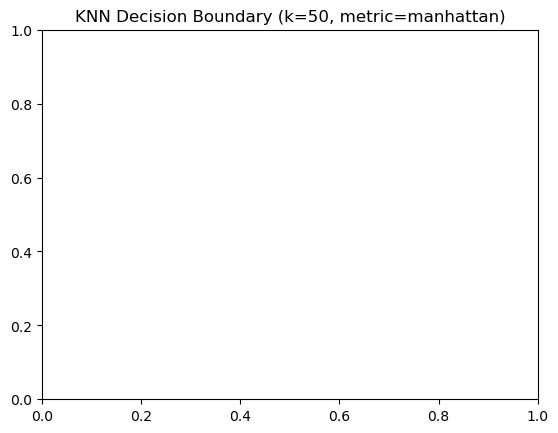

              precision    recall  f1-score   support

           0       0.92      0.89      0.91      3000
           1       0.79      0.85      0.82      1500

    accuracy                           0.88      4500
   macro avg       0.86      0.87      0.86      4500
weighted avg       0.88      0.88      0.88      4500



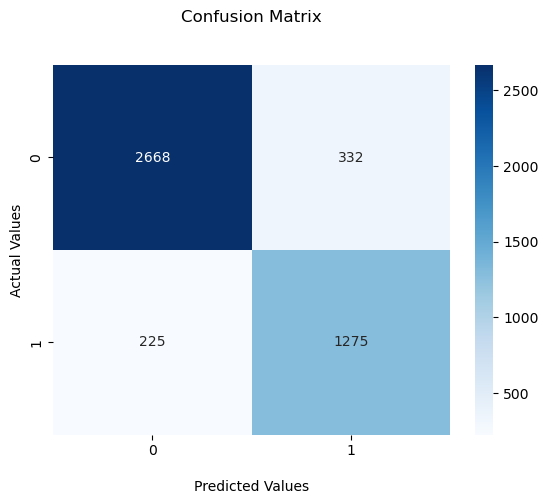

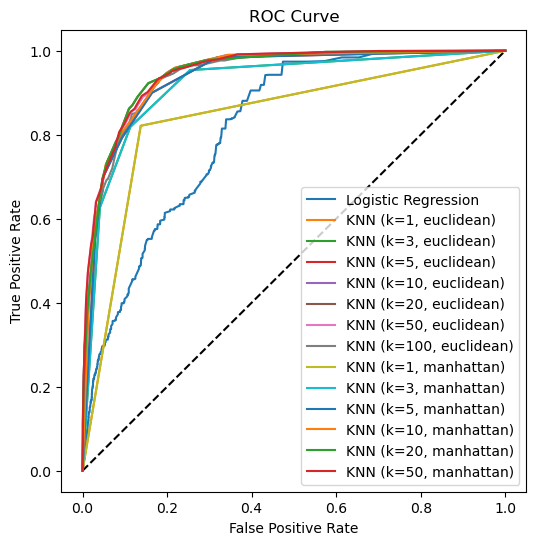


K = 100
Train F1 score: 0.8147
Test F1 score: 0.8110


<Figure size 1000x600 with 0 Axes>

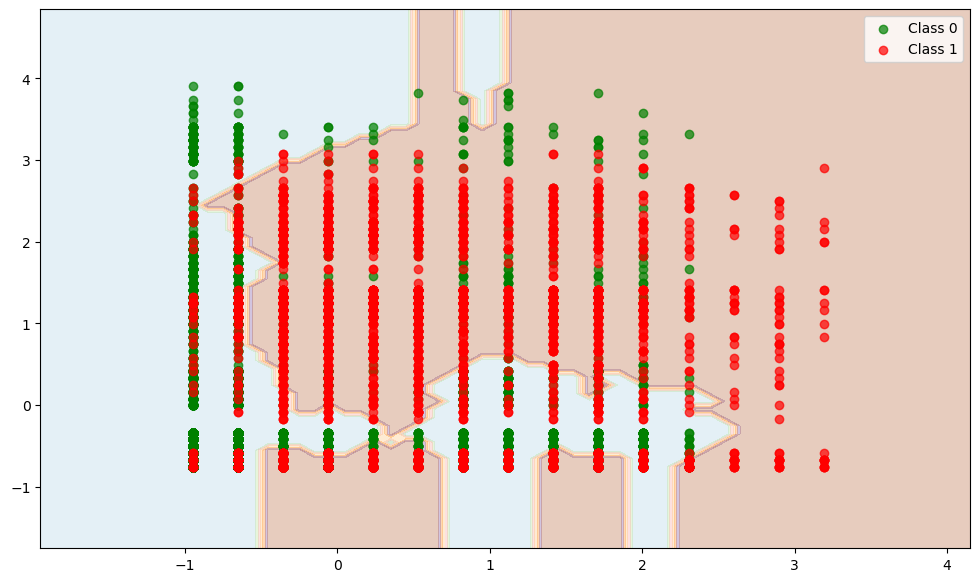

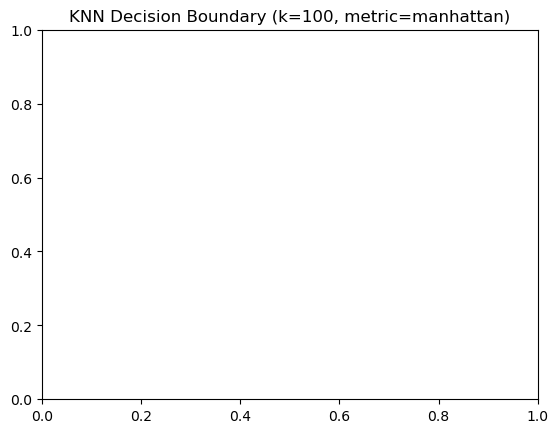

              precision    recall  f1-score   support

           0       0.91      0.89      0.90      3000
           1       0.80      0.83      0.81      1500

    accuracy                           0.87      4500
   macro avg       0.85      0.86      0.86      4500
weighted avg       0.87      0.87      0.87      4500



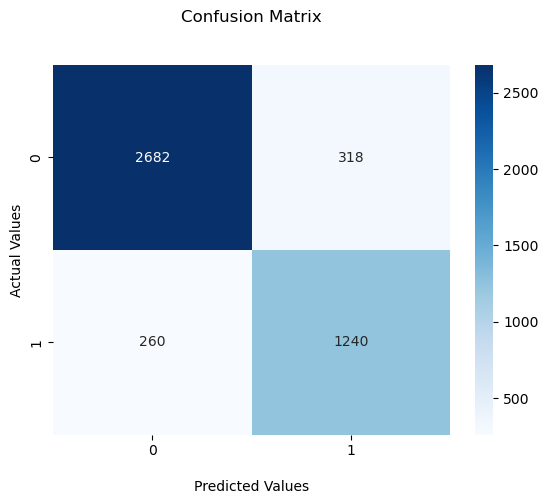

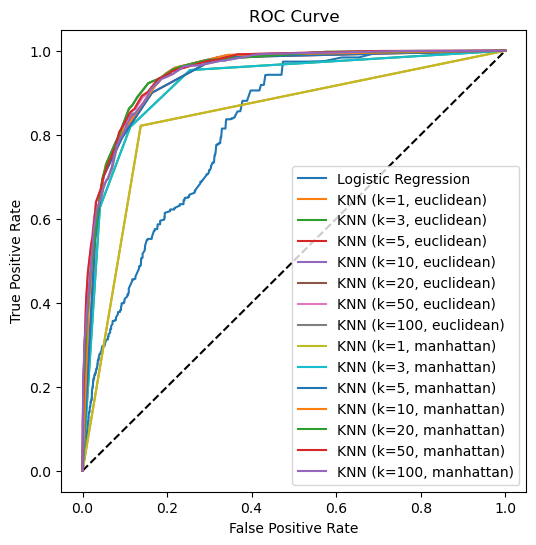


Testing KNN with metric: chebyshev

K = 1
Train F1 score: 0.8021
Test F1 score: 0.7835


<Figure size 1000x600 with 0 Axes>

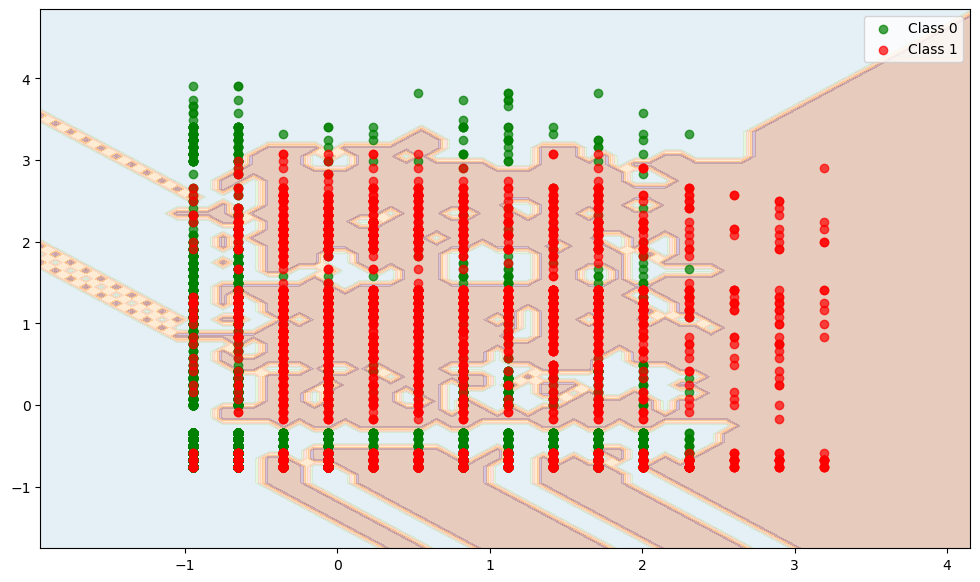

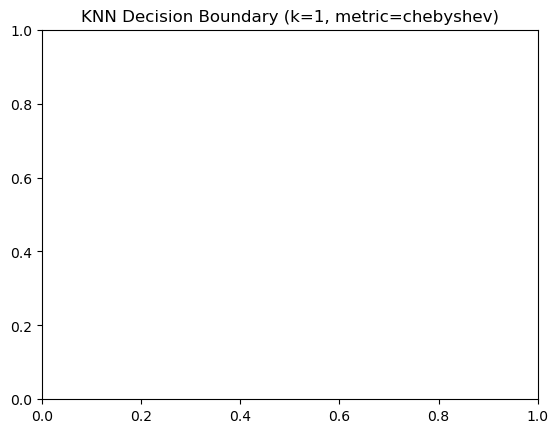

              precision    recall  f1-score   support

           0       0.91      0.86      0.88      3000
           1       0.75      0.82      0.78      1500

    accuracy                           0.85      4500
   macro avg       0.83      0.84      0.83      4500
weighted avg       0.85      0.85      0.85      4500



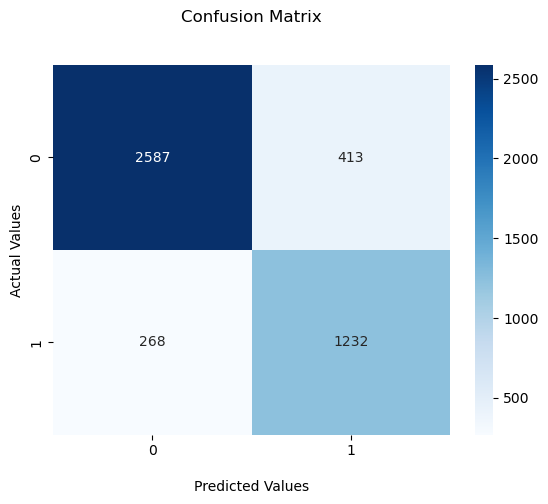

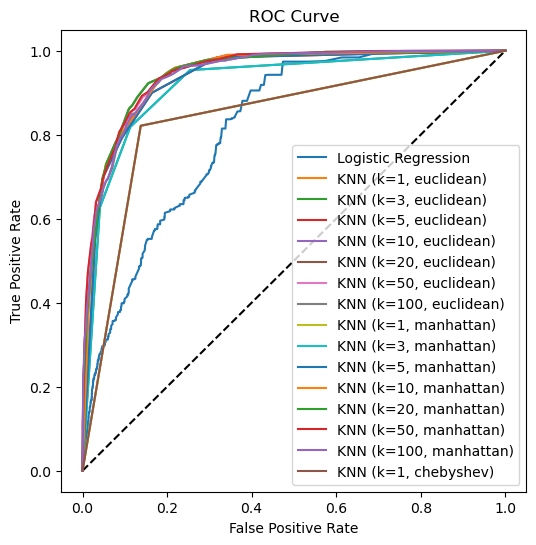


K = 3
Train F1 score: 0.8190
Test F1 score: 0.8008


<Figure size 1000x600 with 0 Axes>

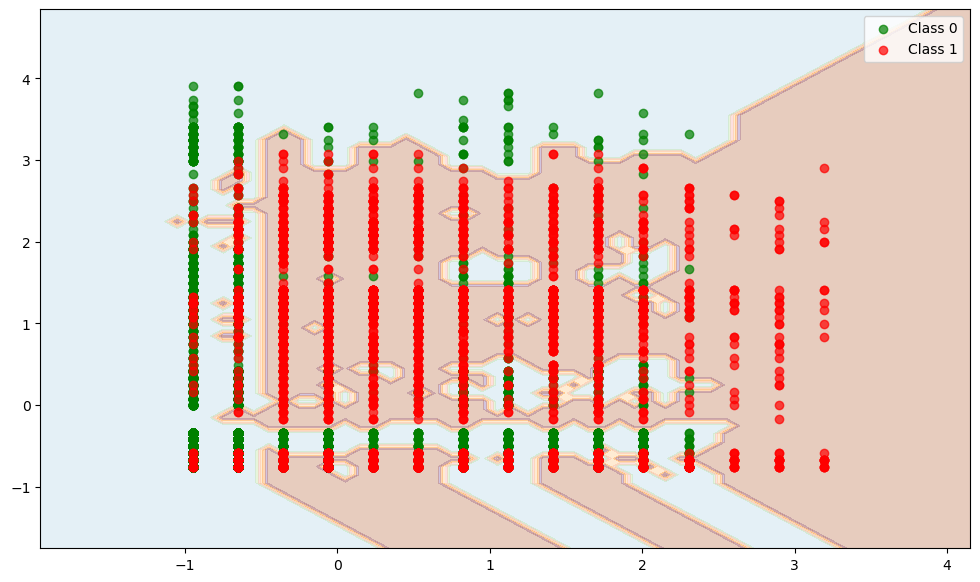

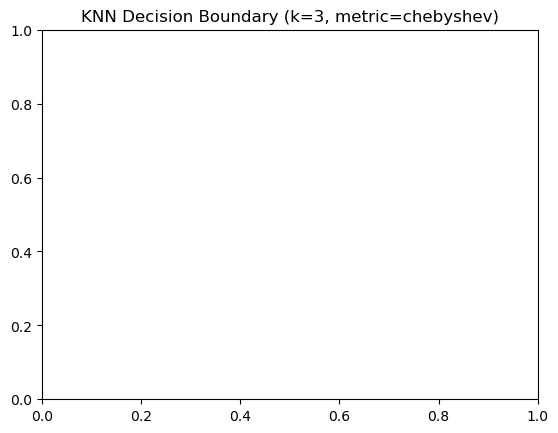

              precision    recall  f1-score   support

           0       0.91      0.89      0.90      3000
           1       0.78      0.82      0.80      1500

    accuracy                           0.86      4500
   macro avg       0.85      0.85      0.85      4500
weighted avg       0.87      0.86      0.86      4500



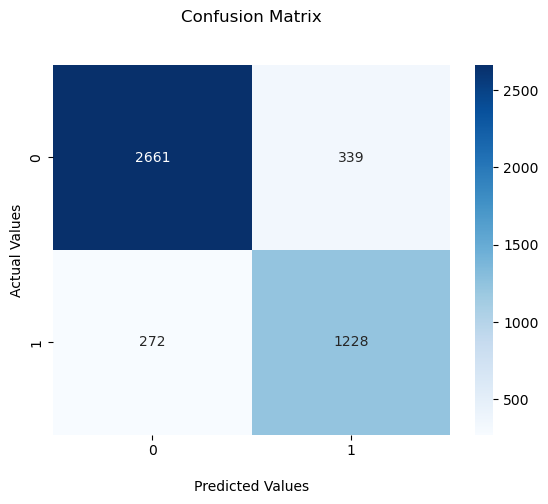

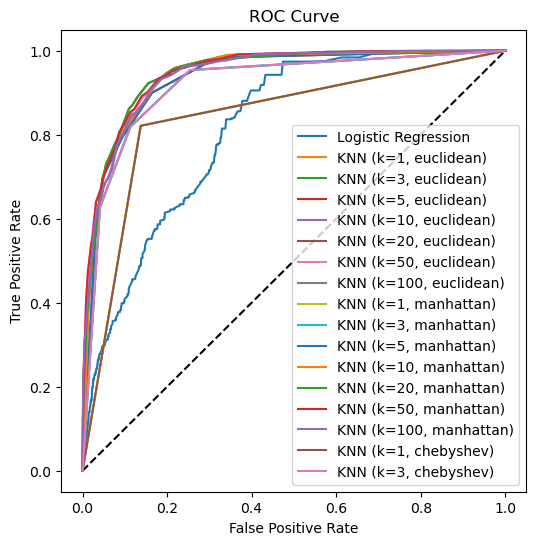


K = 5
Train F1 score: 0.8127
Test F1 score: 0.8007


<Figure size 1000x600 with 0 Axes>

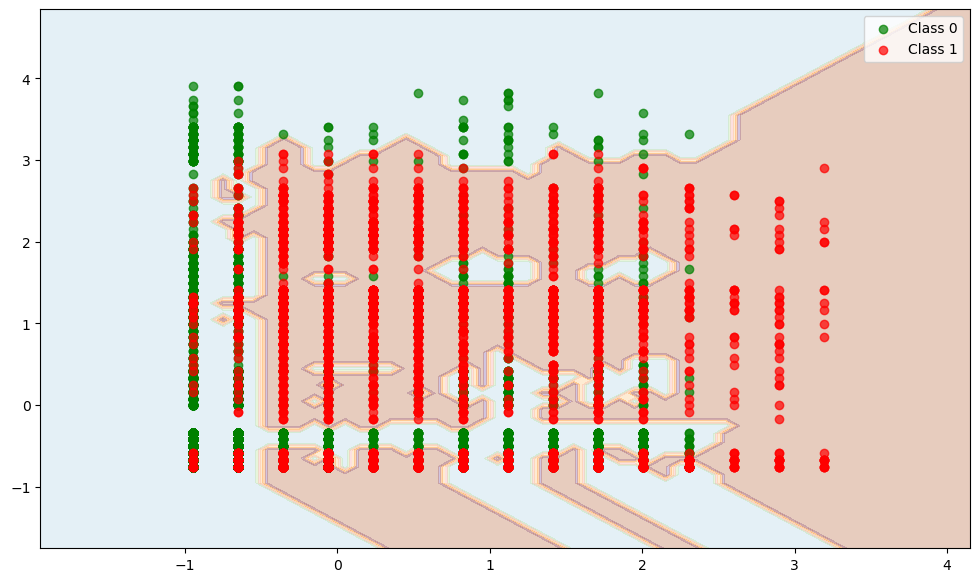

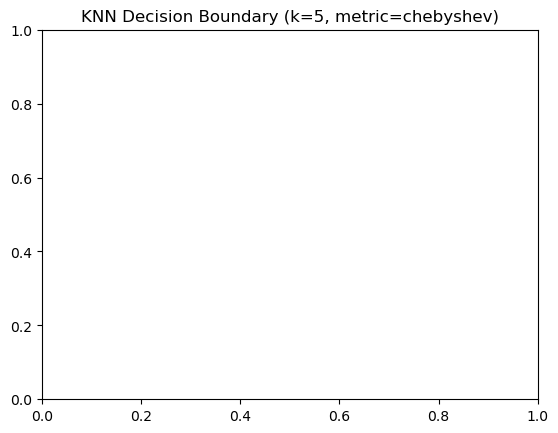

              precision    recall  f1-score   support

           0       0.90      0.91      0.90      3000
           1       0.81      0.79      0.80      1500

    accuracy                           0.87      4500
   macro avg       0.85      0.85      0.85      4500
weighted avg       0.87      0.87      0.87      4500



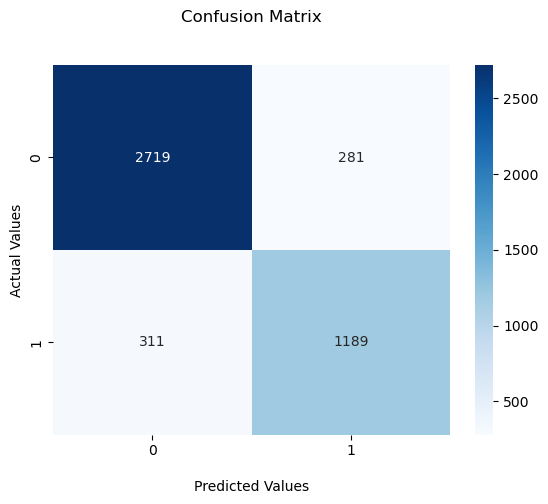

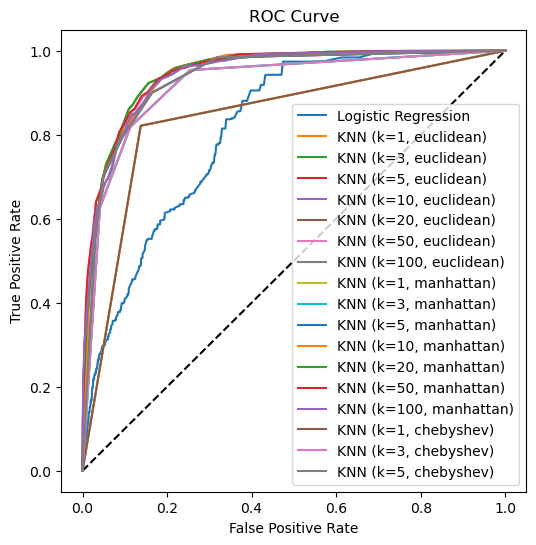


K = 10
Train F1 score: 0.8183
Test F1 score: 0.8074


<Figure size 1000x600 with 0 Axes>

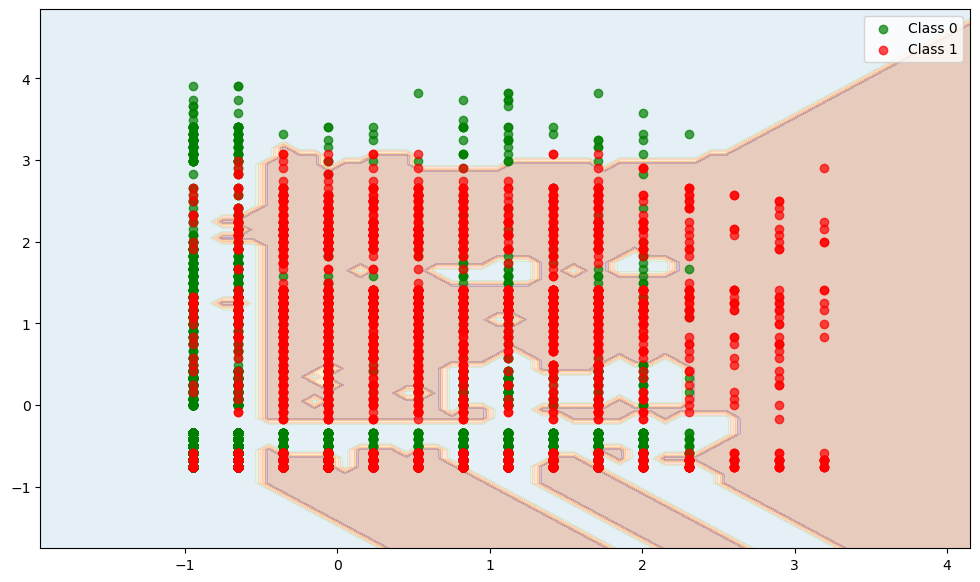

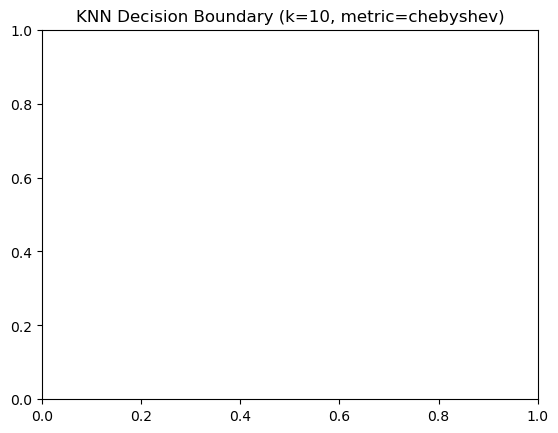

              precision    recall  f1-score   support

           0       0.90      0.91      0.90      3000
           1       0.81      0.80      0.81      1500

    accuracy                           0.87      4500
   macro avg       0.86      0.85      0.86      4500
weighted avg       0.87      0.87      0.87      4500



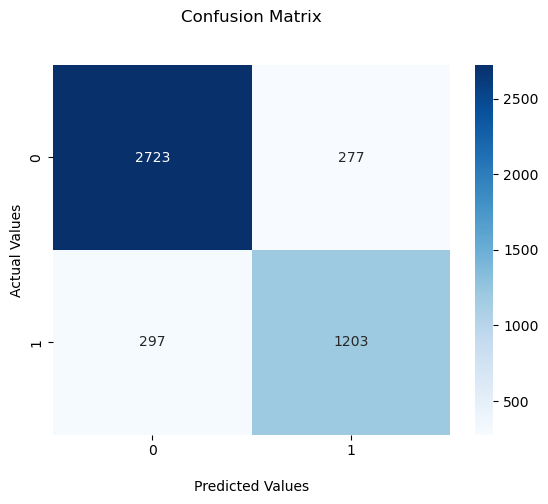

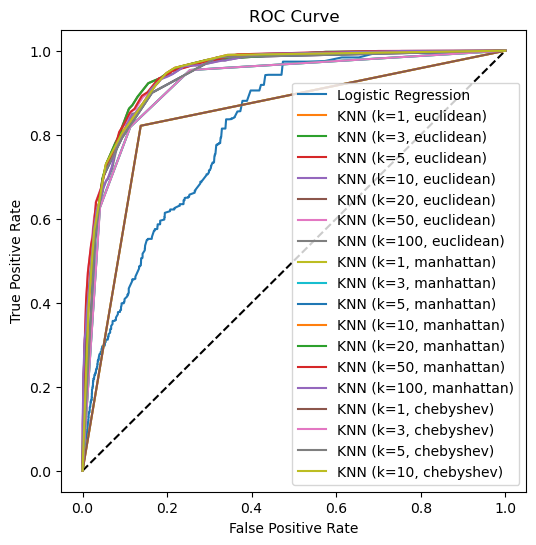


K = 20
Train F1 score: 0.8222
Test F1 score: 0.8091


<Figure size 1000x600 with 0 Axes>

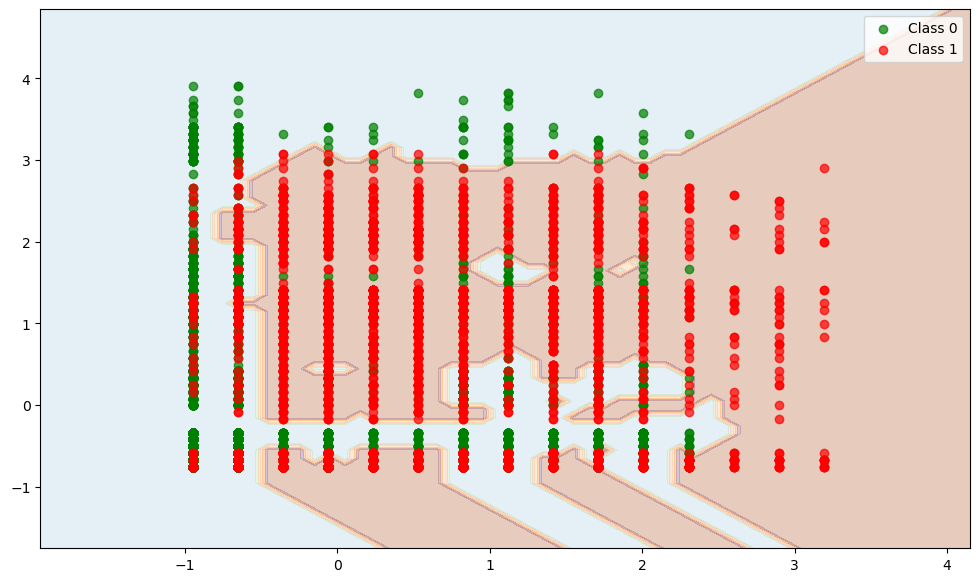

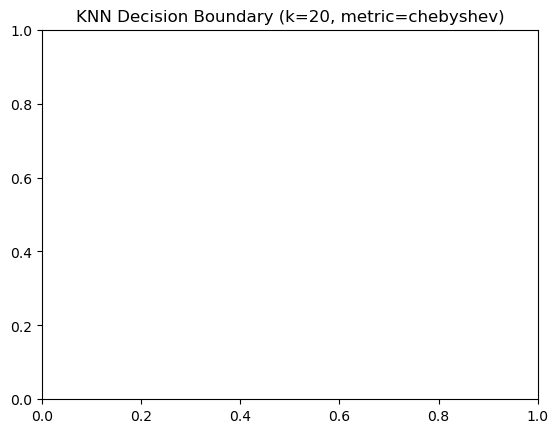

              precision    recall  f1-score   support

           0       0.90      0.92      0.91      3000
           1       0.83      0.79      0.81      1500

    accuracy                           0.88      4500
   macro avg       0.86      0.85      0.86      4500
weighted avg       0.87      0.88      0.87      4500



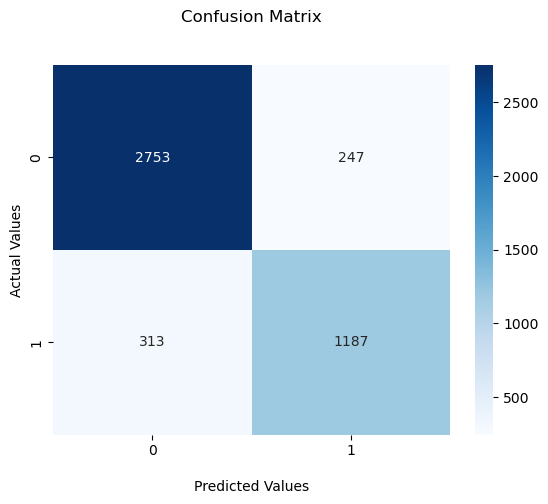

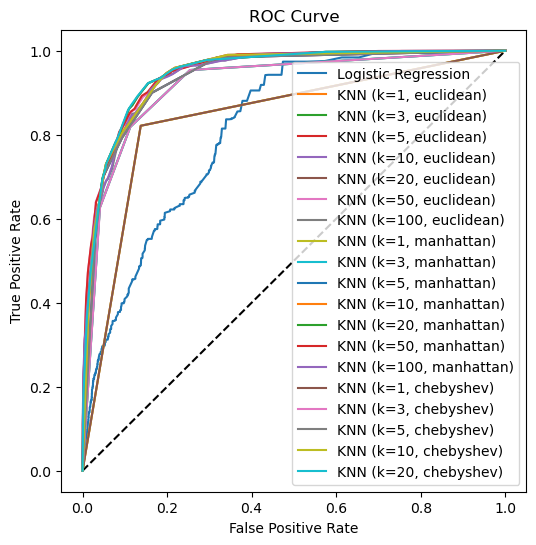


K = 50
Train F1 score: 0.8220
Test F1 score: 0.8144


<Figure size 1000x600 with 0 Axes>

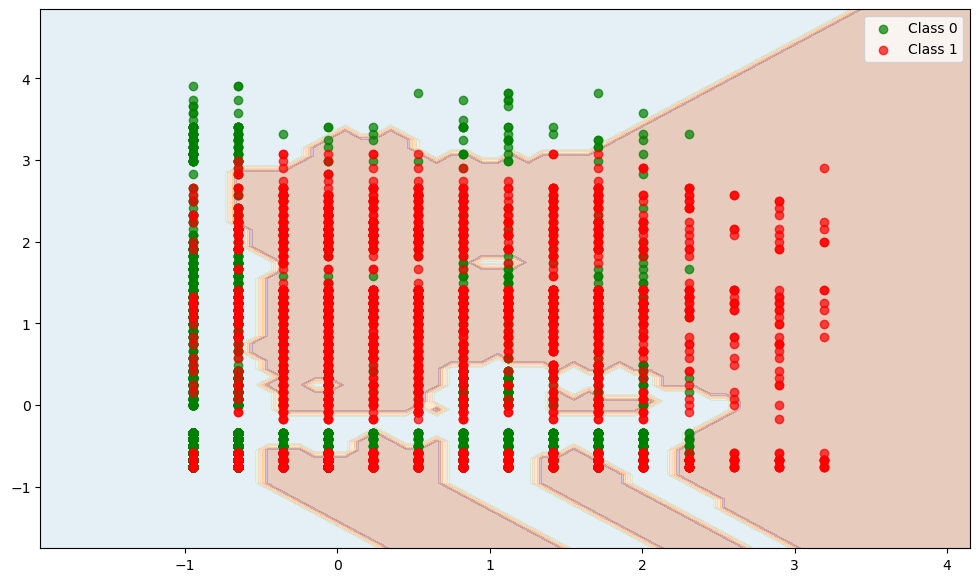

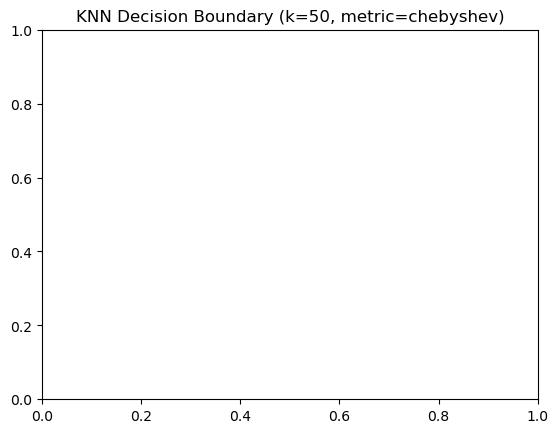

              precision    recall  f1-score   support

           0       0.92      0.89      0.90      3000
           1       0.79      0.84      0.81      1500

    accuracy                           0.87      4500
   macro avg       0.85      0.86      0.86      4500
weighted avg       0.88      0.87      0.87      4500



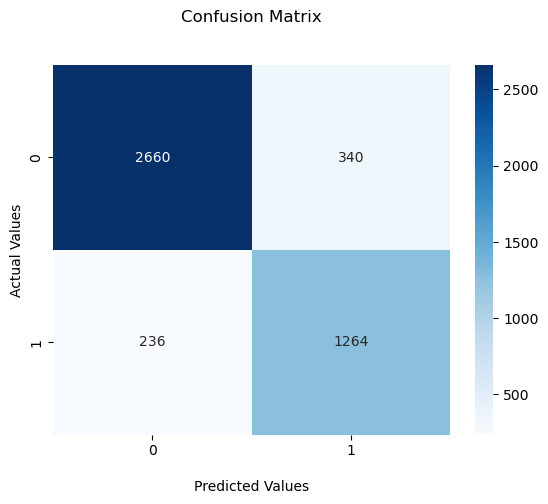

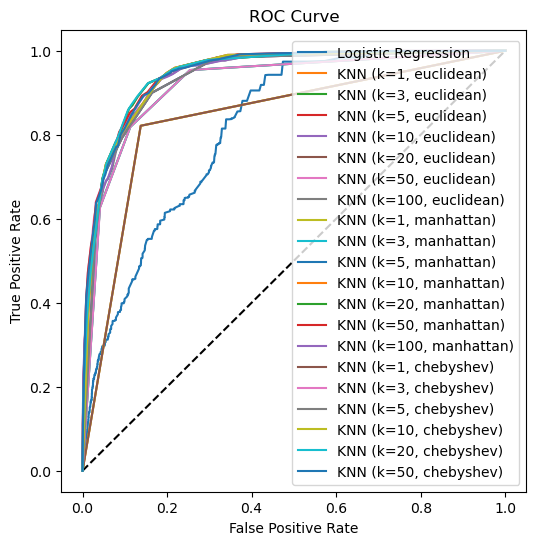


K = 100
Train F1 score: 0.8121
Test F1 score: 0.8094


<Figure size 1000x600 with 0 Axes>

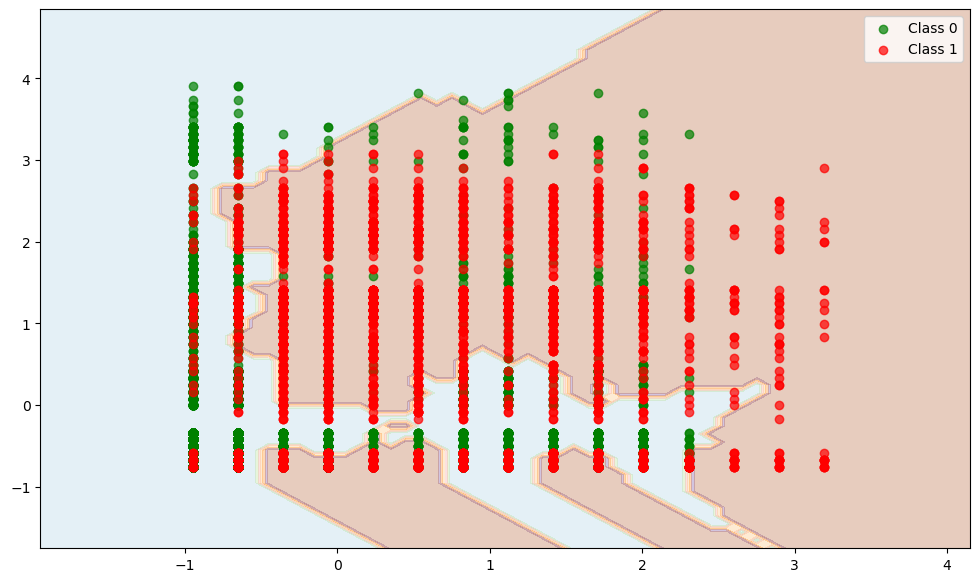

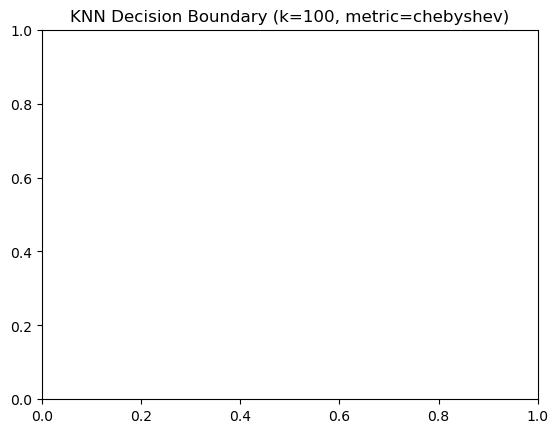

              precision    recall  f1-score   support

           0       0.91      0.89      0.90      3000
           1       0.79      0.83      0.81      1500

    accuracy                           0.87      4500
   macro avg       0.85      0.86      0.86      4500
weighted avg       0.87      0.87      0.87      4500



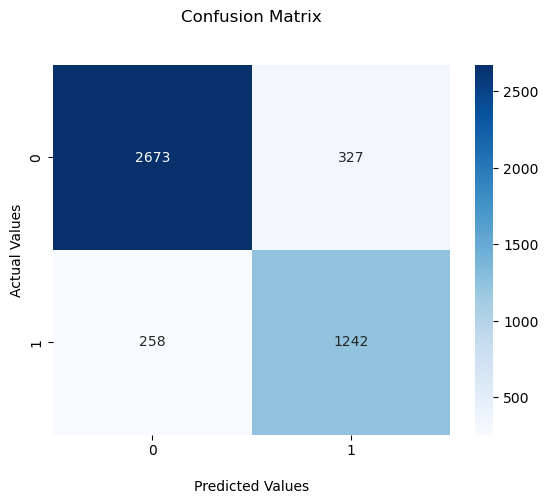

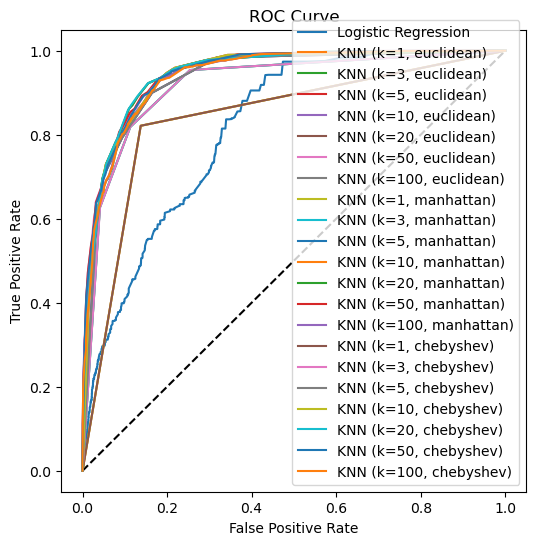

In [57]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import f1_score
import matplotlib.pyplot as plt

# Lista różnych wartości K do przetestowania
k_values = [1, 3, 5, 10, 20, 50, 100]
# Lista różnych metryk
metrics = ['euclidean', 'manhattan', 'chebyshev']

for metric in metrics:
    print(f"\n{'='*50}")
    print(f"Testing KNN with metric: {metric}")
    print(f"{'='*50}")
    
    for k in k_values:
        print(f"\nK = {k}")
        
        # Tworzenie i trenowanie modelu KNN
        model_knn = KNeighborsClassifier(n_neighbors=k, metric=metric)
        model_knn.fit(X_train_standardized, y_train)
        
        # Predykcje i obliczenie F1 score
        y_train_pred = model_knn.predict(X_train_standardized)
        y_test_pred = model_knn.predict(X_test_standardized)
        
        f1_train = f1_score(y_train, y_train_pred)
        f1_test = f1_score(y_test, y_test_pred)
        
        print(f"Train F1 score: {f1_train:.4f}")
        print(f"Test F1 score: {f1_test:.4f}")
        
        # Wizualizacja powierzchni decyzyjnej
        plt.figure(figsize=(10, 6))
        plot_classification_surface(X_plot=X_train_standardized, 
                                  y_plot=y_train, 
                                  trained_model=model_knn)
        plt.title(f'KNN Decision Boundary (k={k}, metric={metric})')
        plt.show()
        
        # Obliczenie i wyświetlenie innych metryk
        calculate_metrics(model_knn, f'KNN (k={k}, {metric})', X_test_standardized, y_test)

### Drzewo decyzyjne

In [60]:
from sklearn.tree import DecisionTreeClassifier

model_tree = DecisionTreeClassifier(max_depth=3, min_samples_leaf=int(X_train.shape[0]*0.001))
model_tree.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=3, min_samples_leaf=10)

In [70]:
!pip install dtreeviz
from dtreeviz import trees

viz = trees.dtreeviz(model_tree, x_data=X_train, y_data=y_train,
                     target_name='Diabetic', feature_names = X_train.columns)
viz

AttributeError: module 'dtreeviz.trees' has no attribute 'dtreeviz'

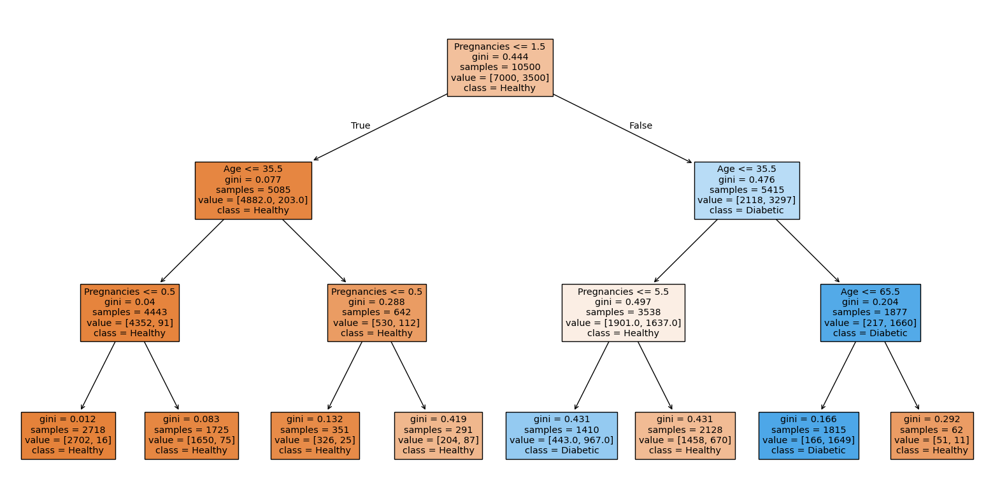

In [68]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

plt.figure(figsize=(20,10))
plot_tree(model_tree, 
          feature_names=X_train.columns,  
          class_names=['Healthy', 'Diabetic'],
          filled=True)
plt.show()

C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


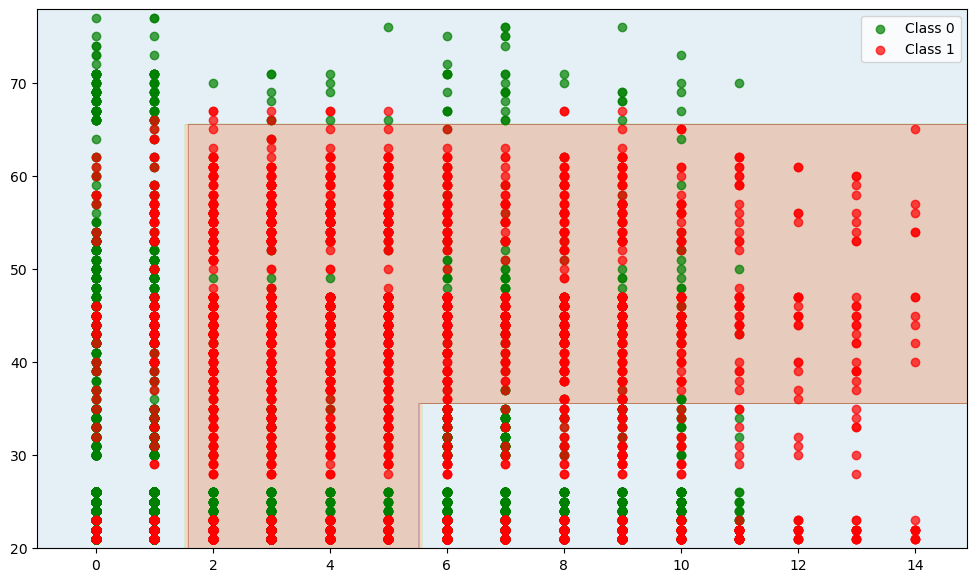

In [74]:
import numpy as np

plot_classification_surface(X_plot=np.array(X_train), y_plot=y_train, trained_model=model_tree)

C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


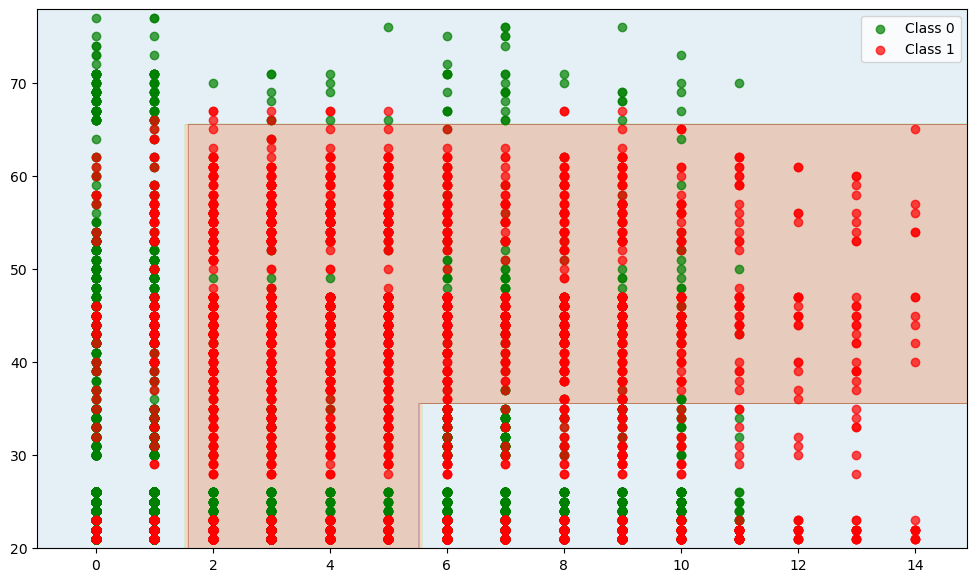

In [76]:
plot_classification_surface(X_plot=X_train.values,  # Konwersja do numpy array z zachowaniem kolejności
                          y_plot=y_train, 
                          trained_model=model_tree)

C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


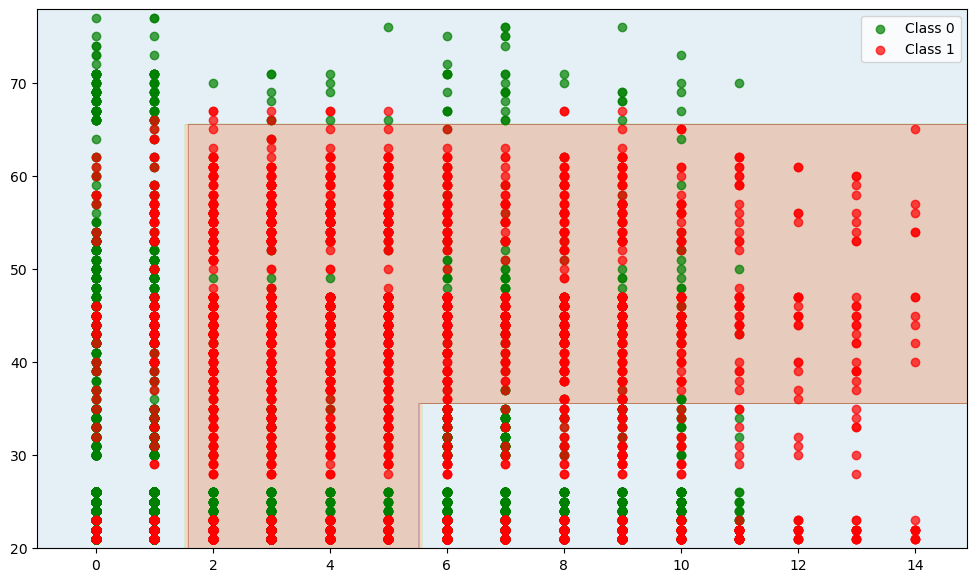

In [78]:
# Upewnij się, że kolejność kolumn się zgadza
X_array = X_train[model_tree.feature_names_in_].values

plot_classification_surface(X_plot=X_array,
                          y_plot=y_train,
                          trained_model=model_tree)

              precision    recall  f1-score   support

           0       0.88      0.91      0.89      3000
           1       0.80      0.76      0.78      1500

    accuracy                           0.86      4500
   macro avg       0.84      0.83      0.84      4500
weighted avg       0.86      0.86      0.86      4500



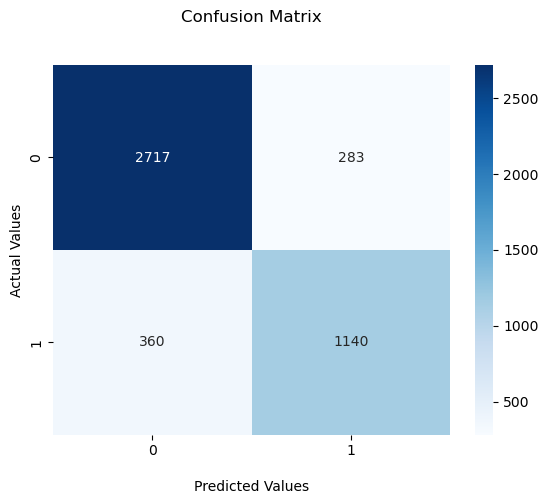

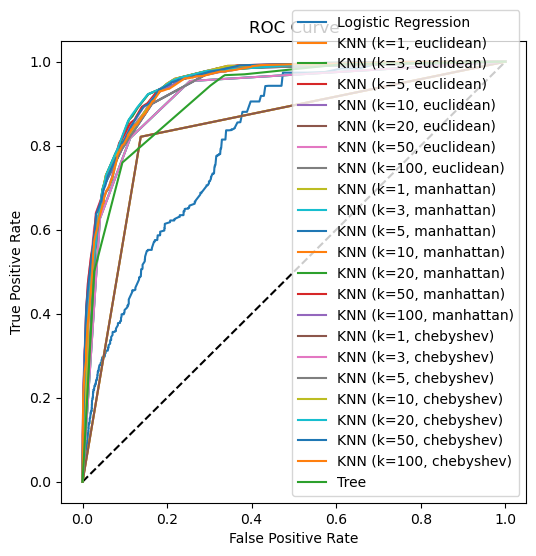

,Model,F1_score,AUC
0,Logistic Regression,0.580928,0.816493
1,"KNN (k=1, euclidean)",0.783466,0.841833
2,"KNN (k=3, euclidean)",0.800783,0.918663
3,"KNN (k=5, euclidean)",0.800943,0.934716
4,"KNN (k=10, euclidean)",0.808196,0.942804
5,"KNN (k=20, euclidean)",0.809249,0.946370
6,"KNN (k=50, euclidean)",0.818882,0.947926
7,"KNN (k=100, euclidean)",0.807730,0.942915
8,"KNN (k=1, manhattan)",0.783466,0.841833
9,"KNN (k=3, manhattan)",0.800783,0.918663


In [80]:
calculate_metrics(model_tree, 'Tree', X_test, y_test)

### Ćwiczenie
Sprawdź jak zachowuje się model dla różnej głębokości (max_depth) oraz minimalnej liczby obserwacji w liściu (min_samples_leaf). Zwizualizuj działanie modelu z wykorzystaniem funkcji plot_classification_surface oraz za każdym razem oblicz F1_score na zbiorze treningowym oraz testowym.


Testing Decision Tree with max_depth=2, min_samples_leaf=1
Train F1 score: 0.6174
Test F1 score: 0.6420


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

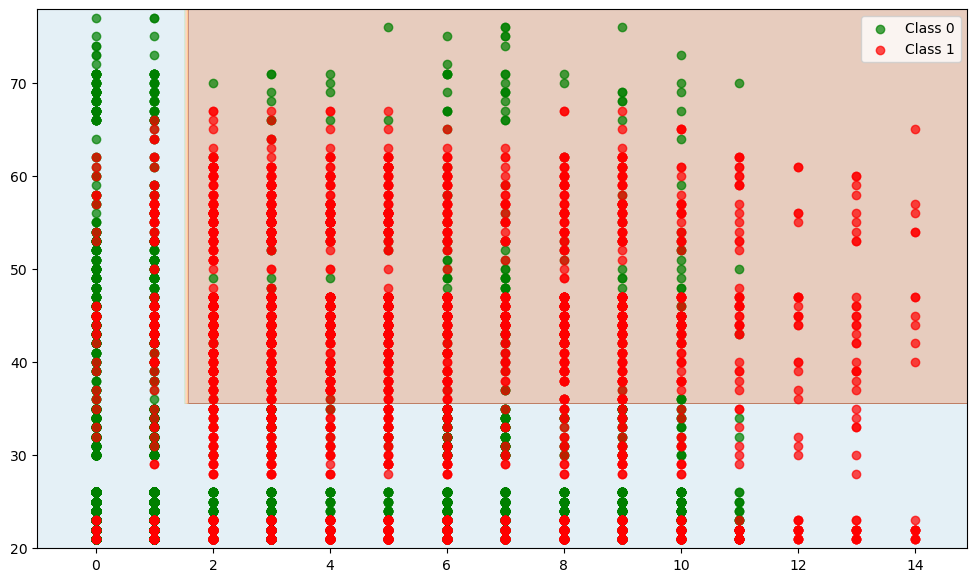

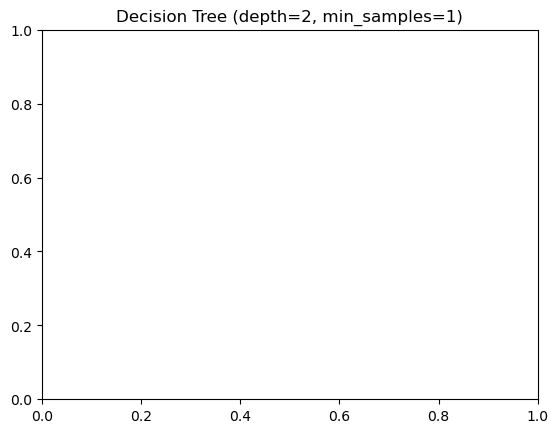

              precision    recall  f1-score   support

           0       0.80      0.97      0.87      3000
           1       0.88      0.50      0.64      1500

    accuracy                           0.81      4500
   macro avg       0.84      0.74      0.76      4500
weighted avg       0.83      0.81      0.80      4500



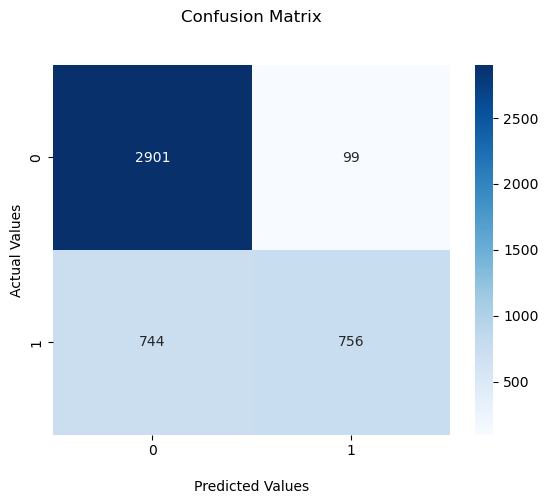

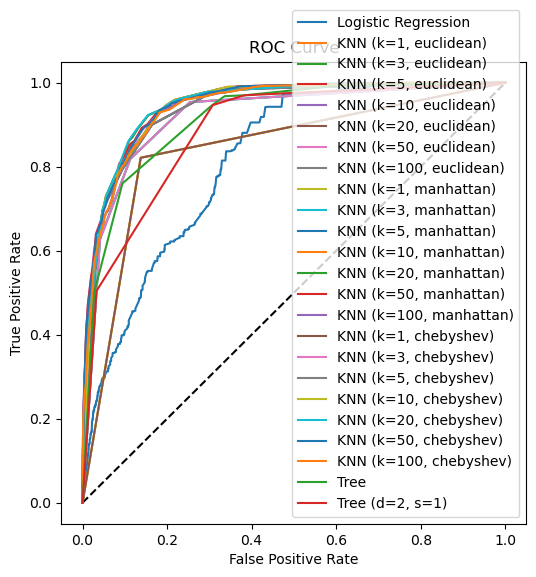


Testing Decision Tree with max_depth=2, min_samples_leaf=5
Train F1 score: 0.6174
Test F1 score: 0.6420


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

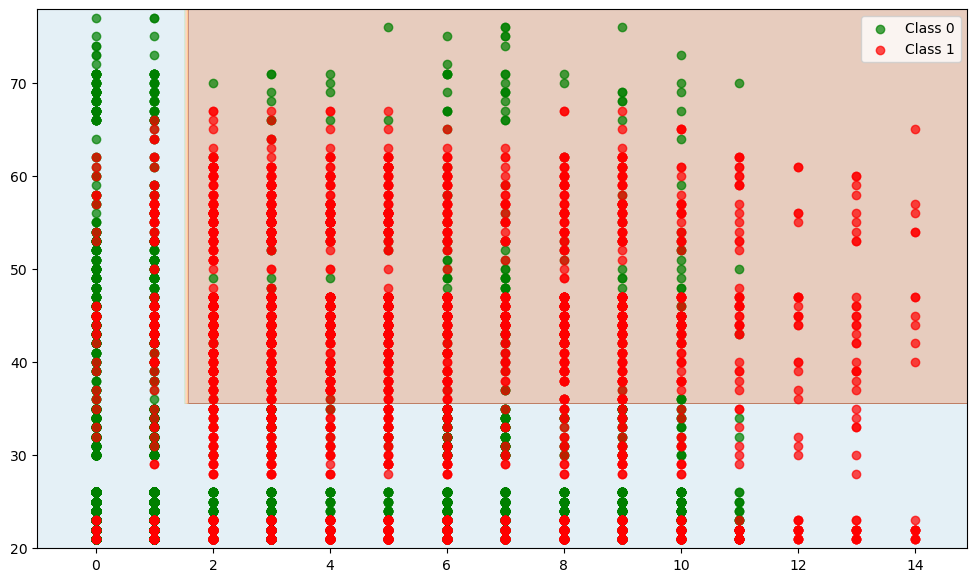

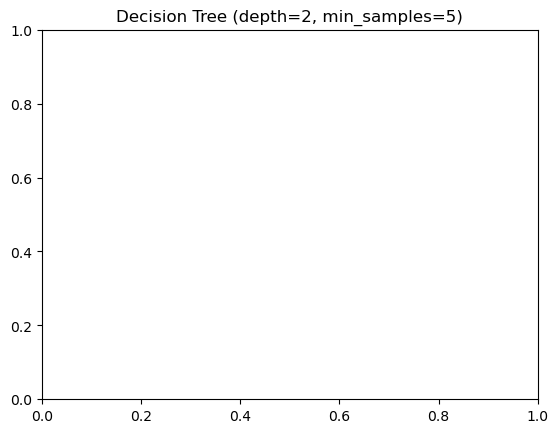

              precision    recall  f1-score   support

           0       0.80      0.97      0.87      3000
           1       0.88      0.50      0.64      1500

    accuracy                           0.81      4500
   macro avg       0.84      0.74      0.76      4500
weighted avg       0.83      0.81      0.80      4500



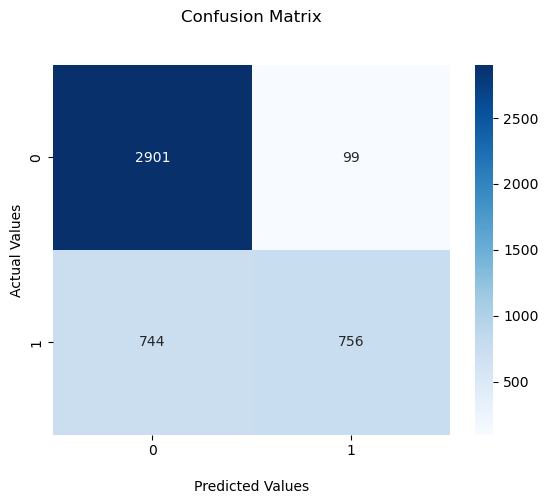

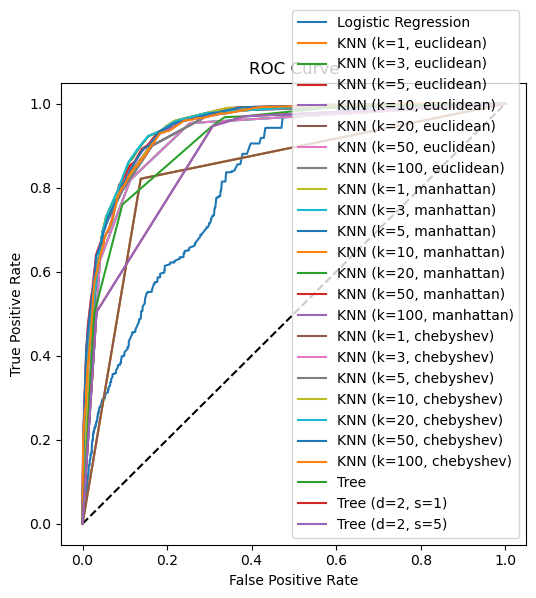


Testing Decision Tree with max_depth=2, min_samples_leaf=10
Train F1 score: 0.6174
Test F1 score: 0.6420


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

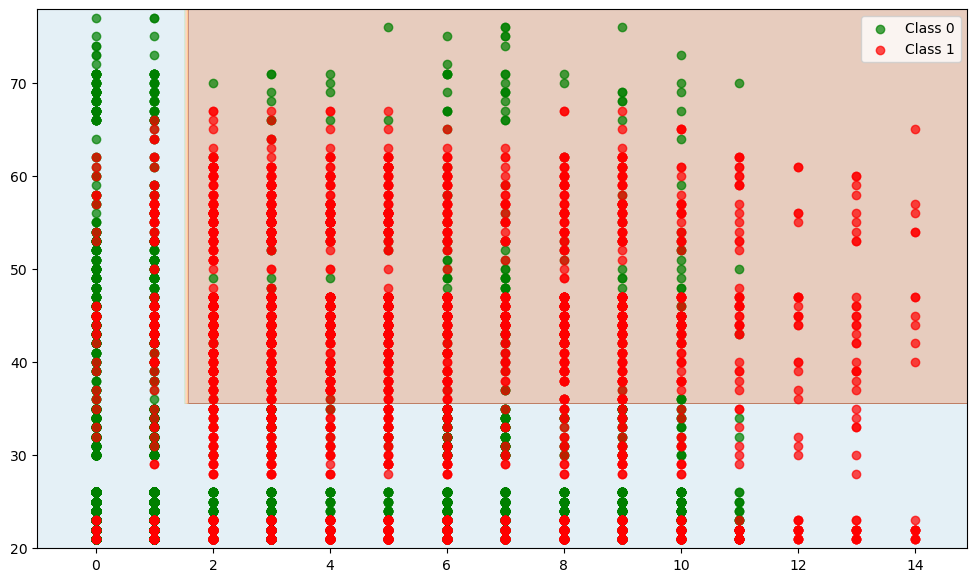

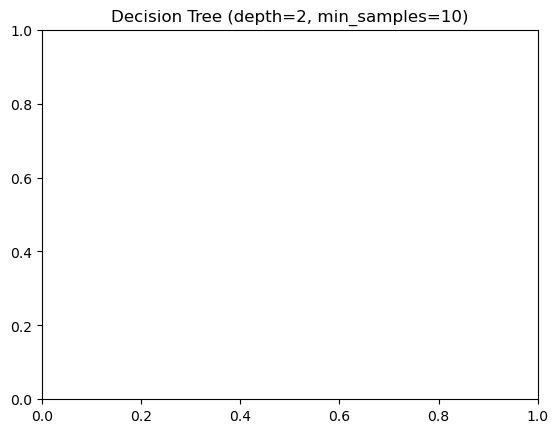

              precision    recall  f1-score   support

           0       0.80      0.97      0.87      3000
           1       0.88      0.50      0.64      1500

    accuracy                           0.81      4500
   macro avg       0.84      0.74      0.76      4500
weighted avg       0.83      0.81      0.80      4500



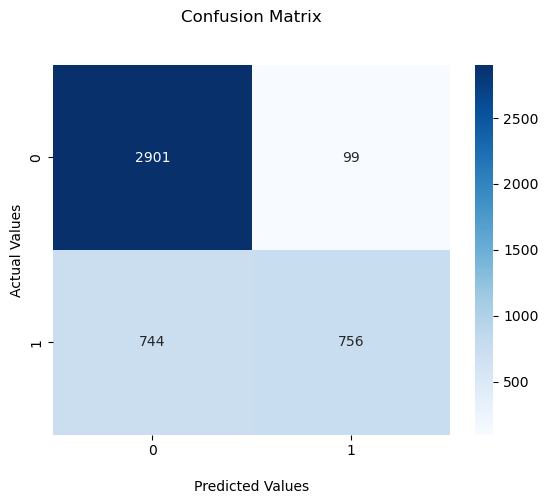

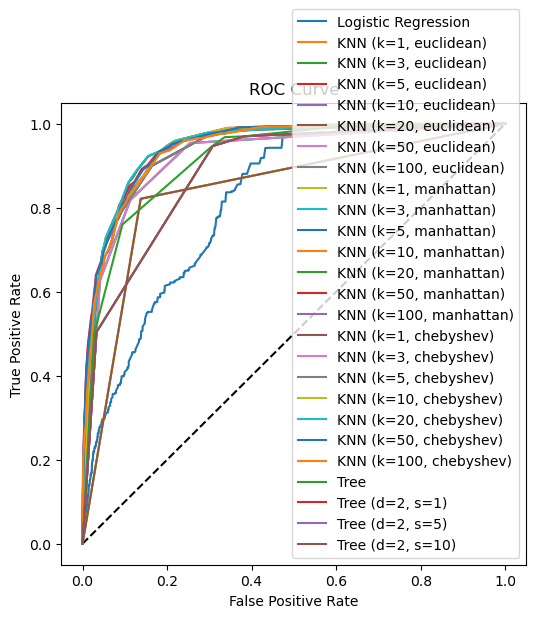


Testing Decision Tree with max_depth=2, min_samples_leaf=20
Train F1 score: 0.6174
Test F1 score: 0.6420


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

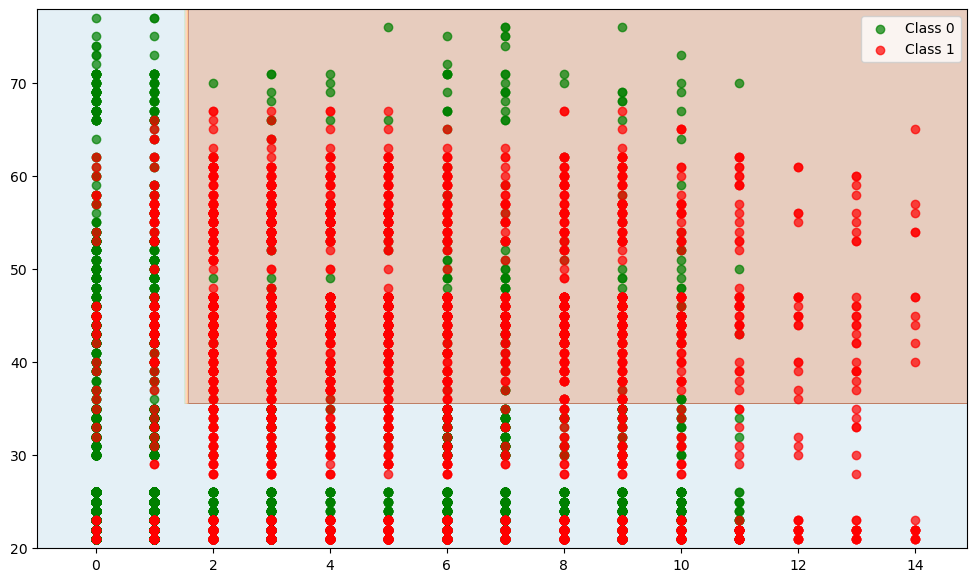

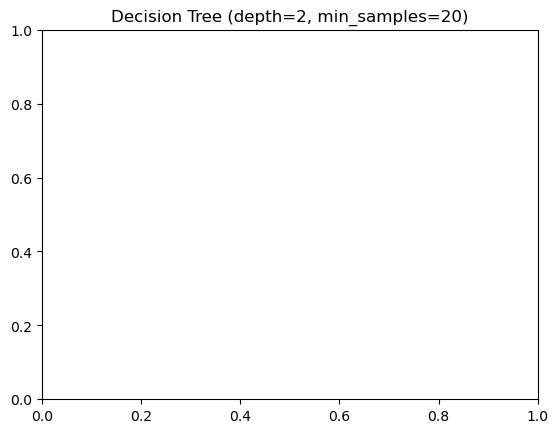

              precision    recall  f1-score   support

           0       0.80      0.97      0.87      3000
           1       0.88      0.50      0.64      1500

    accuracy                           0.81      4500
   macro avg       0.84      0.74      0.76      4500
weighted avg       0.83      0.81      0.80      4500



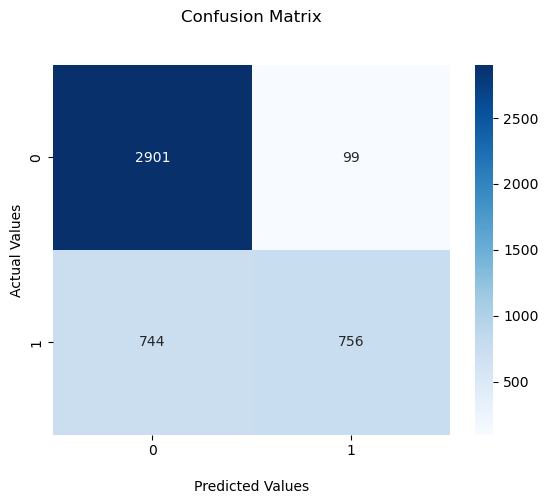

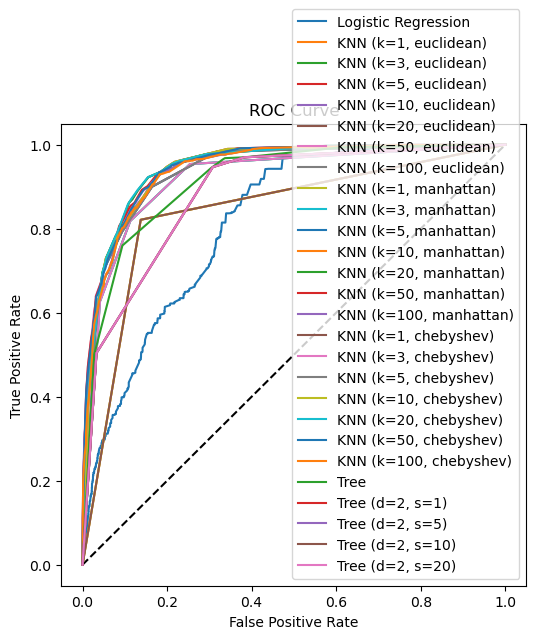


Testing Decision Tree with max_depth=2, min_samples_leaf=50
Train F1 score: 0.6174
Test F1 score: 0.6420


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

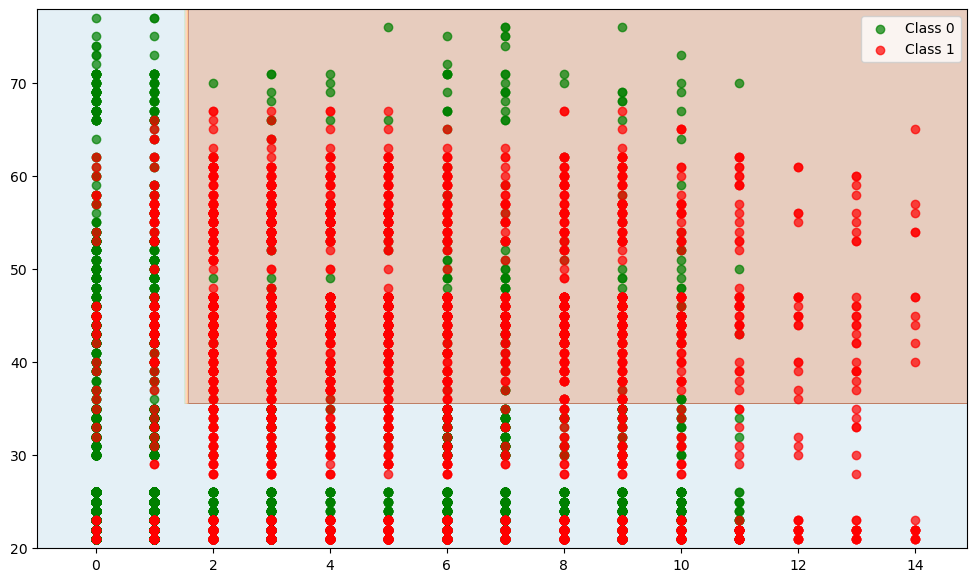

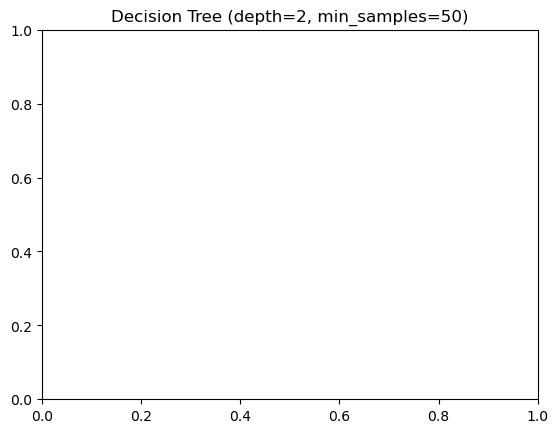

              precision    recall  f1-score   support

           0       0.80      0.97      0.87      3000
           1       0.88      0.50      0.64      1500

    accuracy                           0.81      4500
   macro avg       0.84      0.74      0.76      4500
weighted avg       0.83      0.81      0.80      4500



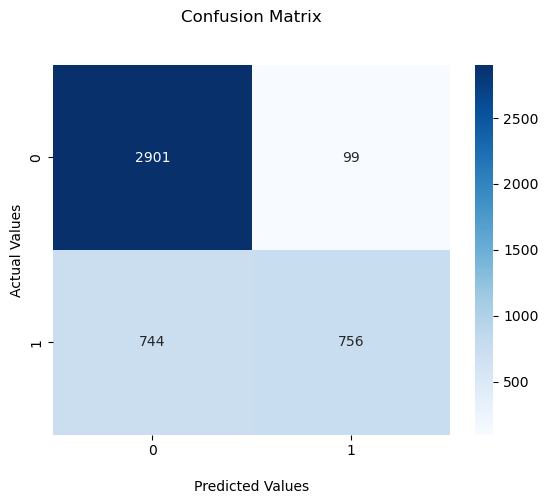

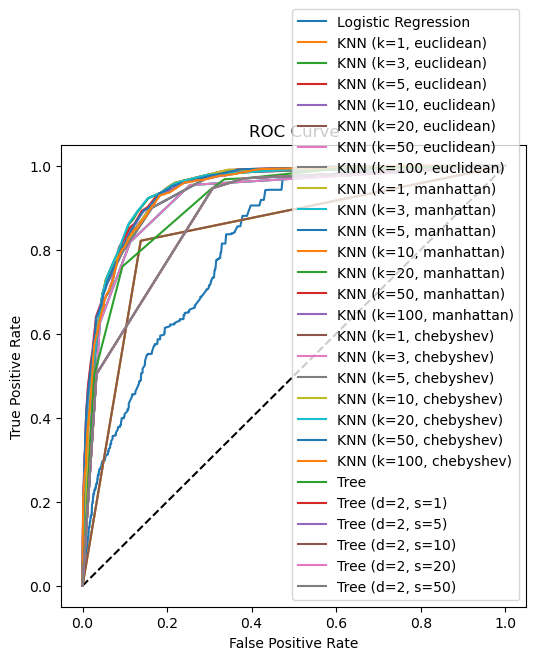


Testing Decision Tree with max_depth=3, min_samples_leaf=1
Train F1 score: 0.7780
Test F1 score: 0.7800


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

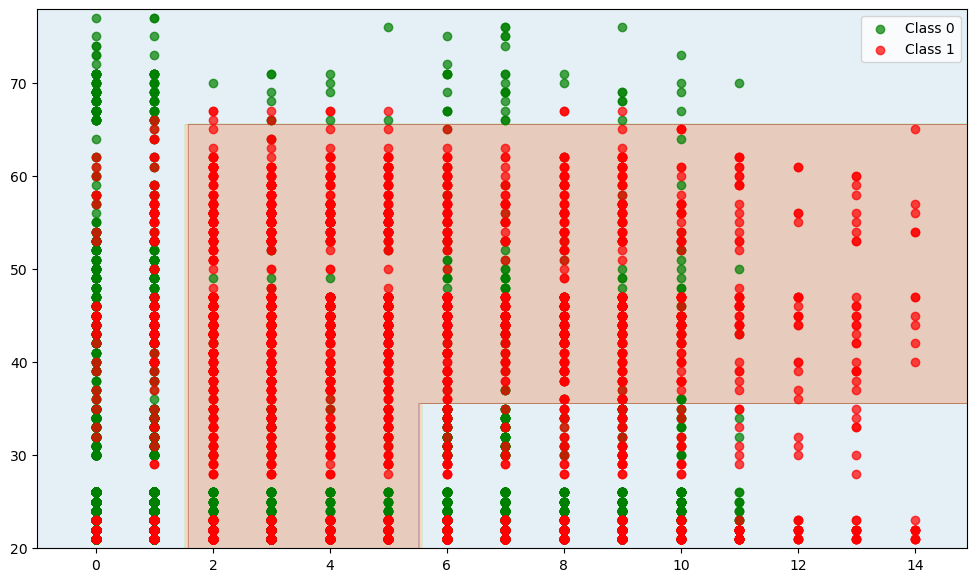

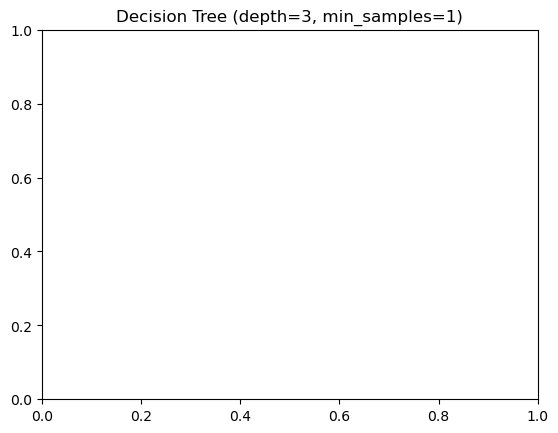

              precision    recall  f1-score   support

           0       0.88      0.91      0.89      3000
           1       0.80      0.76      0.78      1500

    accuracy                           0.86      4500
   macro avg       0.84      0.83      0.84      4500
weighted avg       0.86      0.86      0.86      4500



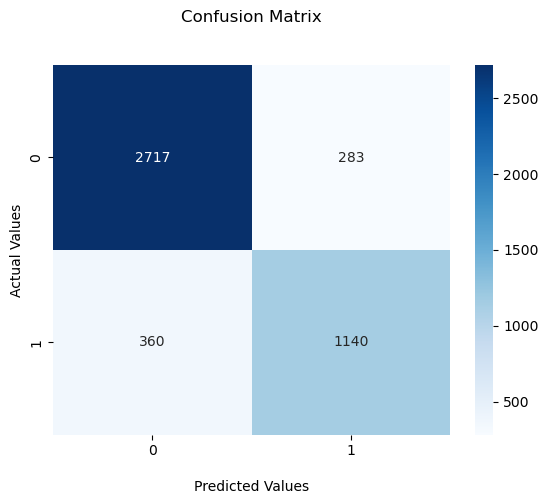

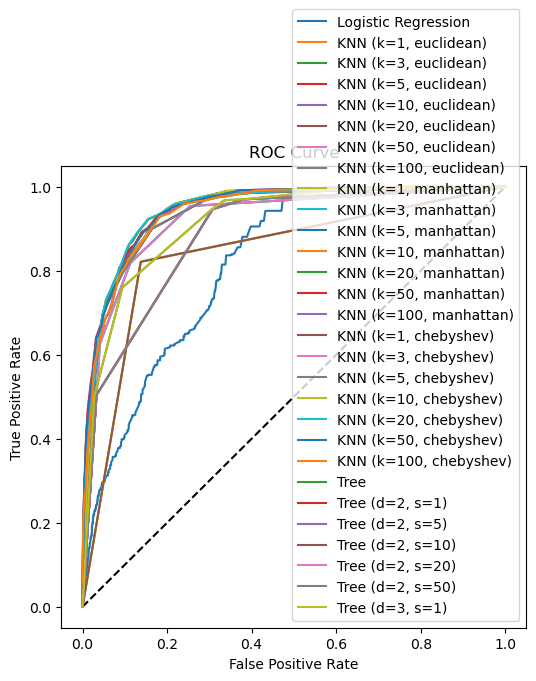


Testing Decision Tree with max_depth=3, min_samples_leaf=5
Train F1 score: 0.7780
Test F1 score: 0.7800


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

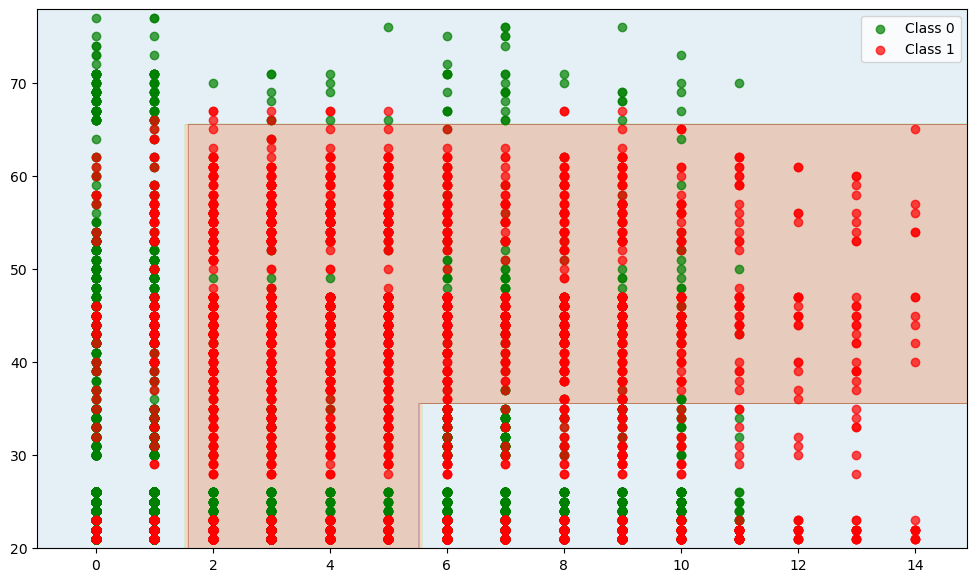

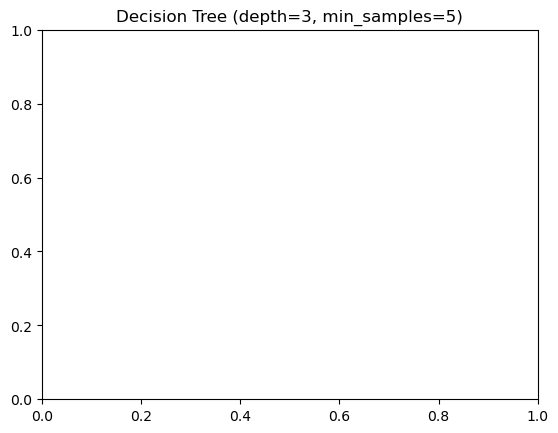

              precision    recall  f1-score   support

           0       0.88      0.91      0.89      3000
           1       0.80      0.76      0.78      1500

    accuracy                           0.86      4500
   macro avg       0.84      0.83      0.84      4500
weighted avg       0.86      0.86      0.86      4500



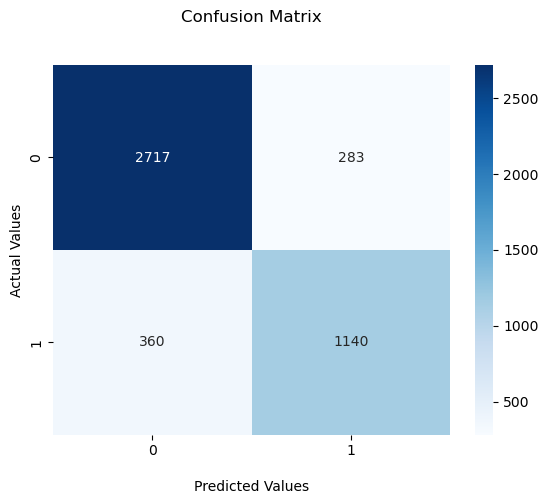

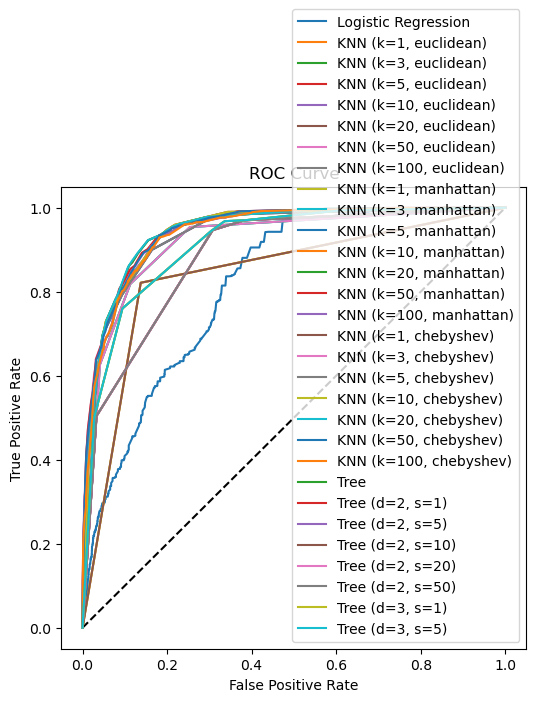


Testing Decision Tree with max_depth=3, min_samples_leaf=10
Train F1 score: 0.7780
Test F1 score: 0.7800


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

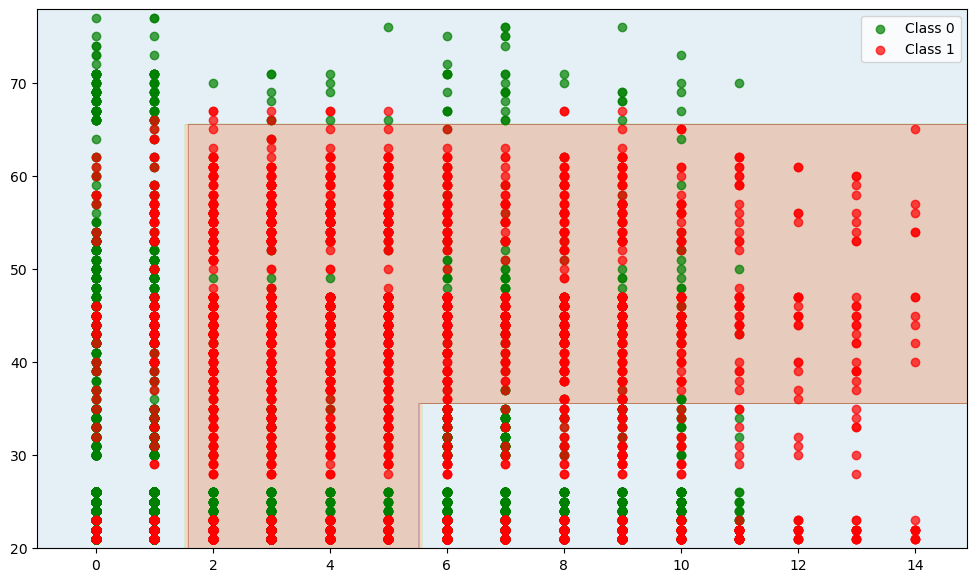

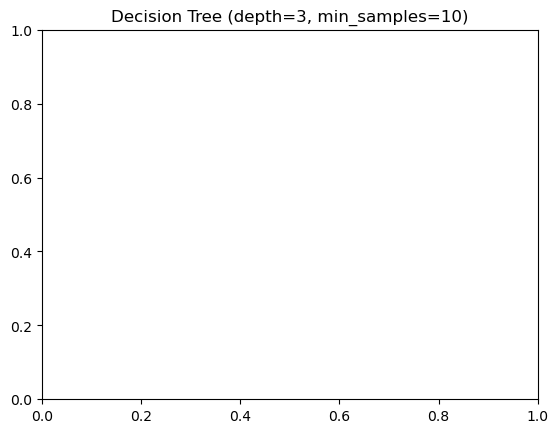

              precision    recall  f1-score   support

           0       0.88      0.91      0.89      3000
           1       0.80      0.76      0.78      1500

    accuracy                           0.86      4500
   macro avg       0.84      0.83      0.84      4500
weighted avg       0.86      0.86      0.86      4500



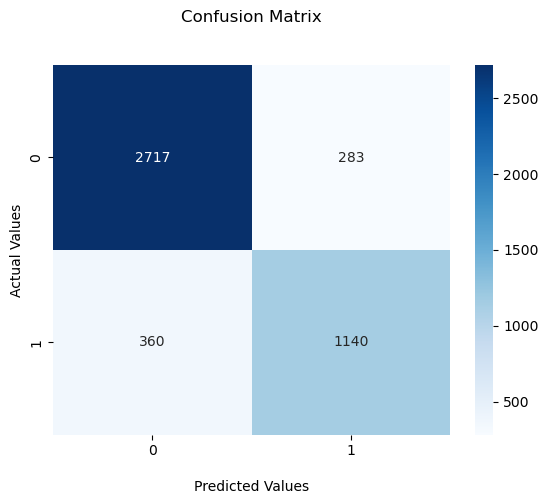

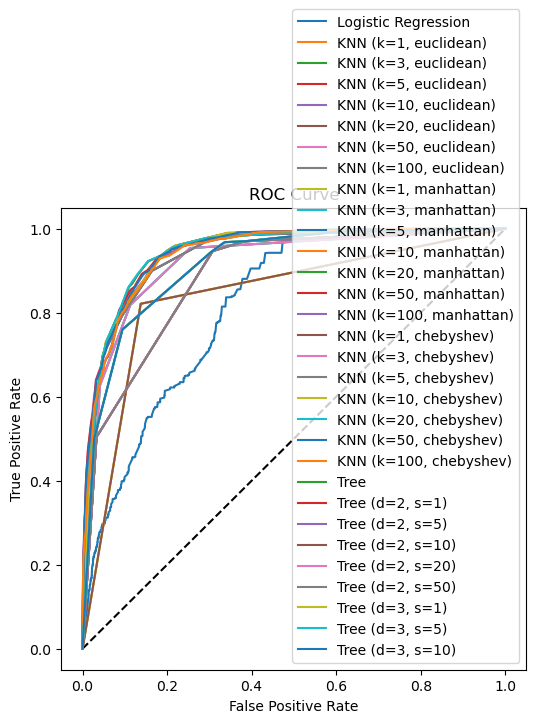


Testing Decision Tree with max_depth=3, min_samples_leaf=20
Train F1 score: 0.7780
Test F1 score: 0.7800


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

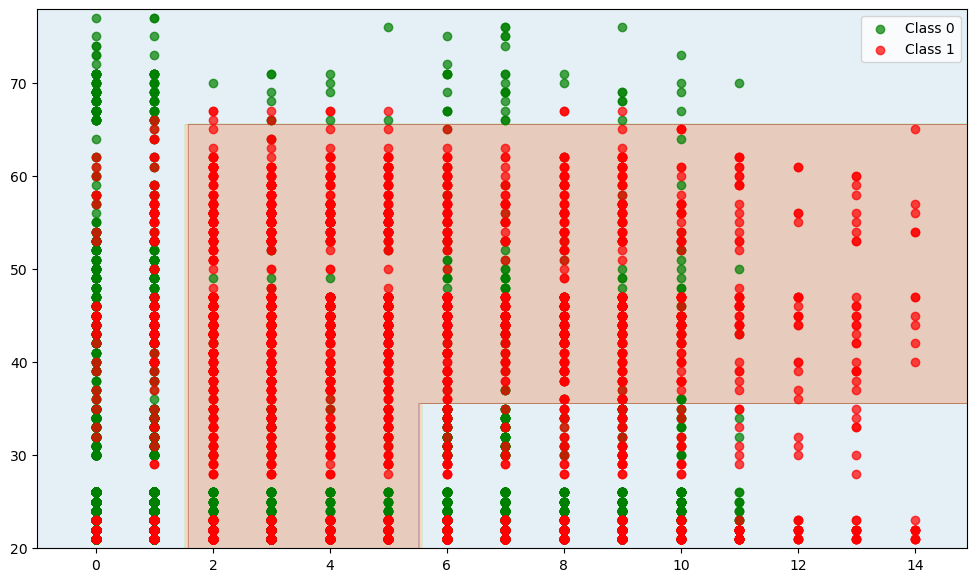

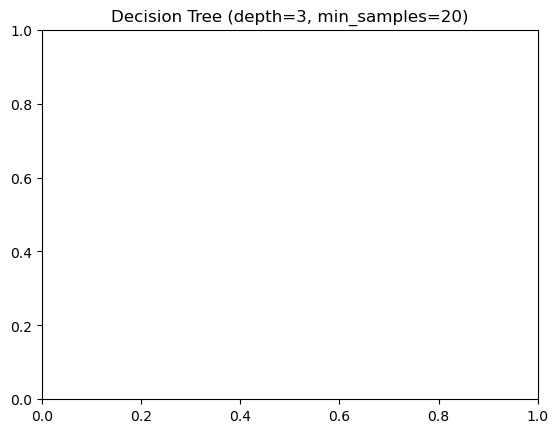

              precision    recall  f1-score   support

           0       0.88      0.91      0.89      3000
           1       0.80      0.76      0.78      1500

    accuracy                           0.86      4500
   macro avg       0.84      0.83      0.84      4500
weighted avg       0.86      0.86      0.86      4500



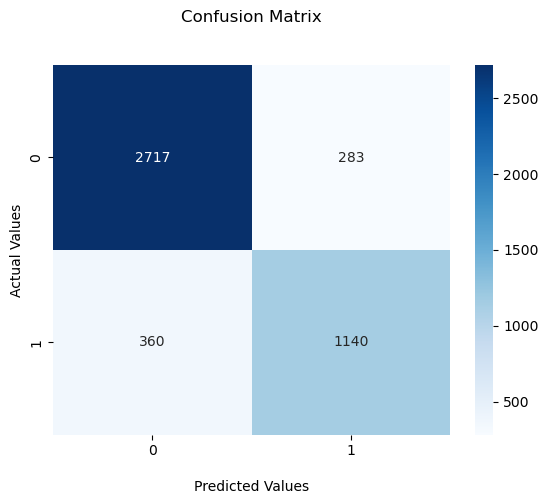

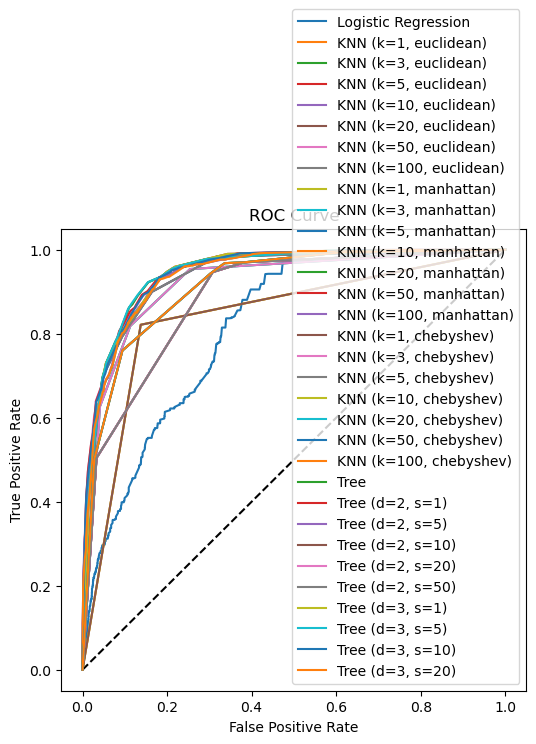


Testing Decision Tree with max_depth=3, min_samples_leaf=50
Train F1 score: 0.7780
Test F1 score: 0.7800


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

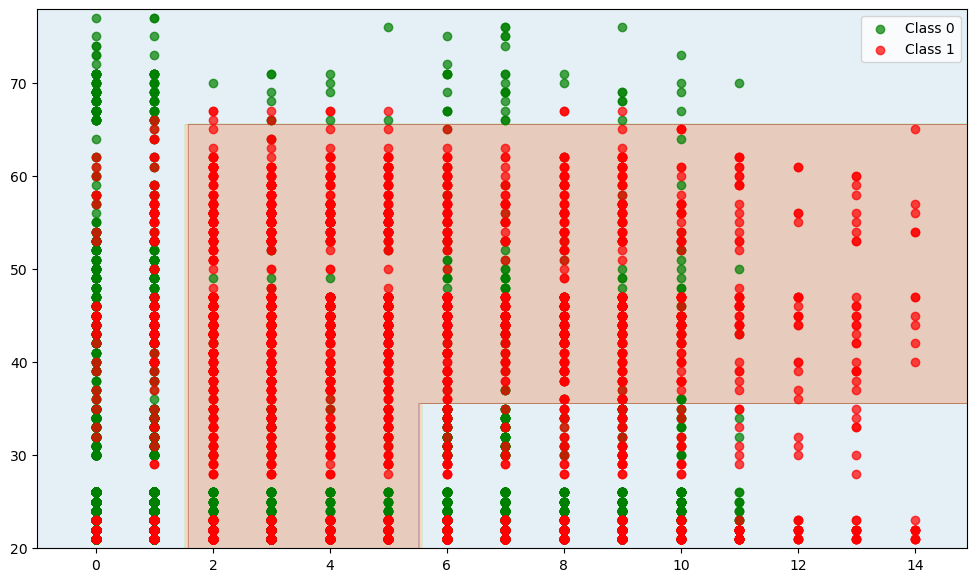

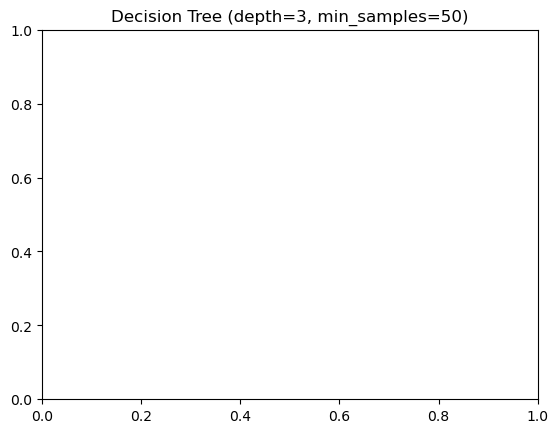

              precision    recall  f1-score   support

           0       0.88      0.91      0.89      3000
           1       0.80      0.76      0.78      1500

    accuracy                           0.86      4500
   macro avg       0.84      0.83      0.84      4500
weighted avg       0.86      0.86      0.86      4500



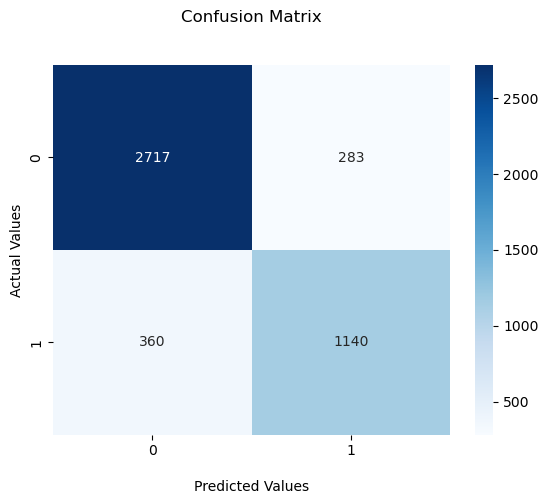

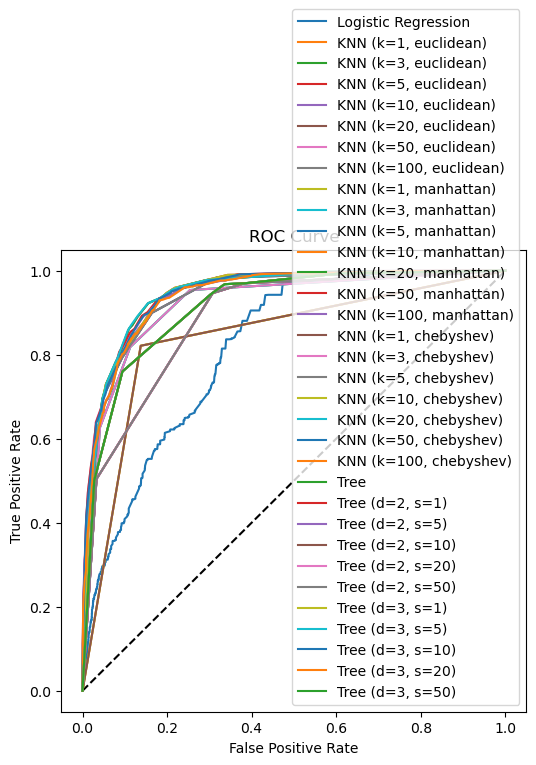


Testing Decision Tree with max_depth=5, min_samples_leaf=1
Train F1 score: 0.8308
Test F1 score: 0.8213


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

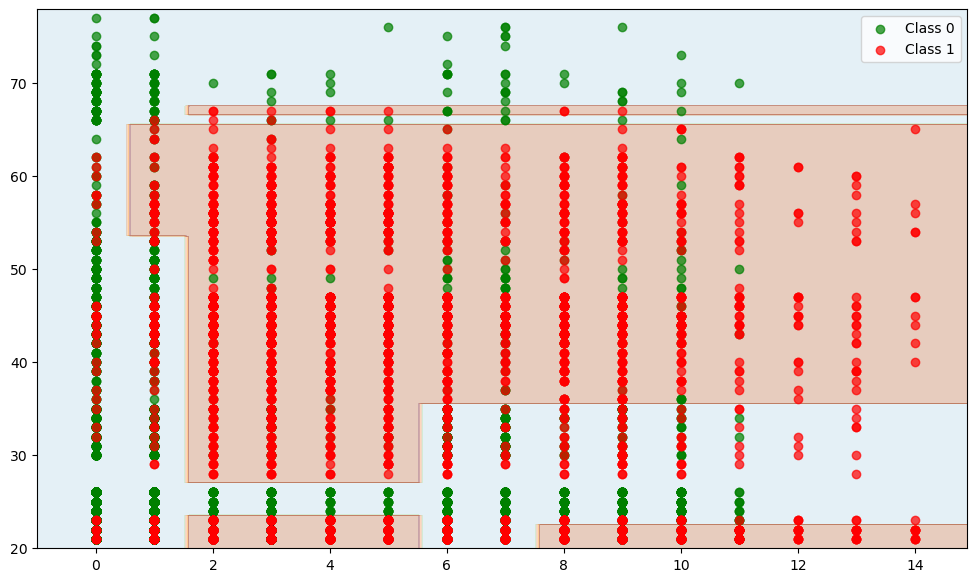

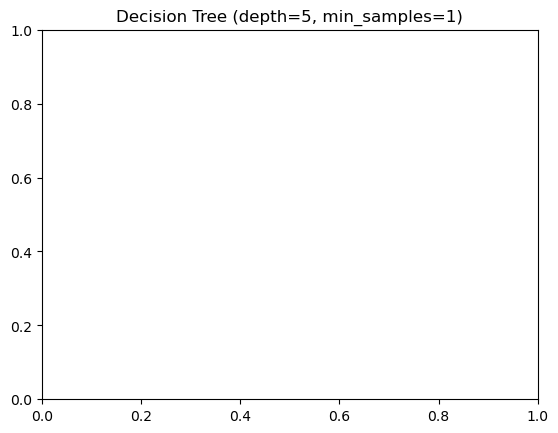

              precision    recall  f1-score   support

           0       0.92      0.89      0.91      3000
           1       0.79      0.85      0.82      1500

    accuracy                           0.88      4500
   macro avg       0.86      0.87      0.86      4500
weighted avg       0.88      0.88      0.88      4500



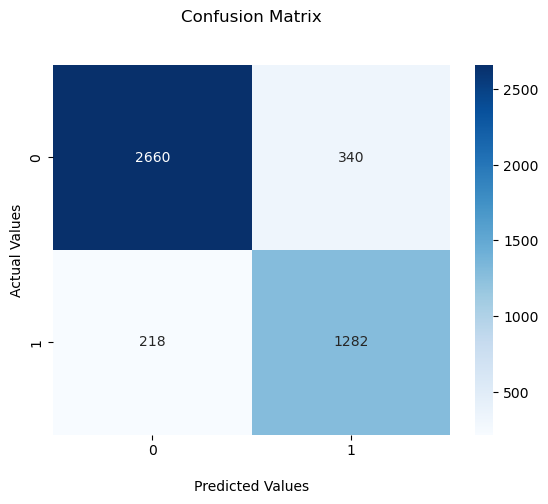

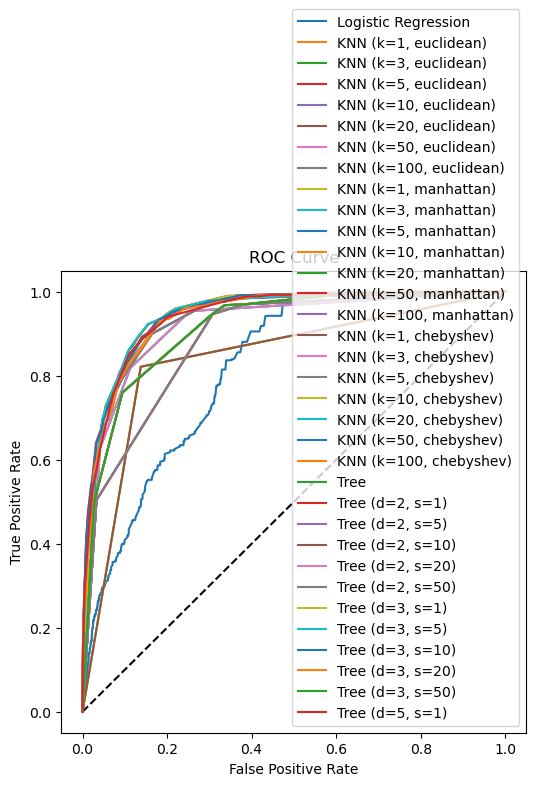


Testing Decision Tree with max_depth=5, min_samples_leaf=5
Train F1 score: 0.8308
Test F1 score: 0.8213


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

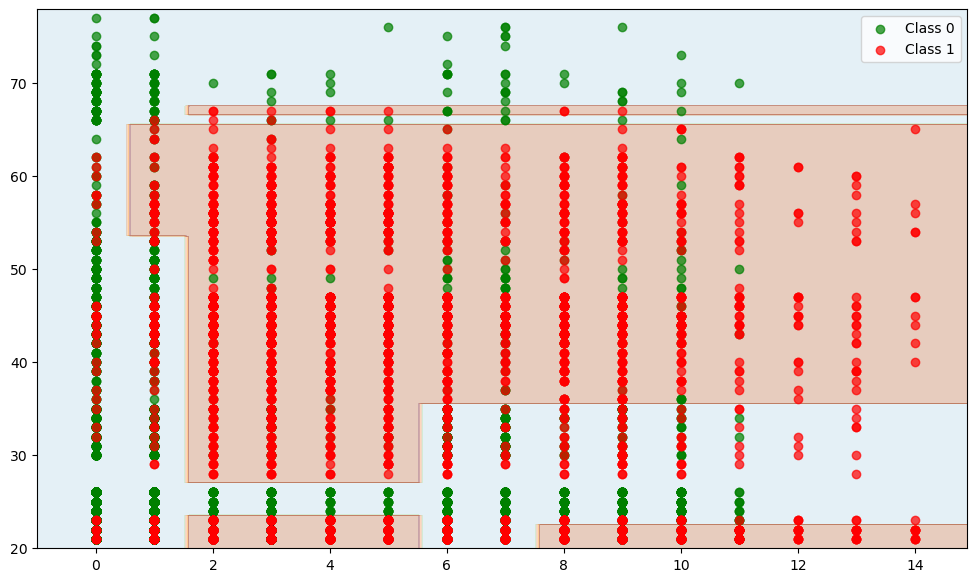

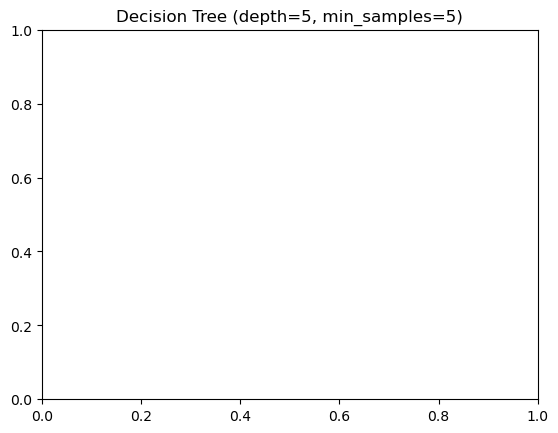

              precision    recall  f1-score   support

           0       0.92      0.89      0.91      3000
           1       0.79      0.85      0.82      1500

    accuracy                           0.88      4500
   macro avg       0.86      0.87      0.86      4500
weighted avg       0.88      0.88      0.88      4500



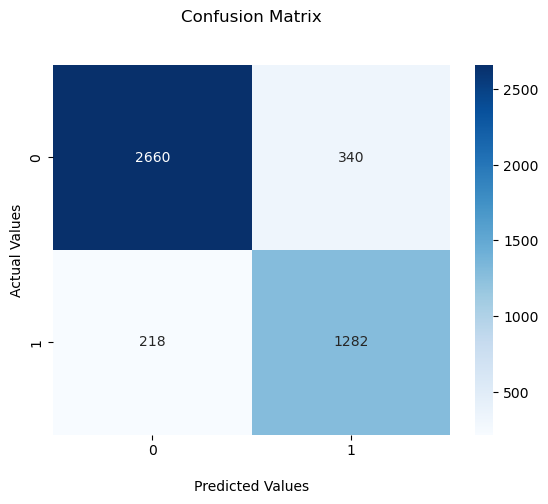

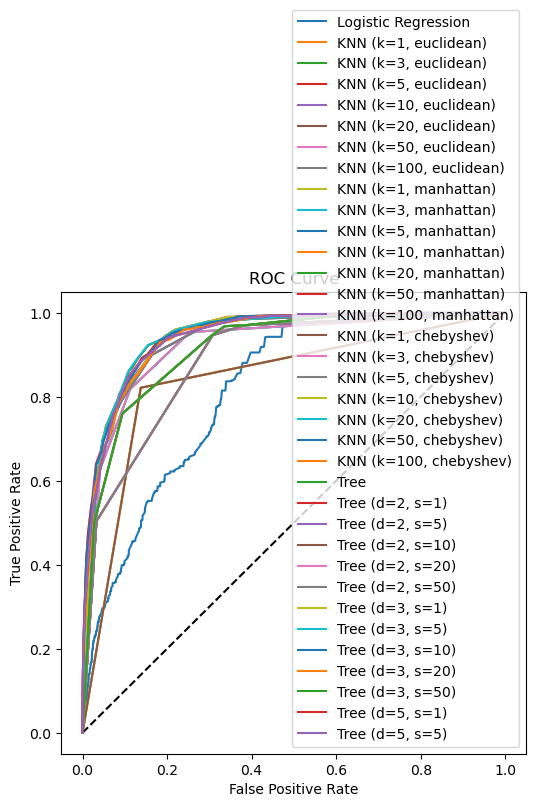


Testing Decision Tree with max_depth=5, min_samples_leaf=10
Train F1 score: 0.8307
Test F1 score: 0.8229


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

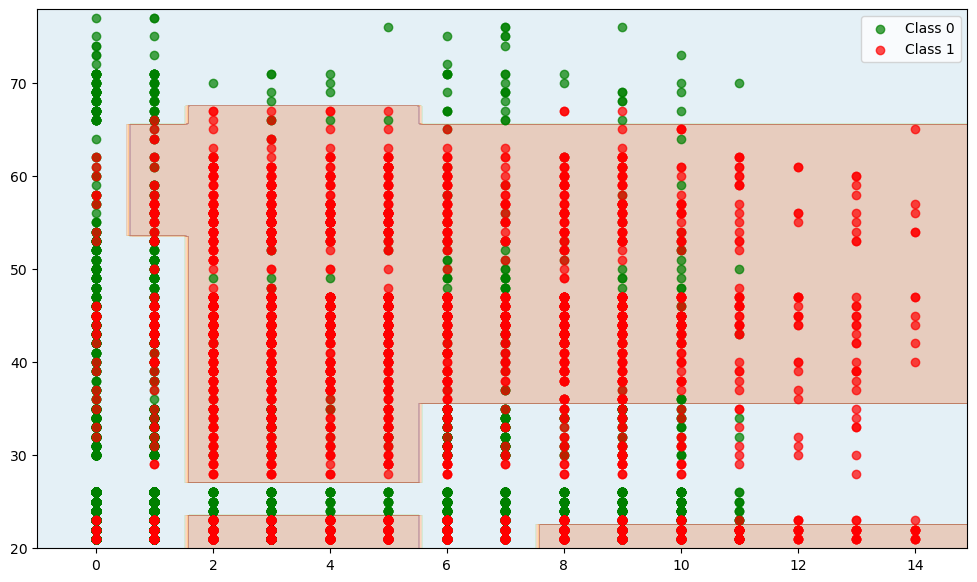

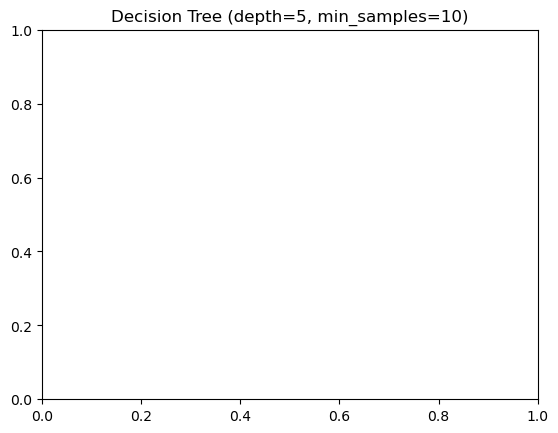

              precision    recall  f1-score   support

           0       0.93      0.89      0.91      3000
           1       0.79      0.86      0.82      1500

    accuracy                           0.88      4500
   macro avg       0.86      0.87      0.86      4500
weighted avg       0.88      0.88      0.88      4500



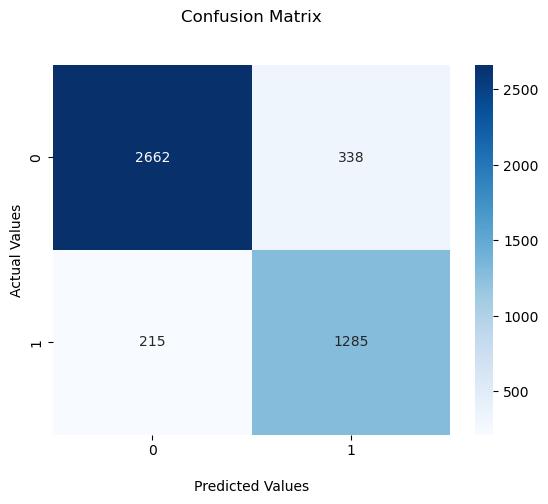

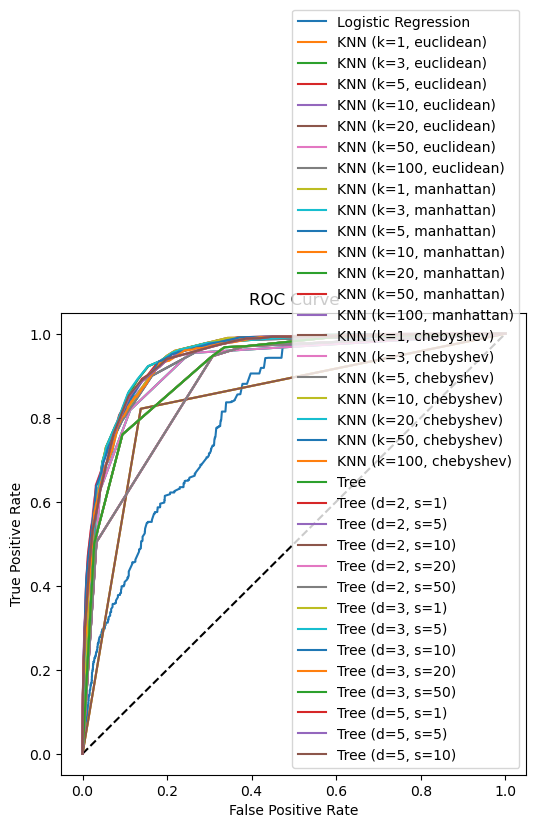


Testing Decision Tree with max_depth=5, min_samples_leaf=20
Train F1 score: 0.8299
Test F1 score: 0.8219


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

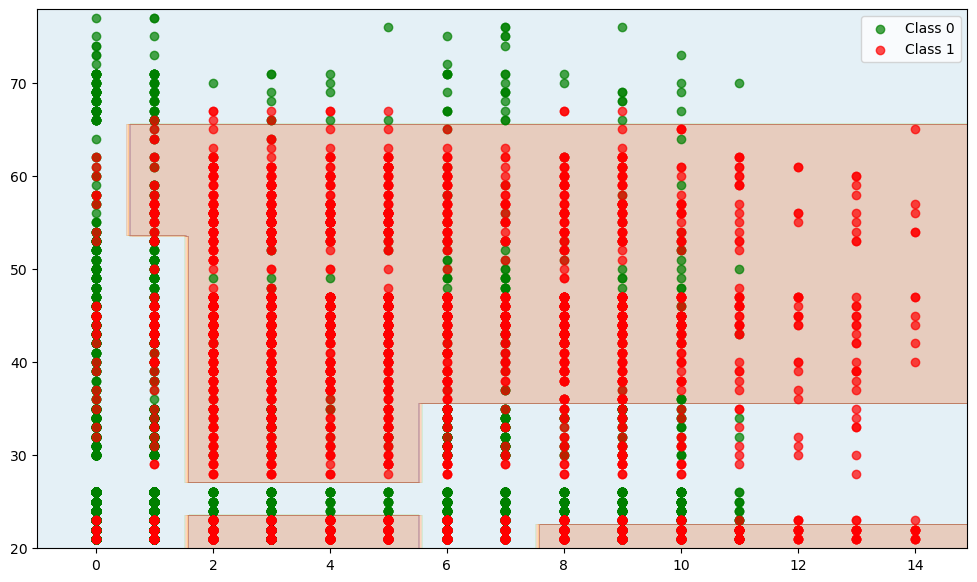

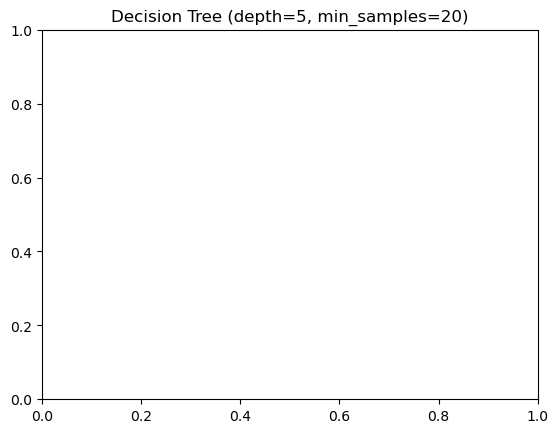

              precision    recall  f1-score   support

           0       0.92      0.89      0.91      3000
           1       0.79      0.85      0.82      1500

    accuracy                           0.88      4500
   macro avg       0.86      0.87      0.86      4500
weighted avg       0.88      0.88      0.88      4500



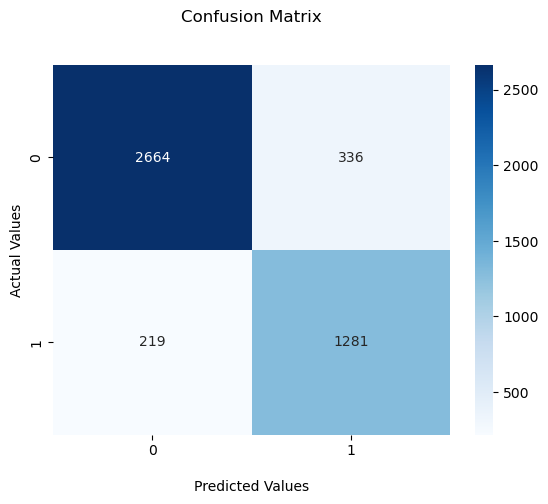

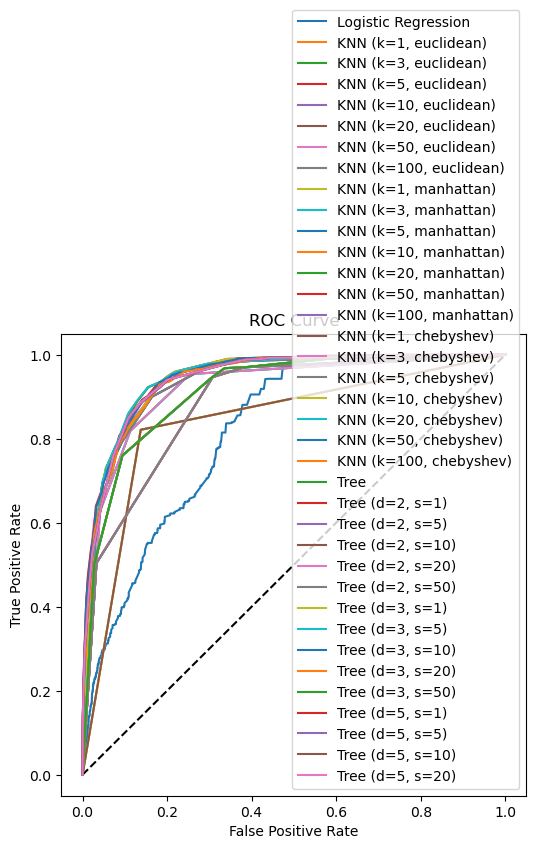


Testing Decision Tree with max_depth=5, min_samples_leaf=50
Train F1 score: 0.8280
Test F1 score: 0.8222


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

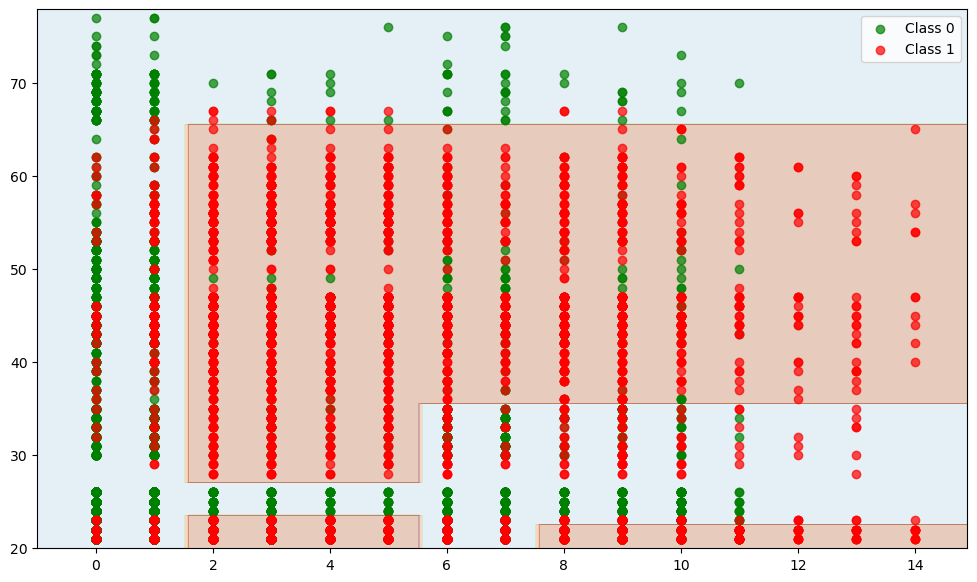

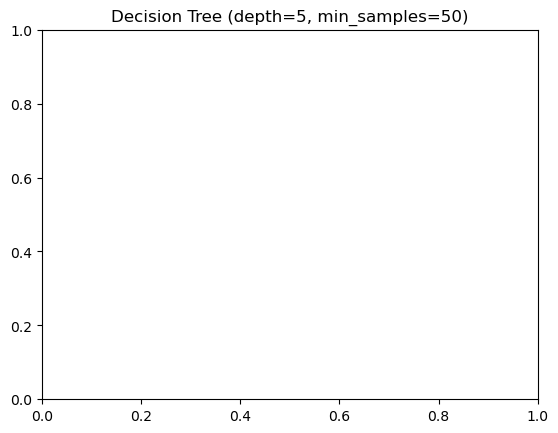

              precision    recall  f1-score   support

           0       0.92      0.89      0.91      3000
           1       0.80      0.85      0.82      1500

    accuracy                           0.88      4500
   macro avg       0.86      0.87      0.86      4500
weighted avg       0.88      0.88      0.88      4500



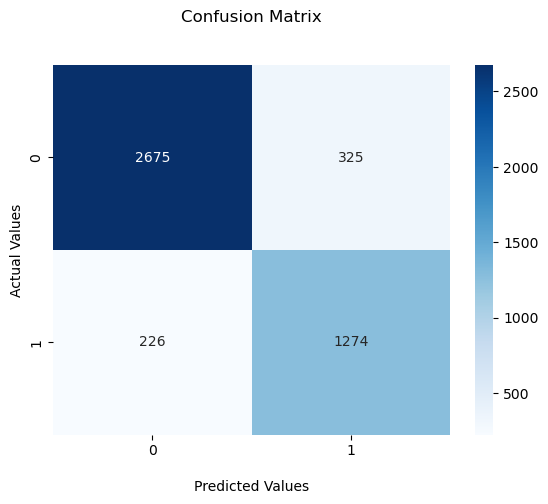

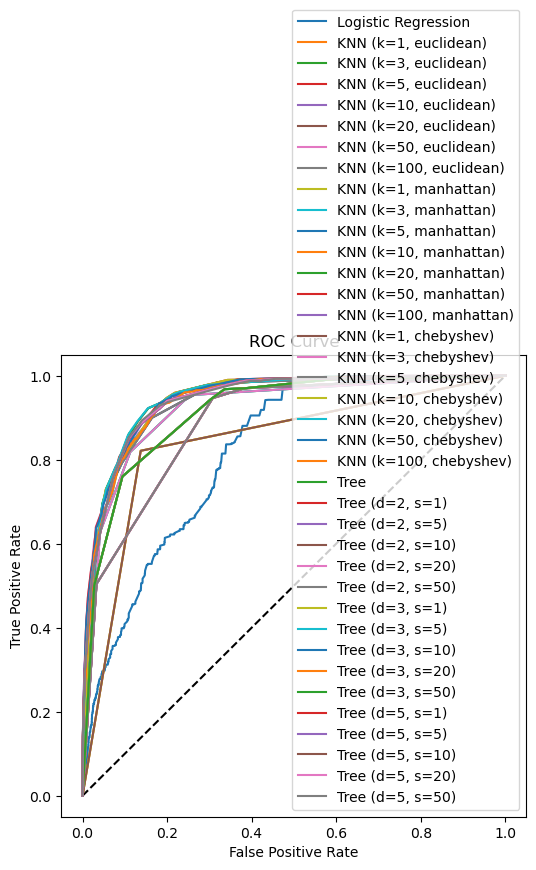


Testing Decision Tree with max_depth=7, min_samples_leaf=1
Train F1 score: 0.8392
Test F1 score: 0.8290


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

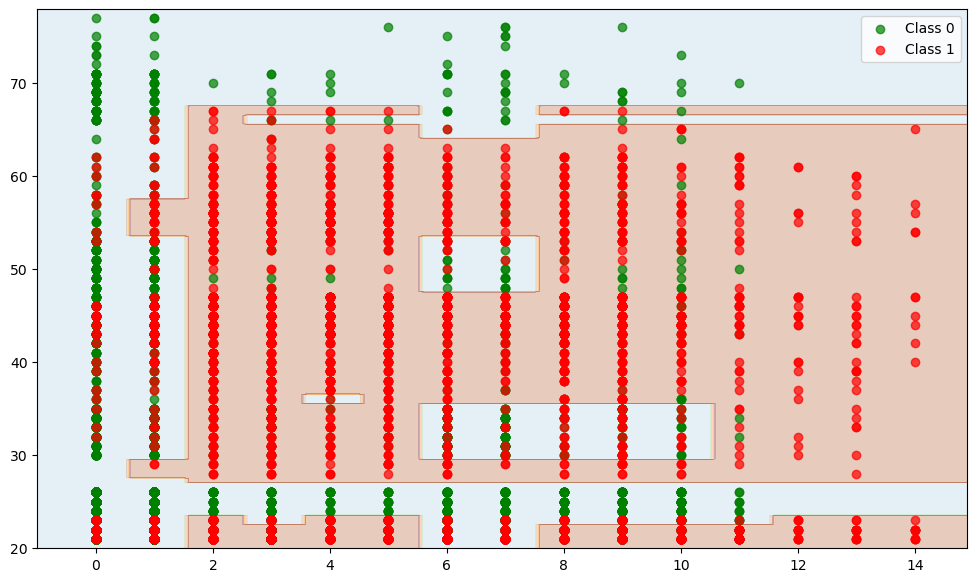

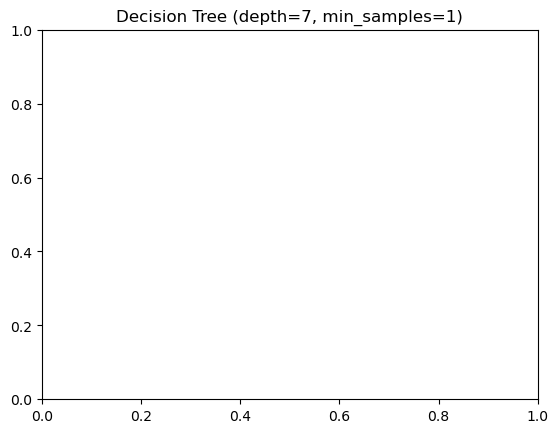

              precision    recall  f1-score   support

           0       0.92      0.90      0.91      3000
           1       0.81      0.85      0.83      1500

    accuracy                           0.88      4500
   macro avg       0.87      0.87      0.87      4500
weighted avg       0.89      0.88      0.88      4500



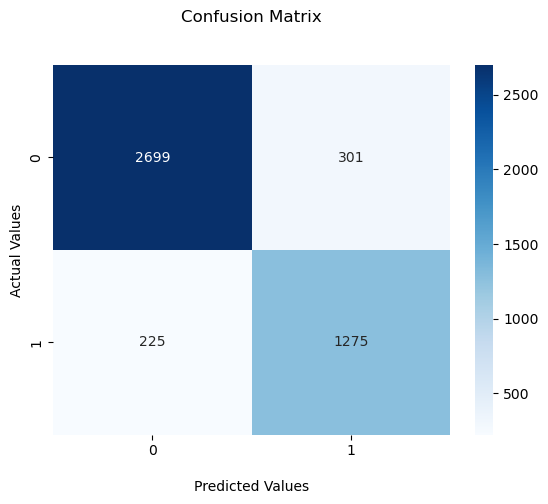

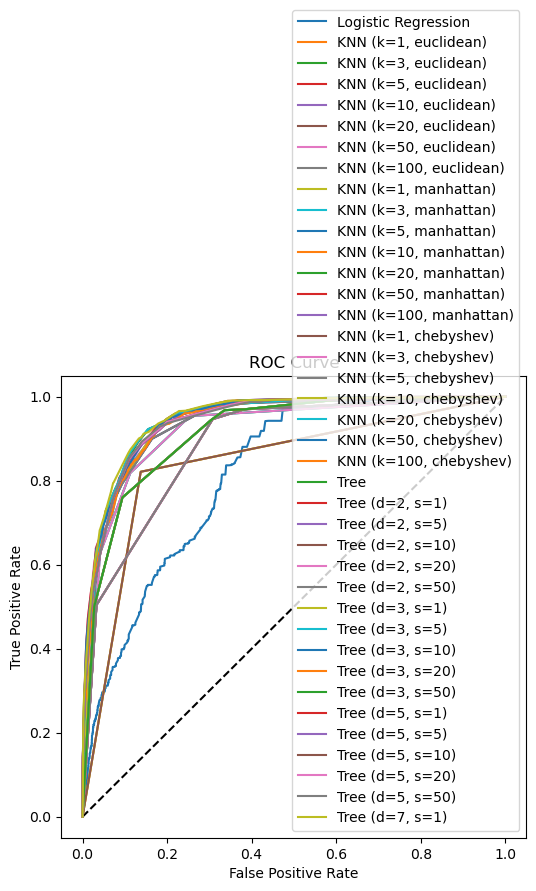


Testing Decision Tree with max_depth=7, min_samples_leaf=5
Train F1 score: 0.8384
Test F1 score: 0.8301


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

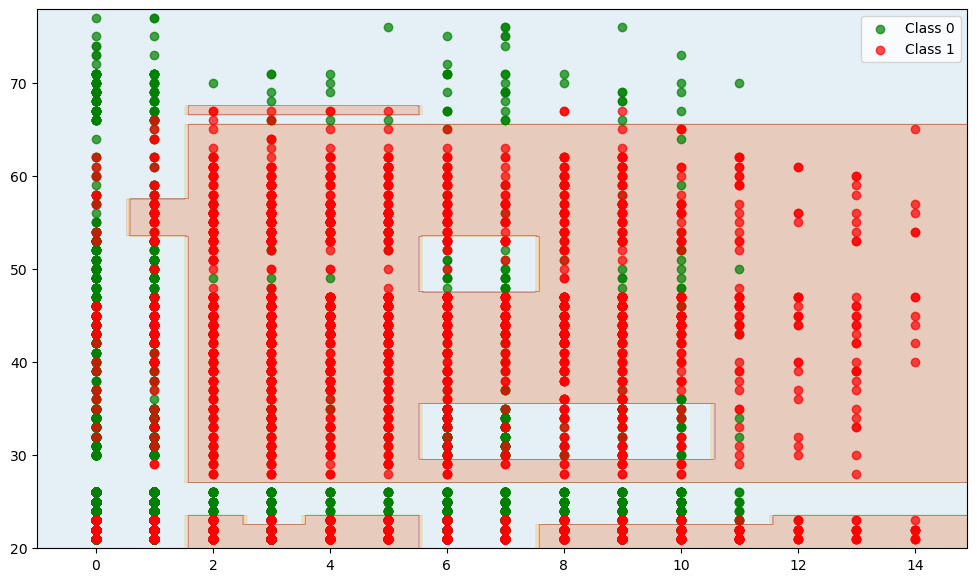

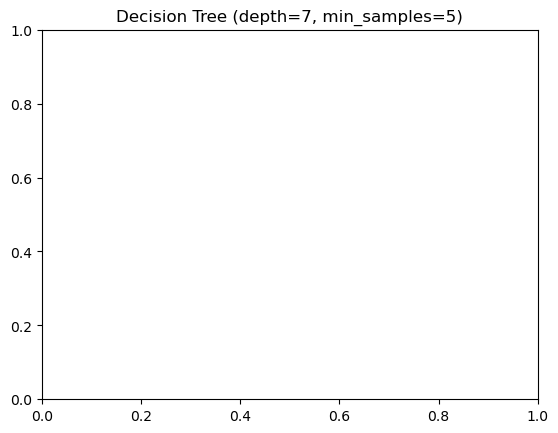

              precision    recall  f1-score   support

           0       0.92      0.90      0.91      3000
           1       0.81      0.85      0.83      1500

    accuracy                           0.88      4500
   macro avg       0.87      0.88      0.87      4500
weighted avg       0.89      0.88      0.88      4500



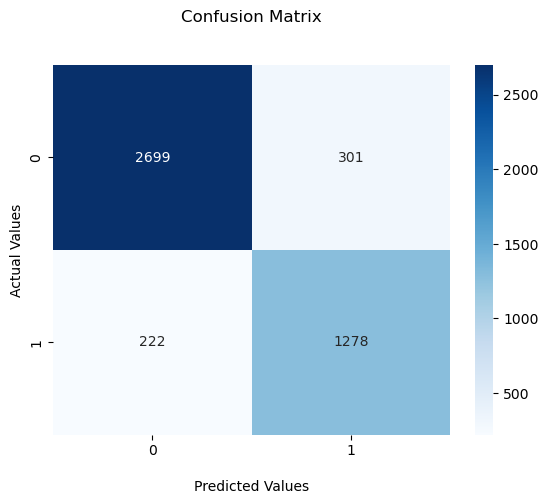

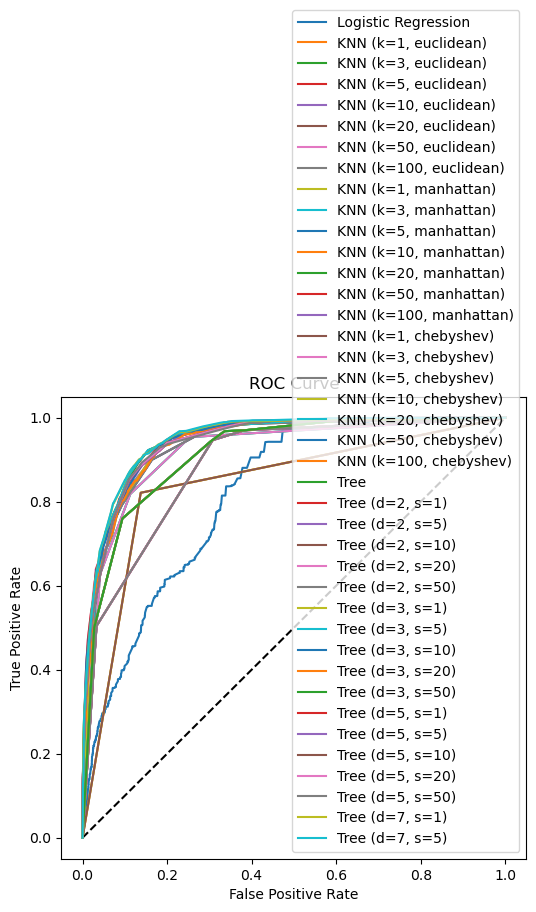


Testing Decision Tree with max_depth=7, min_samples_leaf=10
Train F1 score: 0.8373
Test F1 score: 0.8282


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

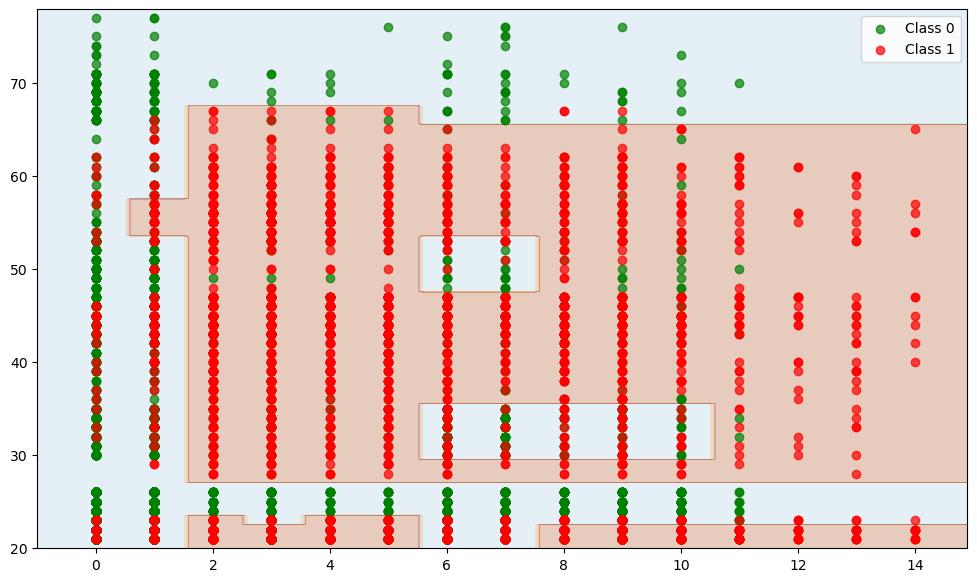

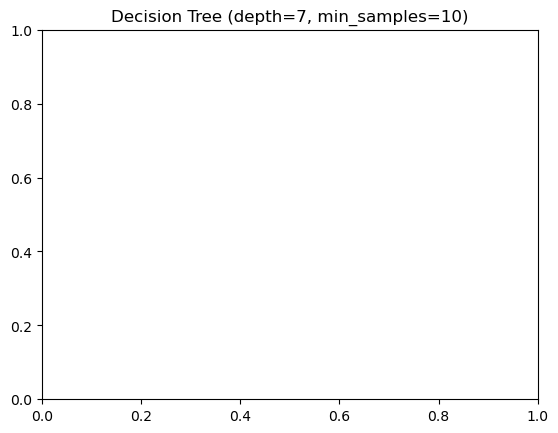

              precision    recall  f1-score   support

           0       0.92      0.90      0.91      3000
           1       0.81      0.85      0.83      1500

    accuracy                           0.88      4500
   macro avg       0.87      0.87      0.87      4500
weighted avg       0.88      0.88      0.88      4500



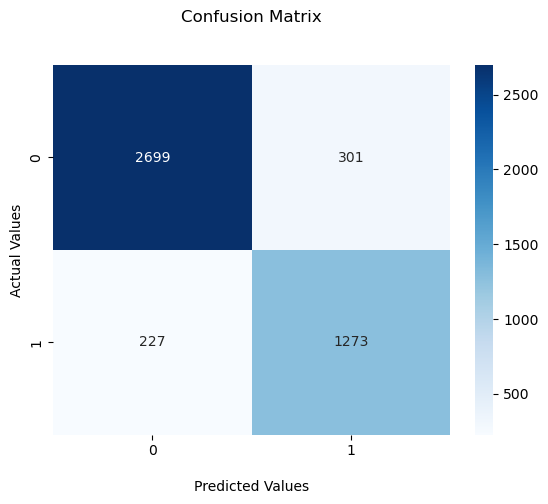

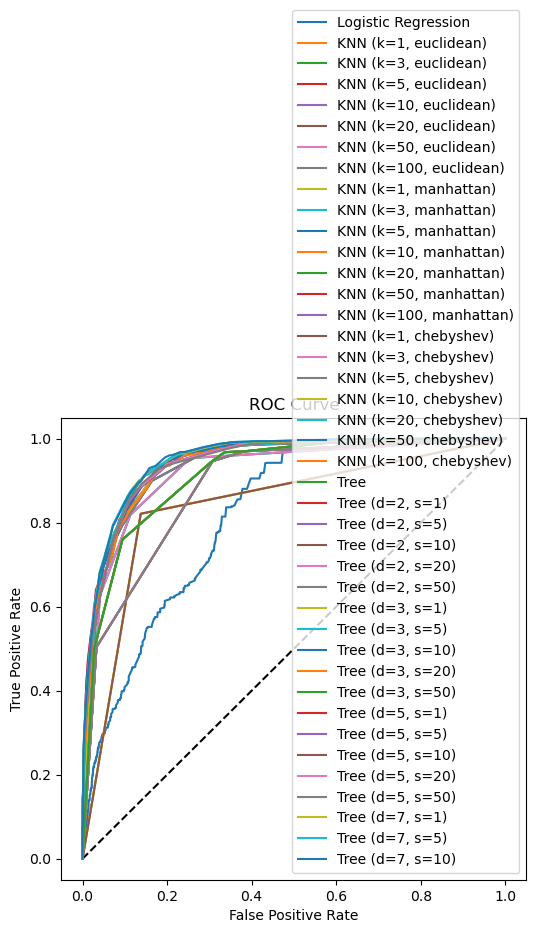


Testing Decision Tree with max_depth=7, min_samples_leaf=20
Train F1 score: 0.8345
Test F1 score: 0.8255


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

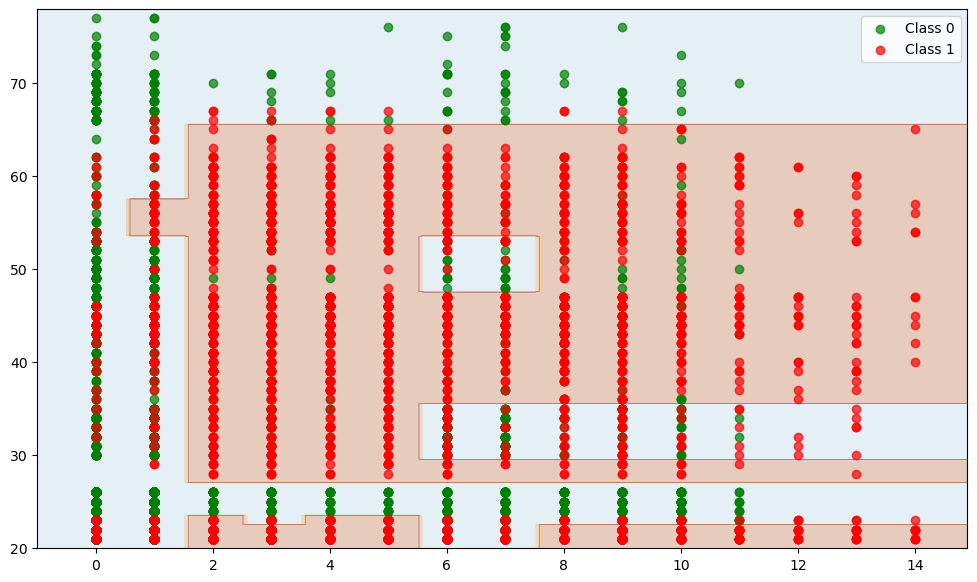

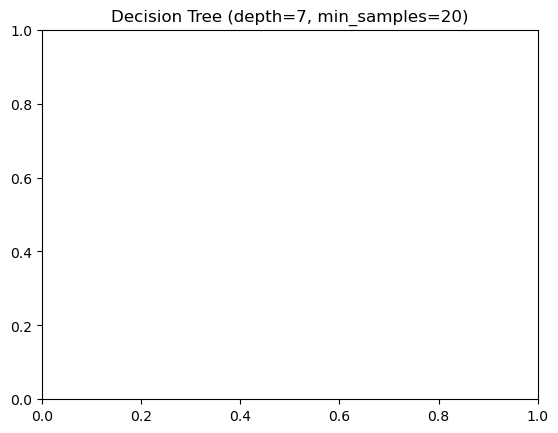

              precision    recall  f1-score   support

           0       0.92      0.90      0.91      3000
           1       0.81      0.84      0.83      1500

    accuracy                           0.88      4500
   macro avg       0.86      0.87      0.87      4500
weighted avg       0.88      0.88      0.88      4500



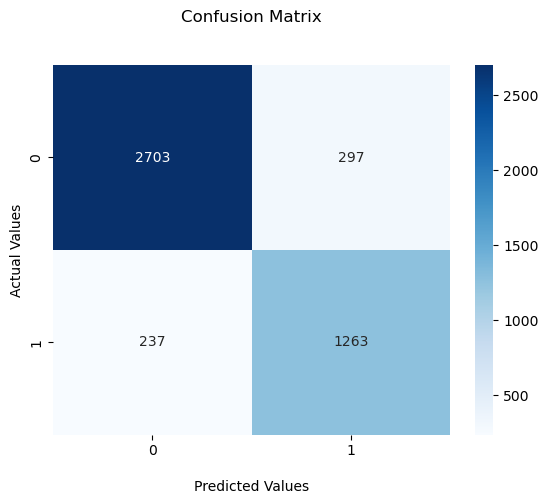

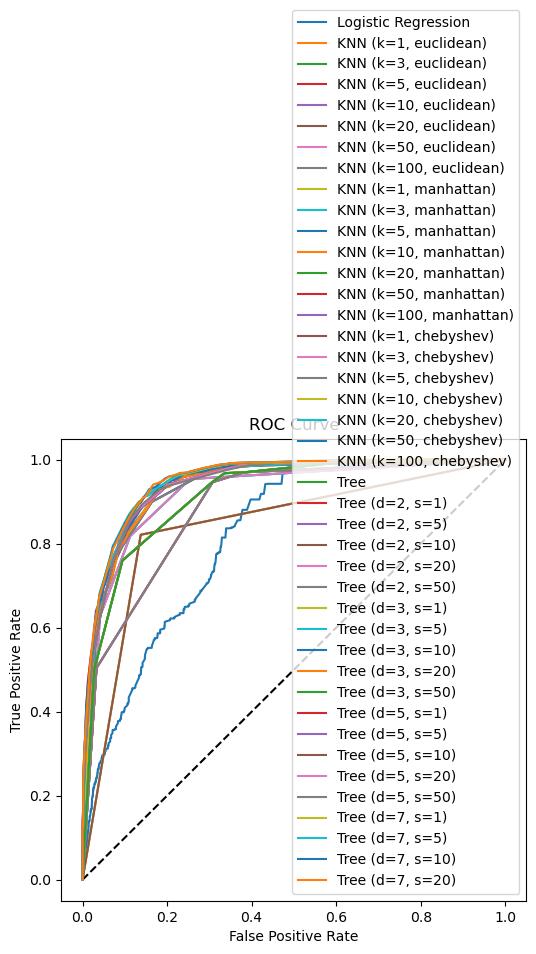


Testing Decision Tree with max_depth=7, min_samples_leaf=50
Train F1 score: 0.8325
Test F1 score: 0.8200


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

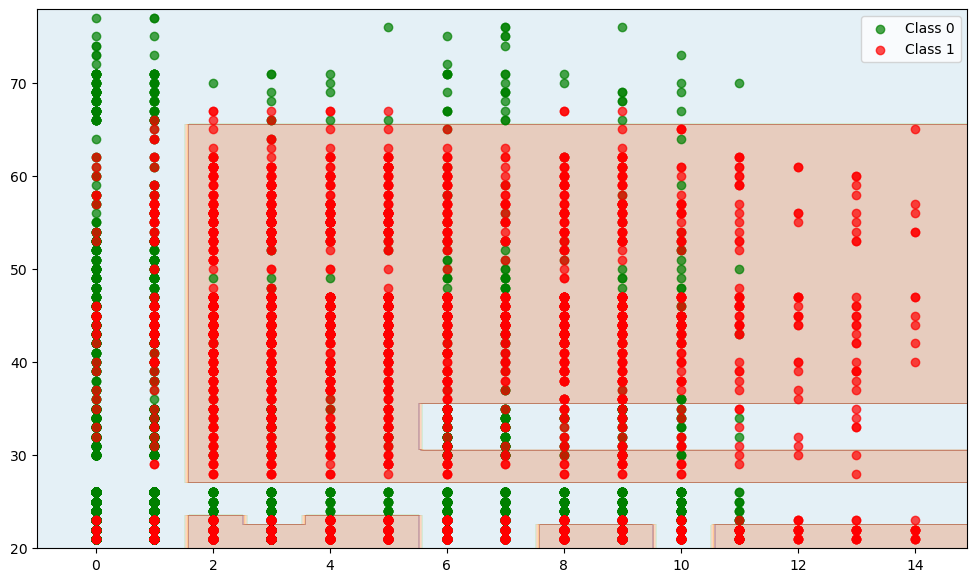

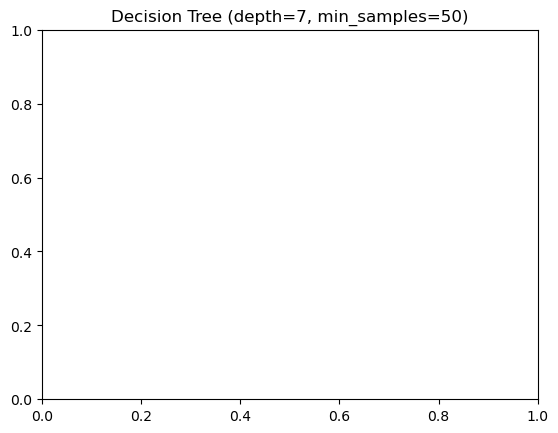

              precision    recall  f1-score   support

           0       0.91      0.90      0.91      3000
           1       0.81      0.83      0.82      1500

    accuracy                           0.88      4500
   macro avg       0.86      0.87      0.86      4500
weighted avg       0.88      0.88      0.88      4500



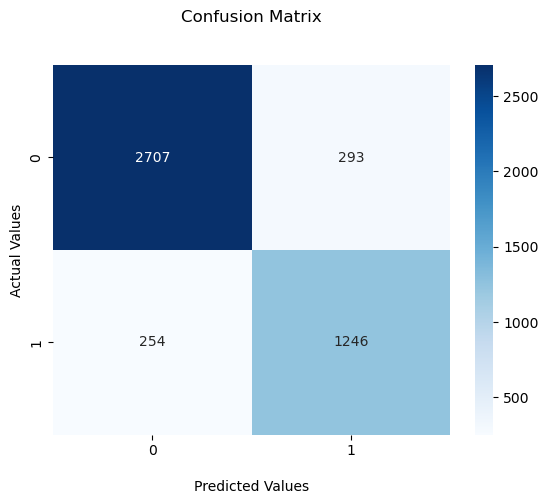

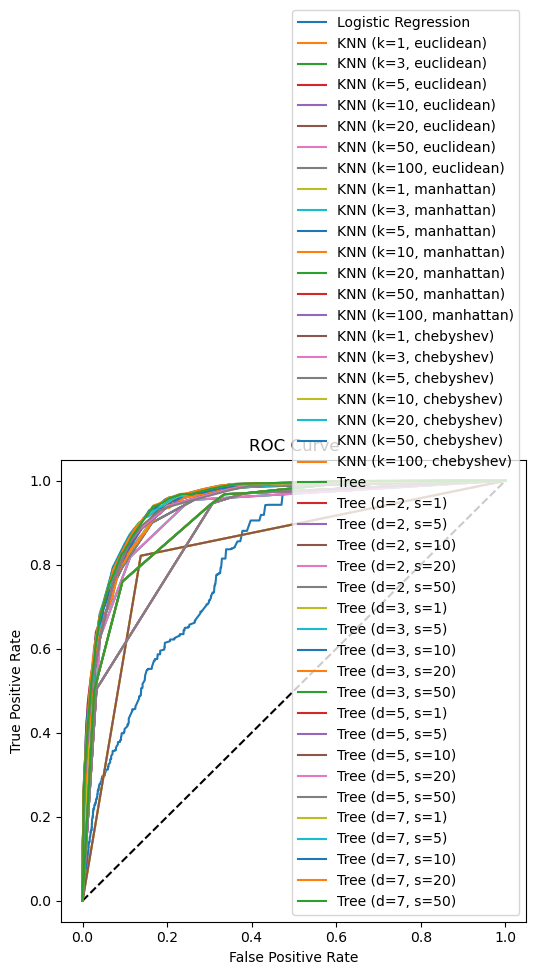


Testing Decision Tree with max_depth=10, min_samples_leaf=1
Train F1 score: 0.8453
Test F1 score: 0.8281


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

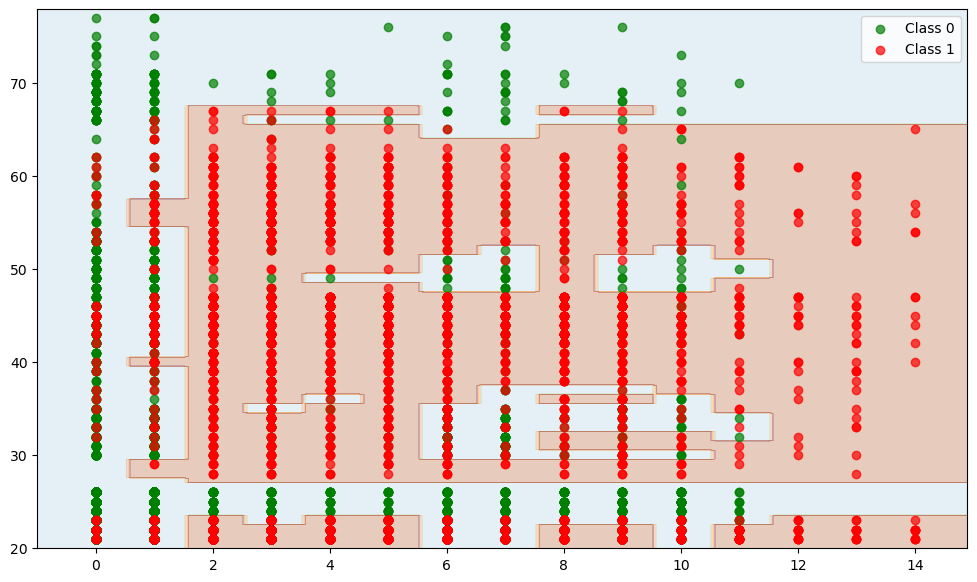

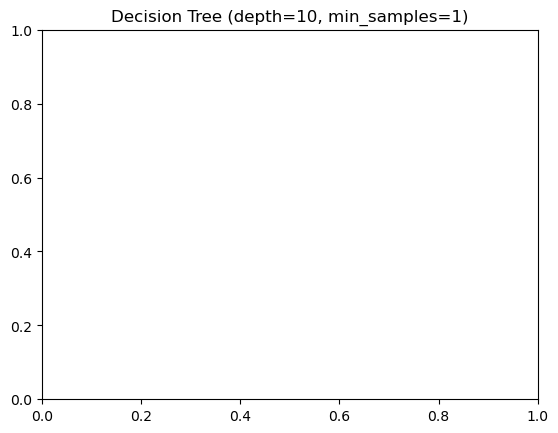

              precision    recall  f1-score   support

           0       0.92      0.91      0.91      3000
           1       0.82      0.84      0.83      1500

    accuracy                           0.88      4500
   macro avg       0.87      0.87      0.87      4500
weighted avg       0.88      0.88      0.88      4500



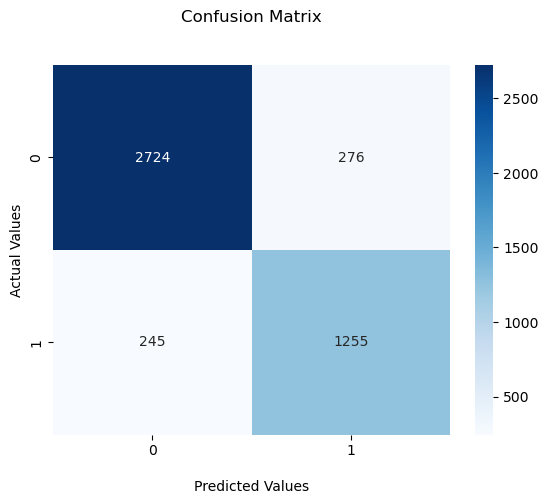

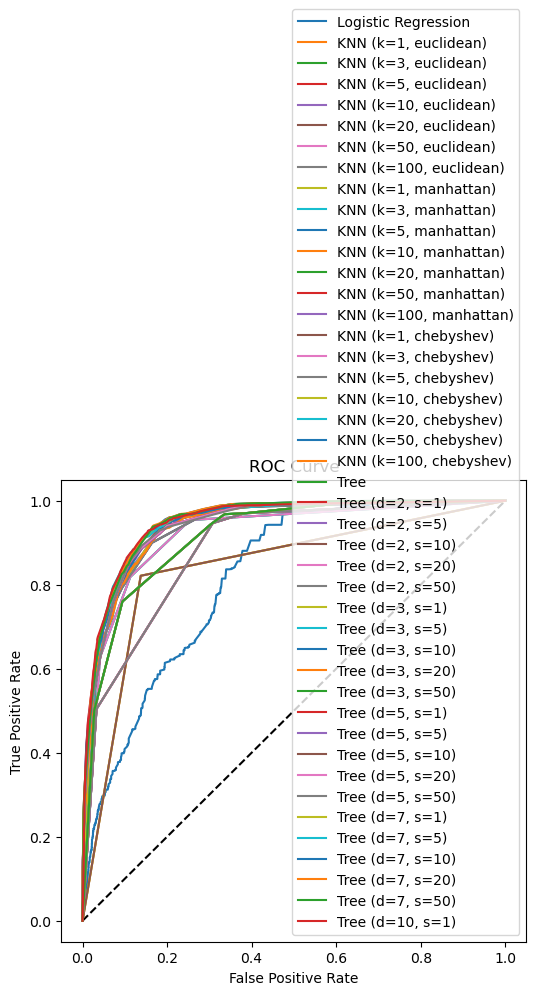


Testing Decision Tree with max_depth=10, min_samples_leaf=5
Train F1 score: 0.8434
Test F1 score: 0.8301


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

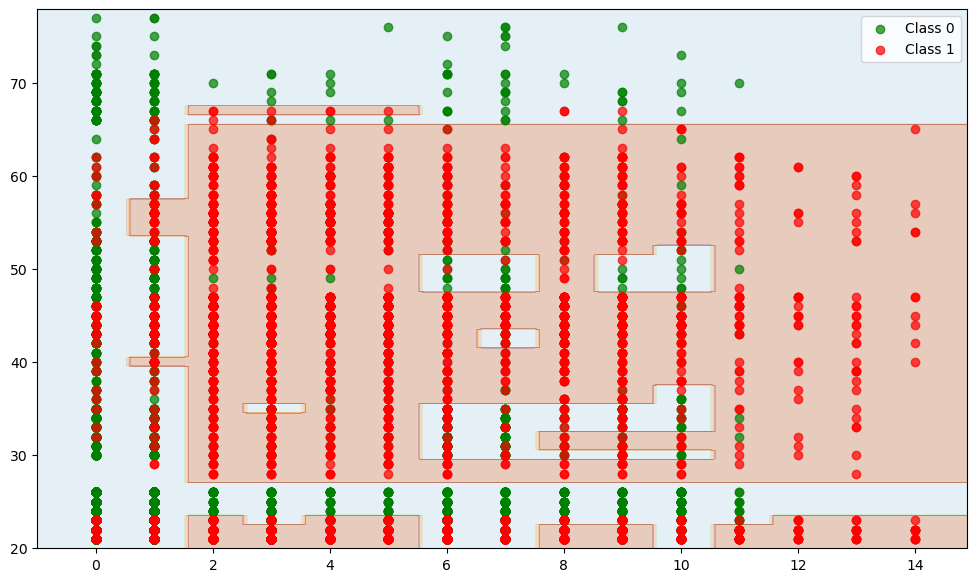

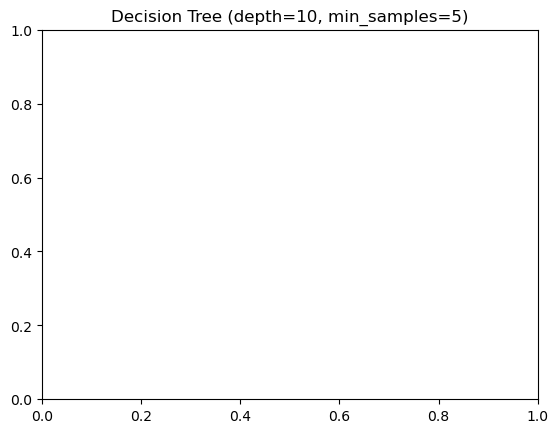

              precision    recall  f1-score   support

           0       0.92      0.91      0.91      3000
           1       0.82      0.84      0.83      1500

    accuracy                           0.89      4500
   macro avg       0.87      0.87      0.87      4500
weighted avg       0.89      0.89      0.89      4500



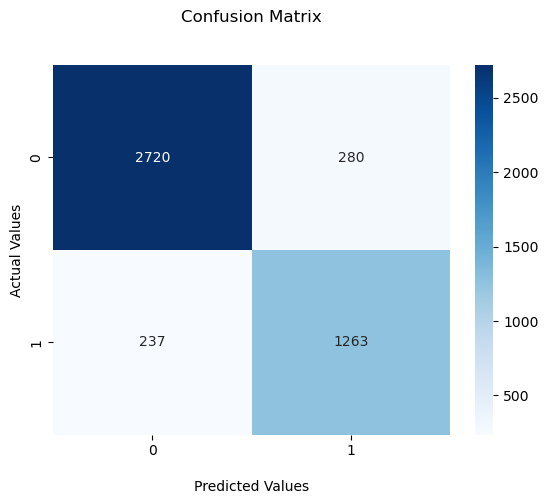

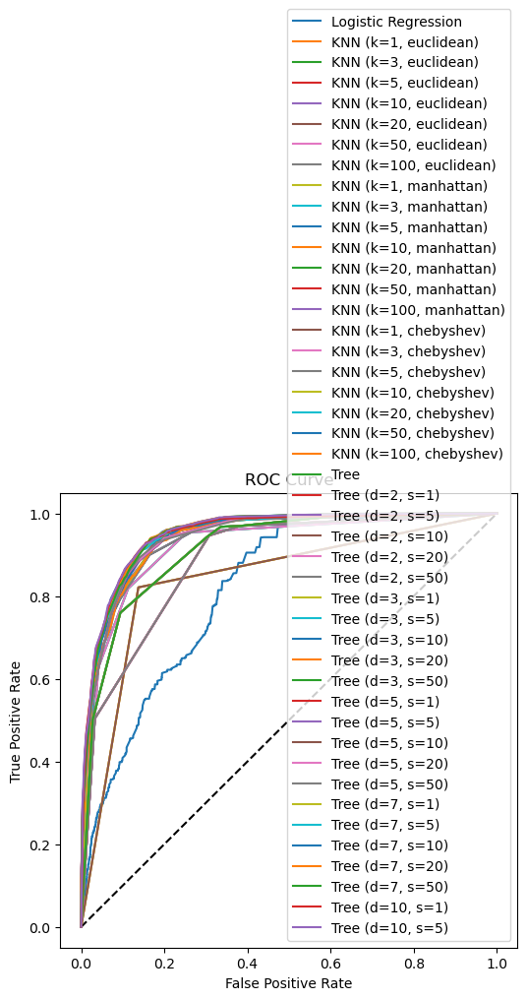


Testing Decision Tree with max_depth=10, min_samples_leaf=10
Train F1 score: 0.8417
Test F1 score: 0.8324


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

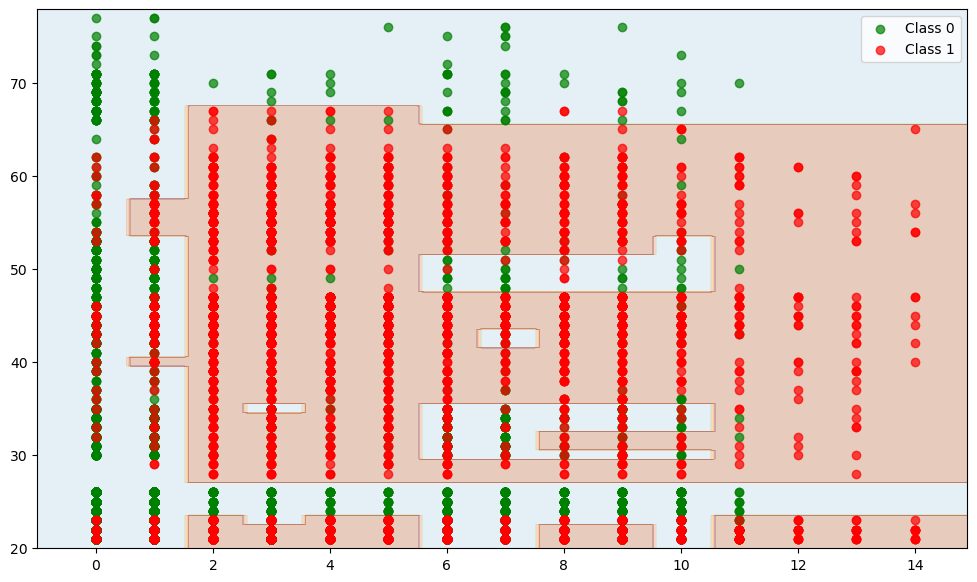

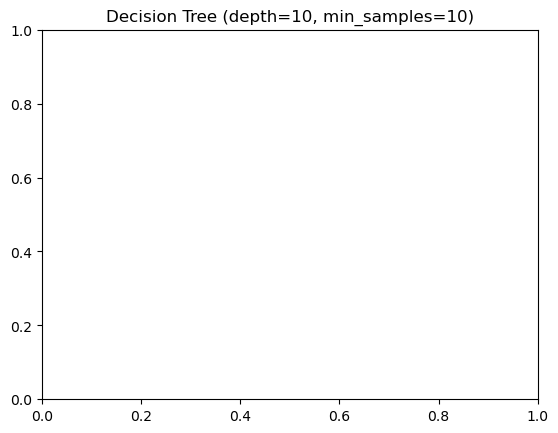

              precision    recall  f1-score   support

           0       0.92      0.91      0.91      3000
           1       0.82      0.85      0.83      1500

    accuracy                           0.89      4500
   macro avg       0.87      0.88      0.87      4500
weighted avg       0.89      0.89      0.89      4500



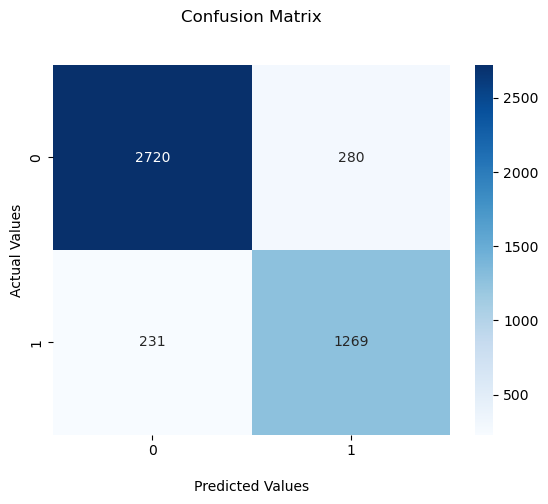

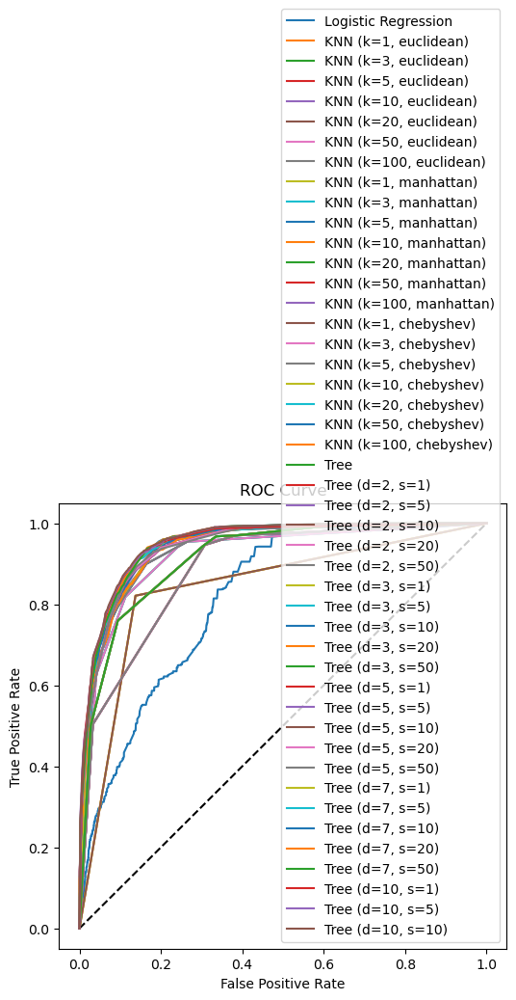


Testing Decision Tree with max_depth=10, min_samples_leaf=20
Train F1 score: 0.8366
Test F1 score: 0.8214


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

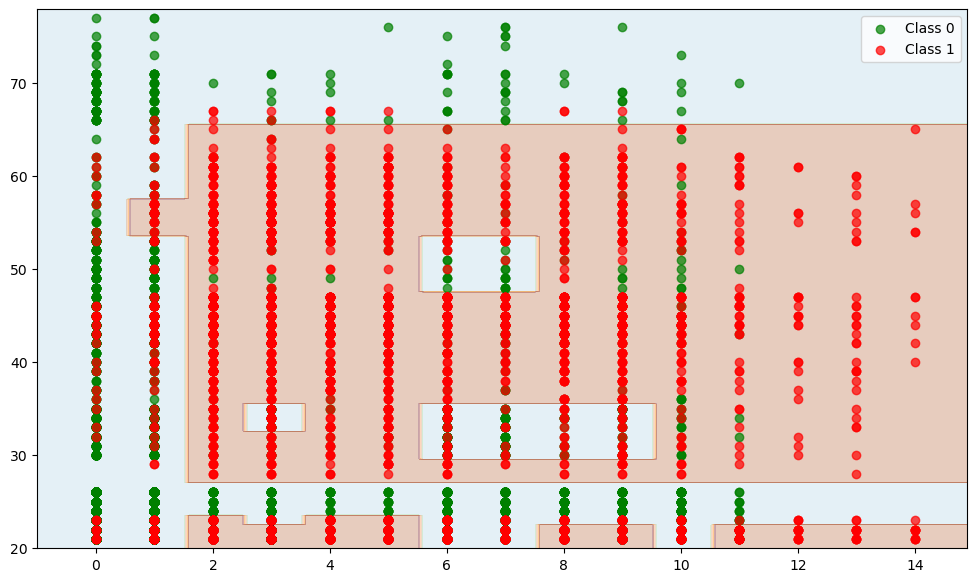

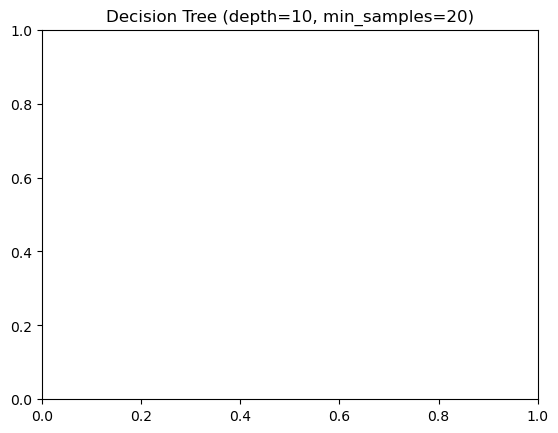

              precision    recall  f1-score   support

           0       0.91      0.91      0.91      3000
           1       0.82      0.82      0.82      1500

    accuracy                           0.88      4500
   macro avg       0.87      0.87      0.87      4500
weighted avg       0.88      0.88      0.88      4500



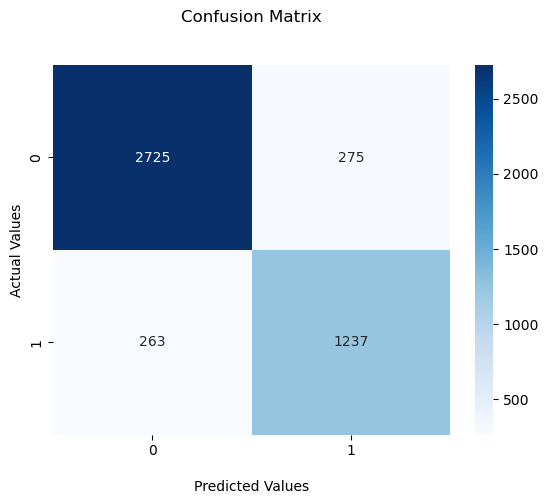

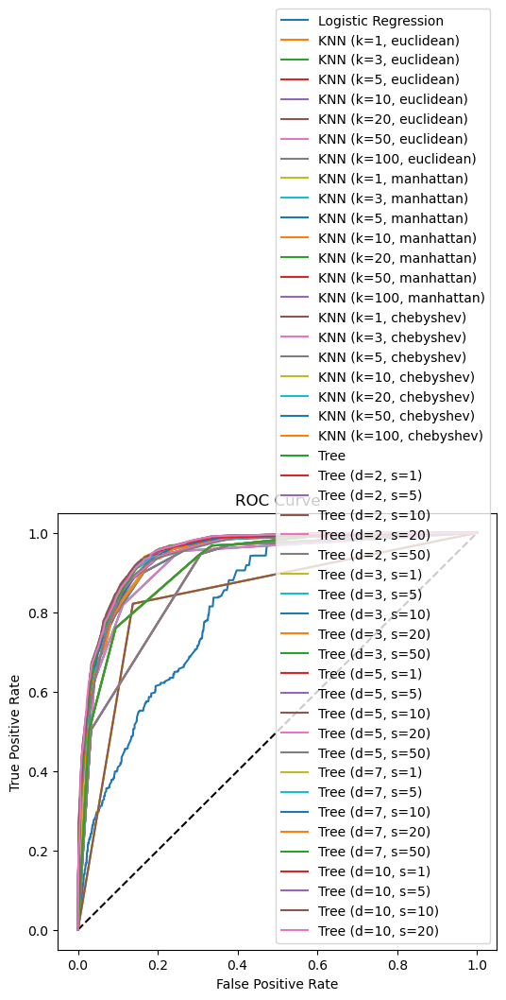


Testing Decision Tree with max_depth=10, min_samples_leaf=50
Train F1 score: 0.8325
Test F1 score: 0.8200


C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names


<Figure size 1000x600 with 0 Axes>

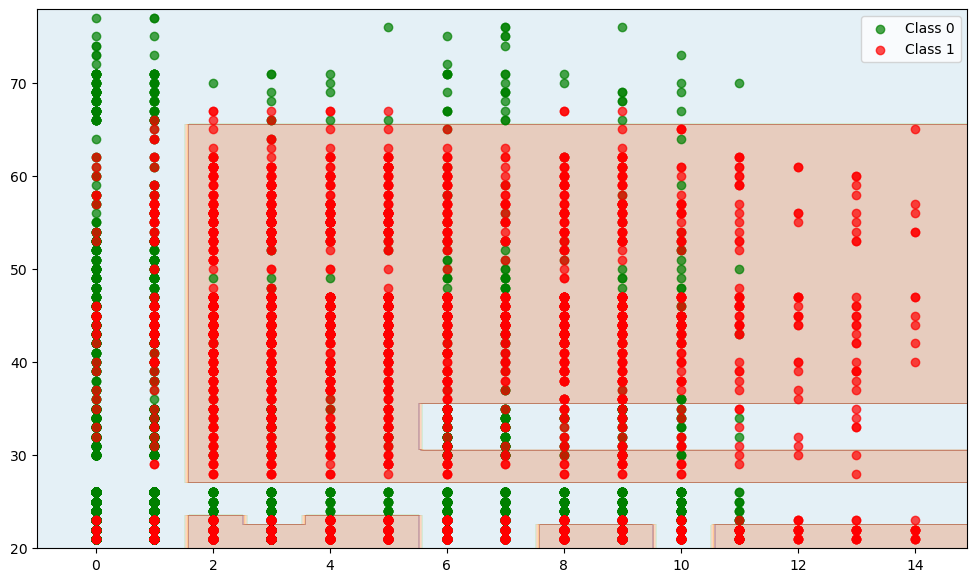

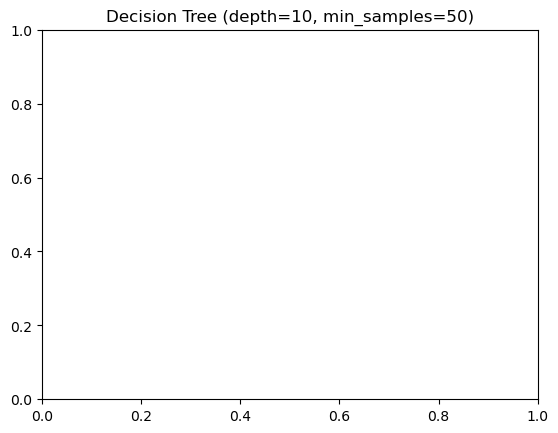

              precision    recall  f1-score   support

           0       0.91      0.90      0.91      3000
           1       0.81      0.83      0.82      1500

    accuracy                           0.88      4500
   macro avg       0.86      0.87      0.86      4500
weighted avg       0.88      0.88      0.88      4500



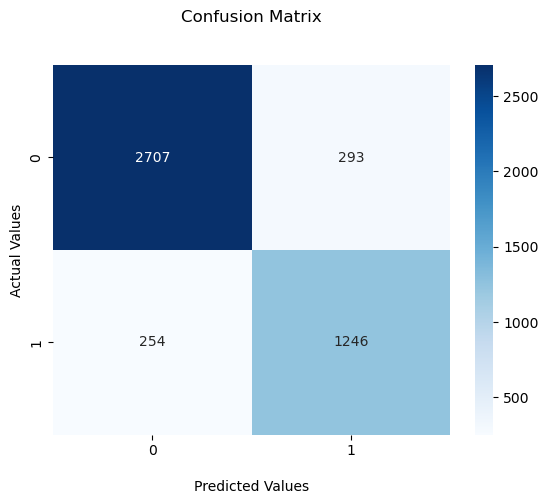

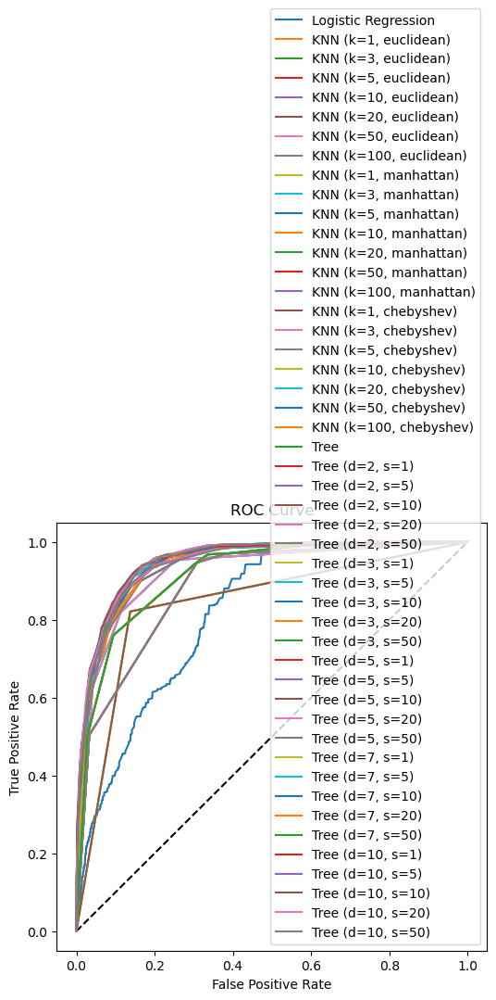

In [86]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score
import matplotlib.pyplot as plt

# Różne wartości parametrów do przetestowania
max_depth_values = [2, 3, 5, 7, 10]
min_samples_leaf_values = [1, 5, 10, 20, 50]

for depth in max_depth_values:
    for min_samples in min_samples_leaf_values:
        print(f"\n{'='*50}")
        print(f"Testing Decision Tree with max_depth={depth}, min_samples_leaf={min_samples}")
        print(f"{'='*50}")
        
        # Tworzenie i trenowanie modelu
        model_tree = DecisionTreeClassifier(max_depth=depth, 
                                          min_samples_leaf=min_samples,
                                          random_state=0)
        model_tree.fit(X_train, y_train)
        
        # Predykcje i obliczenie F1 score
        y_train_pred = model_tree.predict(X_train)
        y_test_pred = model_tree.predict(X_test)
        
        f1_train = f1_score(y_train, y_train_pred)
        f1_test = f1_score(y_test, y_test_pred)
        
        print(f"Train F1 score: {f1_train:.4f}")
        print(f"Test F1 score: {f1_test:.4f}")
        
        # Wizualizacja powierzchni decyzyjnej
        plt.figure(figsize=(10, 6))
        plot_classification_surface(X_plot=np.array(X_train), 
                                  y_plot=y_train, 
                                  trained_model=model_tree)
        plt.title(f'Decision Tree (depth={depth}, min_samples={min_samples})')
        plt.show()
        
        # Obliczenie i wyświetlenie innych metryk
        calculate_metrics(model_tree, 
                        f'Tree (d={depth}, s={min_samples})', 
                        X_test, y_test)

### SVM (Support Vector Machines) - Maszyna wektorów nośnych

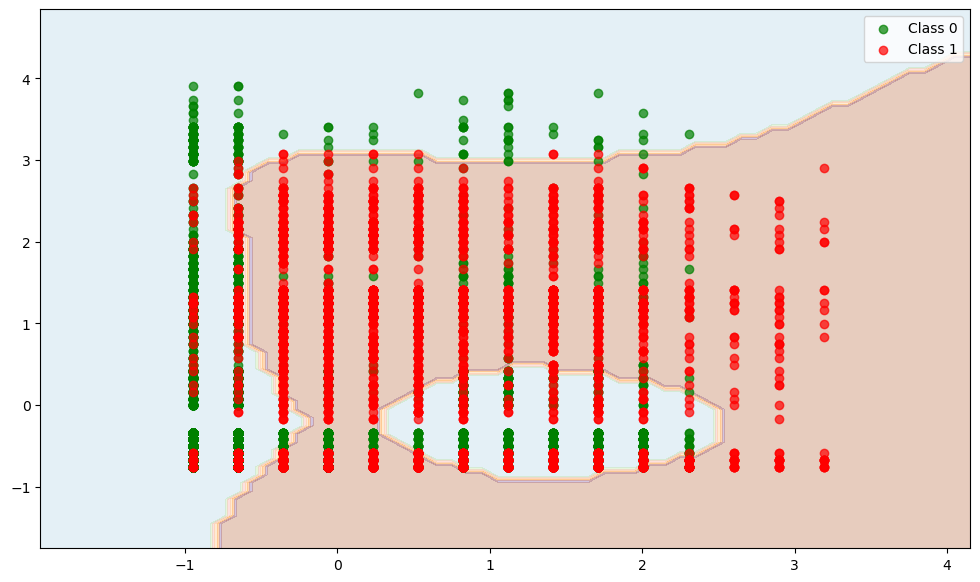

In [88]:
from sklearn.svm import SVC

model_svm = SVC(kernel='rbf', probability=True)
model_svm.fit(X_train_standardized, y_train)
plot_classification_surface(X_plot=X_train_standardized, y_plot=y_train, trained_model=model_svm)

### Ćwiczenie
Sprawdź, jak zachowuje się model dla różnego hiperparametru C oraz różnych kerneli. Zwizualizuj działanie modelu z wykorzystaniem funkcji plot_classification_surface oraz za każdym razem oblicz F1_score na zbiorze treningowym oraz testowym.


Testing SVM with kernel='linear', C=0.1
Train F1 score: 0.5750
Test F1 score: 0.5889


<Figure size 1000x600 with 0 Axes>

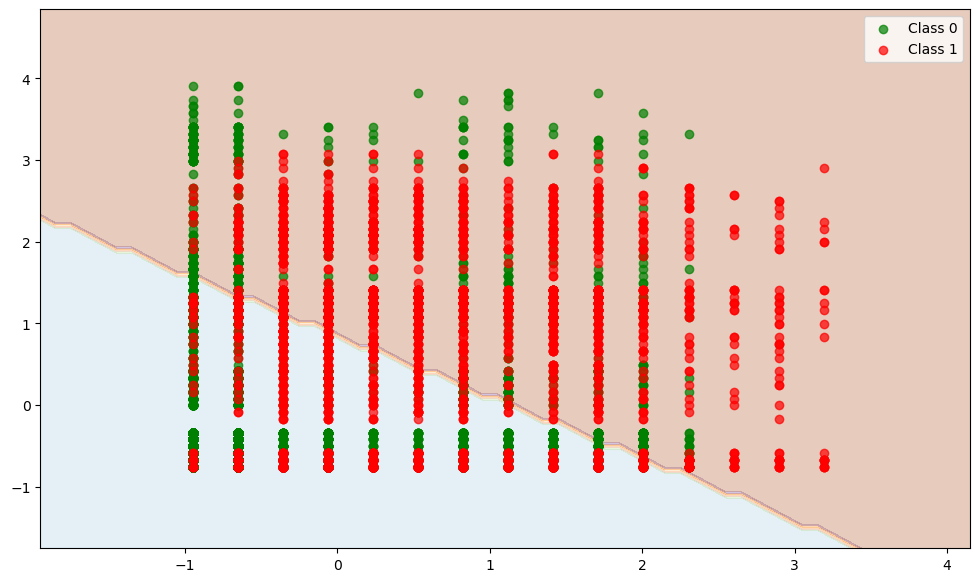

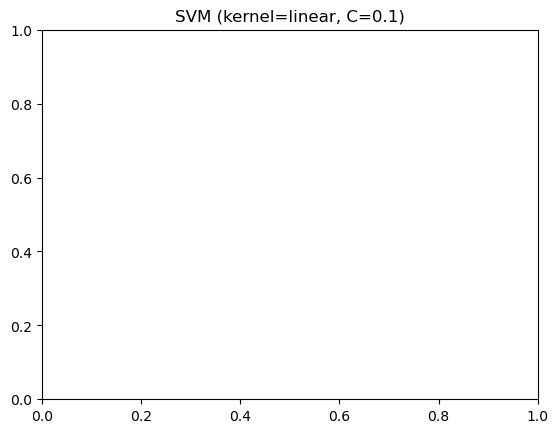

              precision    recall  f1-score   support

           0       0.79      0.88      0.83      3000
           1       0.68      0.52      0.59      1500

    accuracy                           0.76      4500
   macro avg       0.73      0.70      0.71      4500
weighted avg       0.75      0.76      0.75      4500



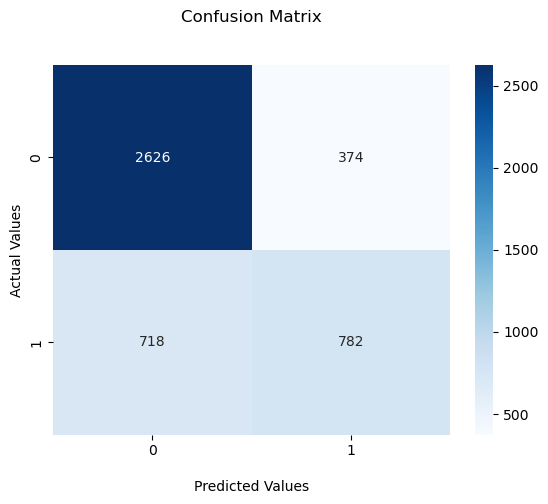

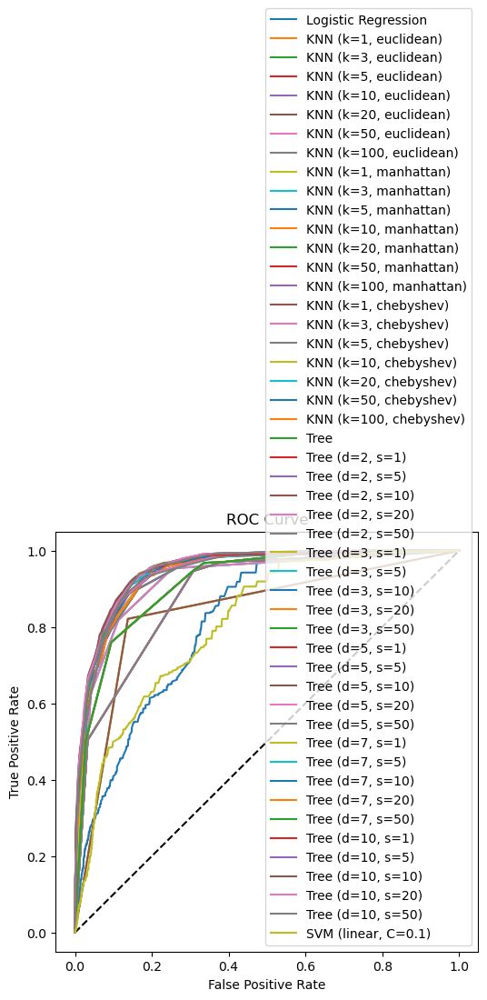


Testing SVM with kernel='linear', C=1
Train F1 score: 0.5732
Test F1 score: 0.5889


<Figure size 1000x600 with 0 Axes>

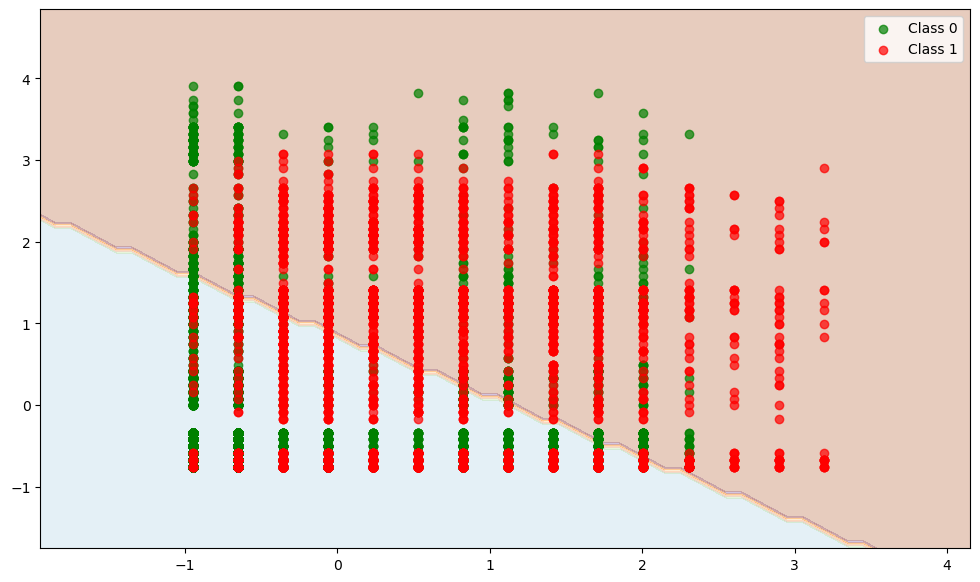

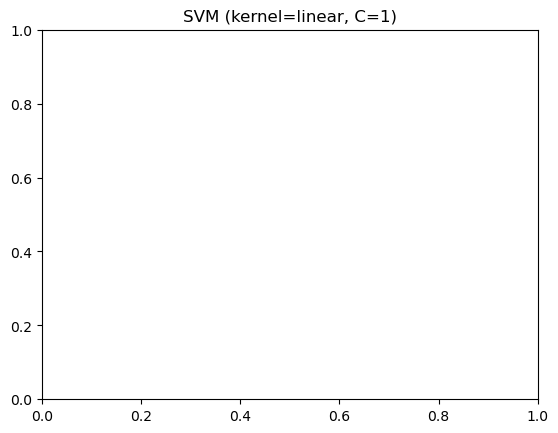

              precision    recall  f1-score   support

           0       0.78      0.88      0.83      3000
           1       0.68      0.52      0.59      1500

    accuracy                           0.76      4500
   macro avg       0.73      0.70      0.71      4500
weighted avg       0.75      0.76      0.75      4500



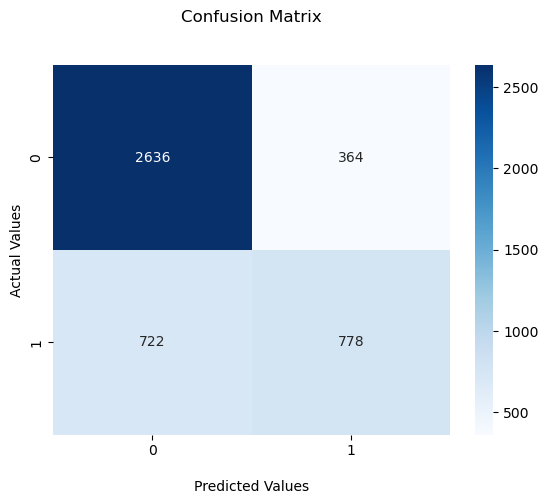

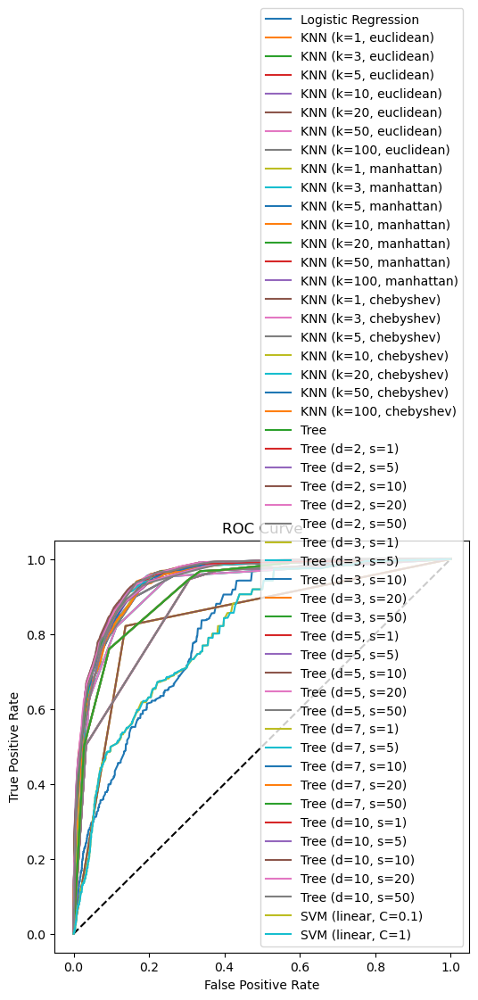


Testing SVM with kernel='linear', C=10
Train F1 score: 0.5732
Test F1 score: 0.5889


<Figure size 1000x600 with 0 Axes>

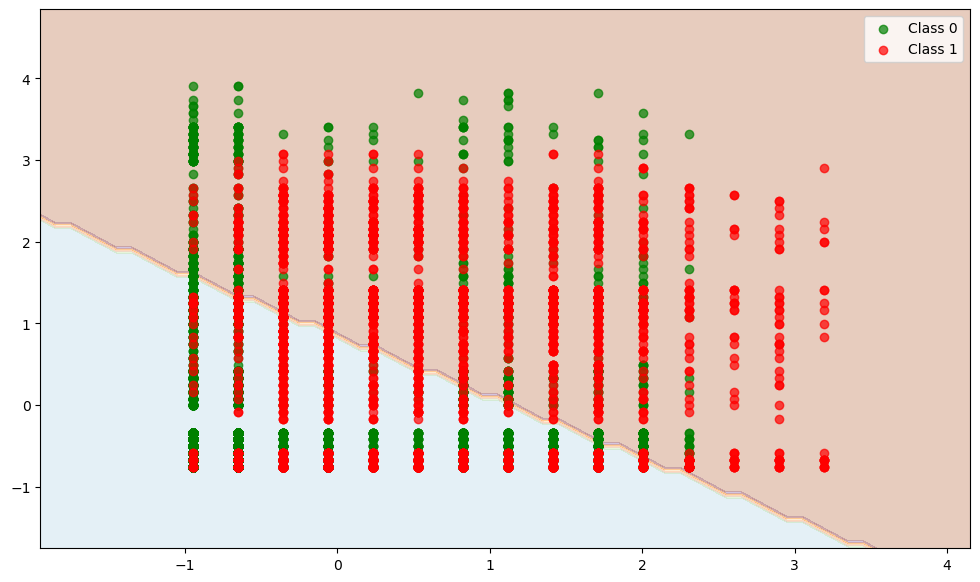

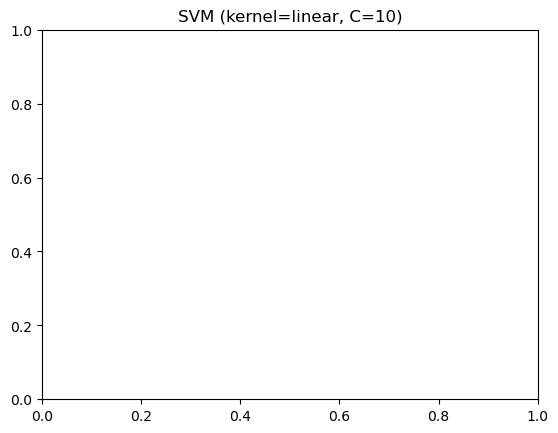

              precision    recall  f1-score   support

           0       0.78      0.88      0.83      3000
           1       0.68      0.52      0.59      1500

    accuracy                           0.76      4500
   macro avg       0.73      0.70      0.71      4500
weighted avg       0.75      0.76      0.75      4500



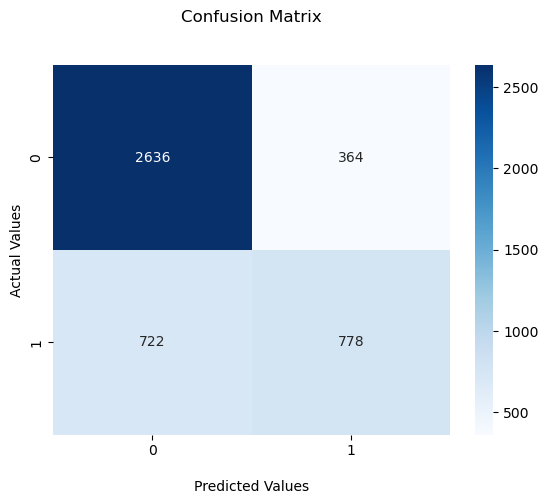

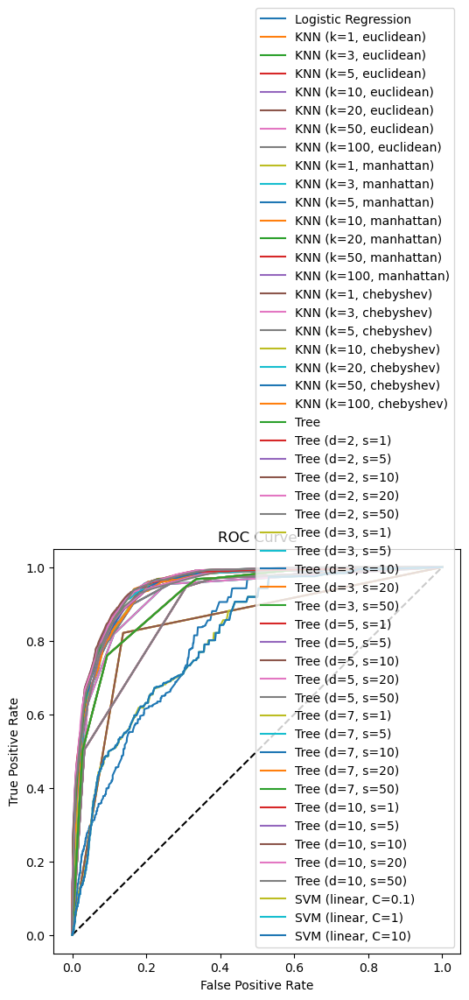


Testing SVM with kernel='linear', C=100
Train F1 score: 0.5721
Test F1 score: 0.5867


<Figure size 1000x600 with 0 Axes>

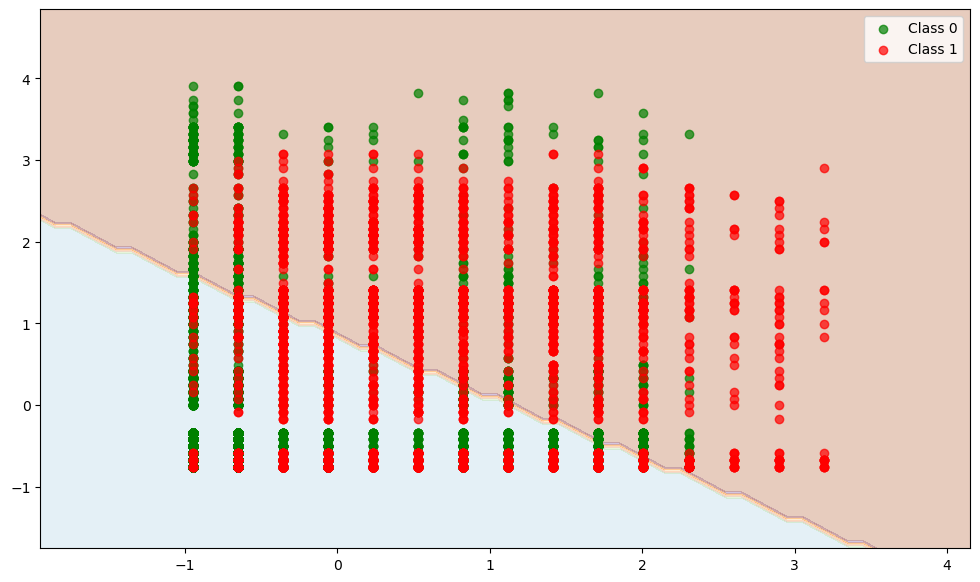

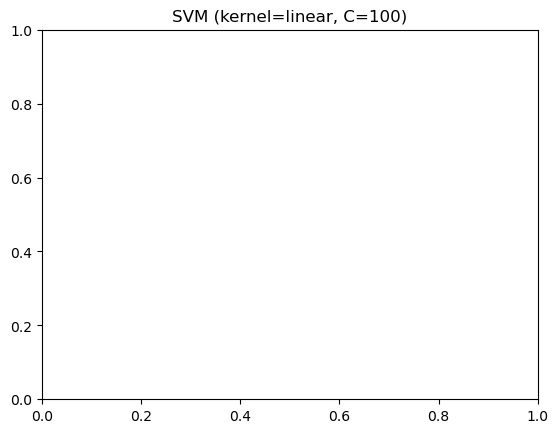

              precision    recall  f1-score   support

           0       0.78      0.88      0.83      3000
           1       0.68      0.52      0.59      1500

    accuracy                           0.76      4500
   macro avg       0.73      0.70      0.71      4500
weighted avg       0.75      0.76      0.75      4500



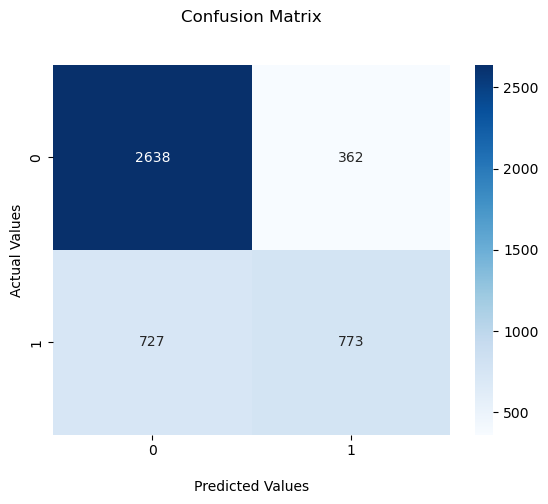

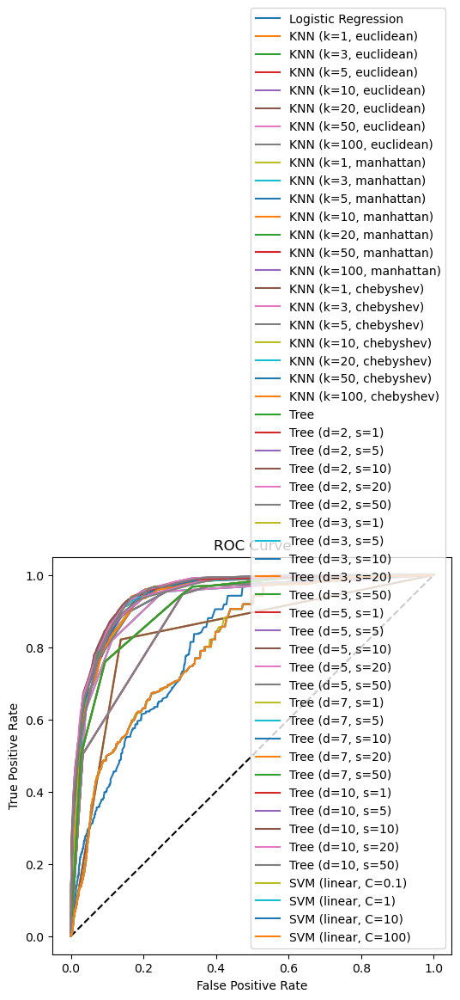


Testing SVM with kernel='poly', C=0.1
Train F1 score: 0.3058
Test F1 score: 0.3372


<Figure size 1000x600 with 0 Axes>

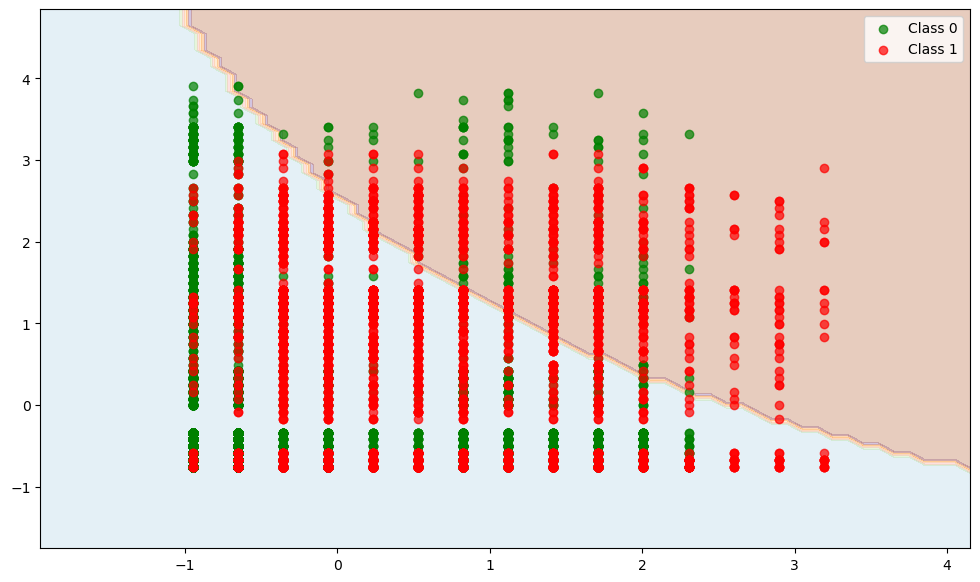

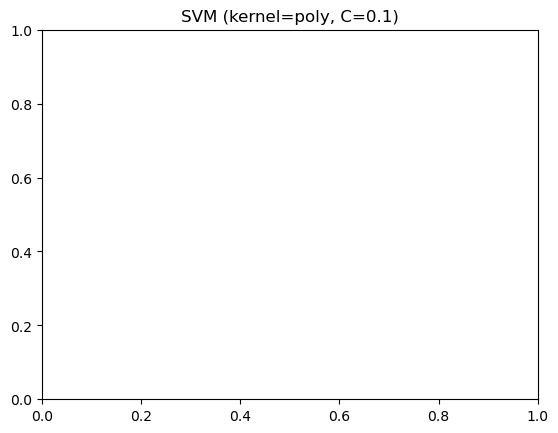

              precision    recall  f1-score   support

           0       0.71      0.98      0.82      3000
           1       0.81      0.21      0.34      1500

    accuracy                           0.72      4500
   macro avg       0.76      0.59      0.58      4500
weighted avg       0.75      0.72      0.66      4500



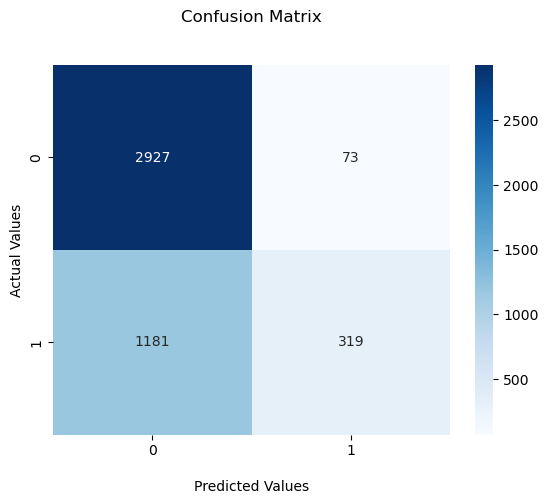

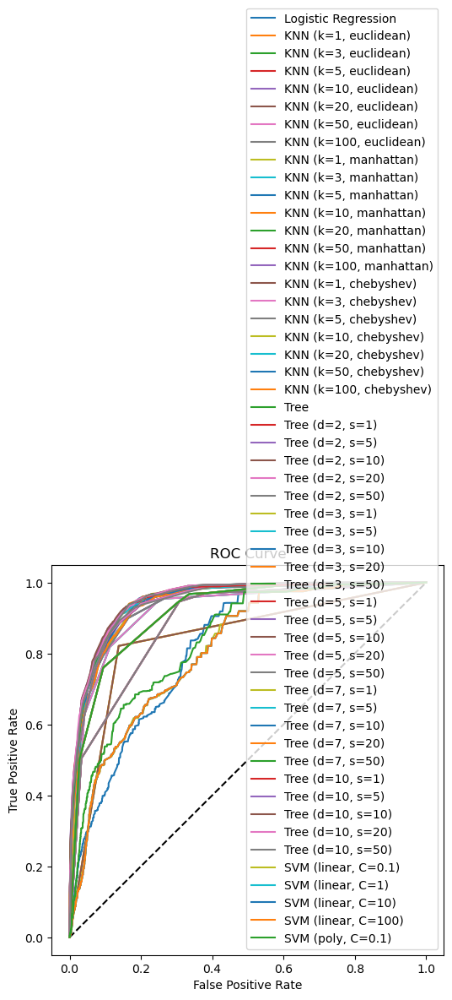


Testing SVM with kernel='poly', C=1
Train F1 score: 0.3093
Test F1 score: 0.3379


<Figure size 1000x600 with 0 Axes>

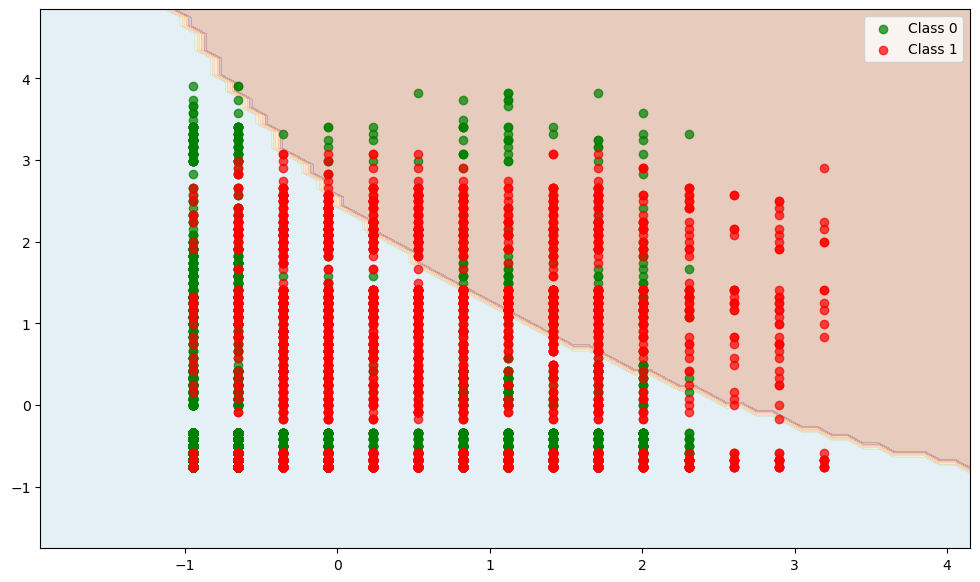

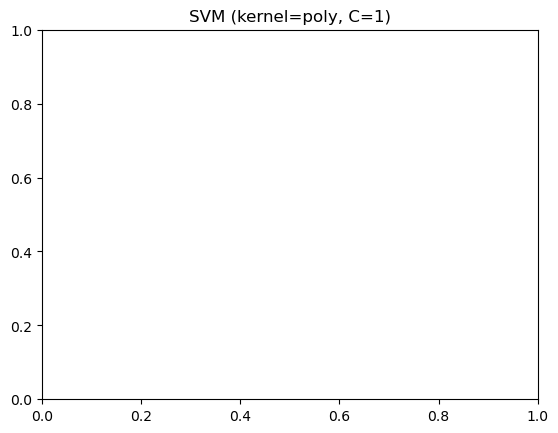

              precision    recall  f1-score   support

           0       0.71      0.98      0.82      3000
           1       0.81      0.21      0.34      1500

    accuracy                           0.72      4500
   macro avg       0.76      0.59      0.58      4500
weighted avg       0.75      0.72      0.66      4500



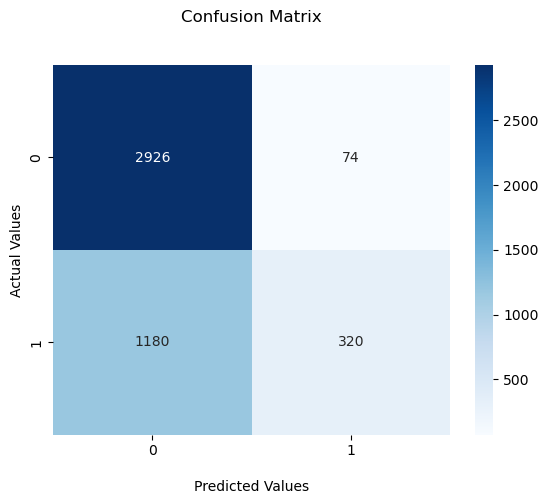

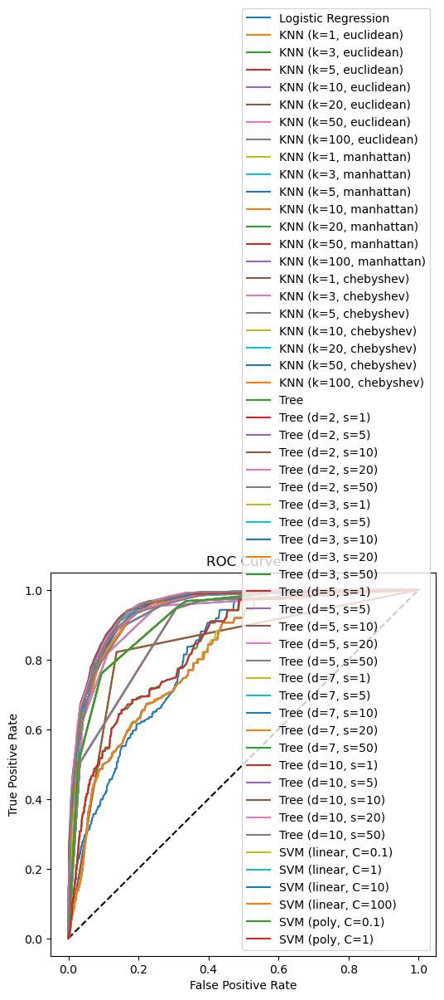


Testing SVM with kernel='poly', C=10
Train F1 score: 0.3089
Test F1 score: 0.3379


<Figure size 1000x600 with 0 Axes>

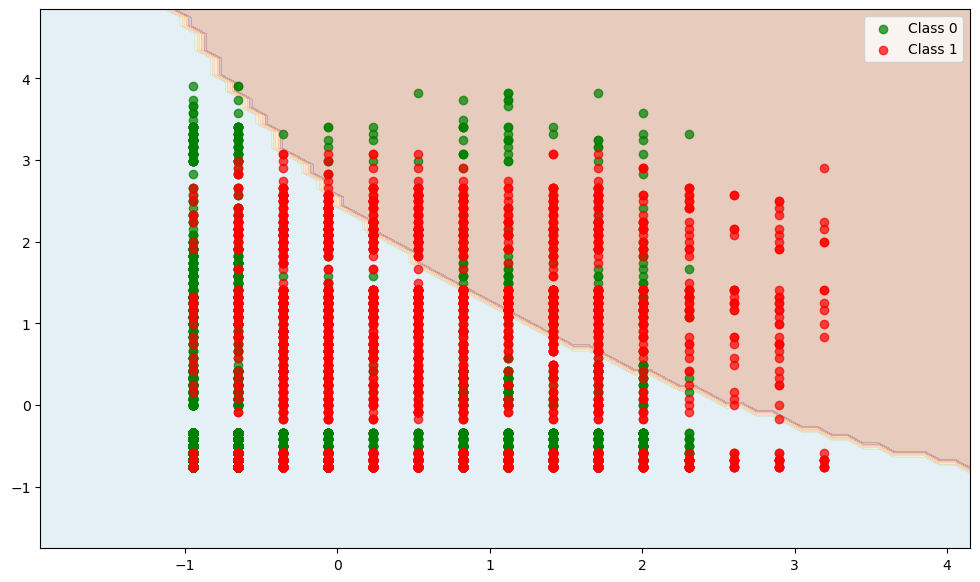

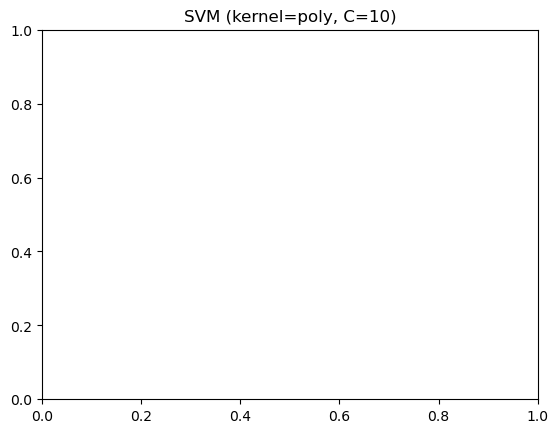

              precision    recall  f1-score   support

           0       0.71      0.98      0.82      3000
           1       0.81      0.21      0.34      1500

    accuracy                           0.72      4500
   macro avg       0.76      0.59      0.58      4500
weighted avg       0.75      0.72      0.66      4500



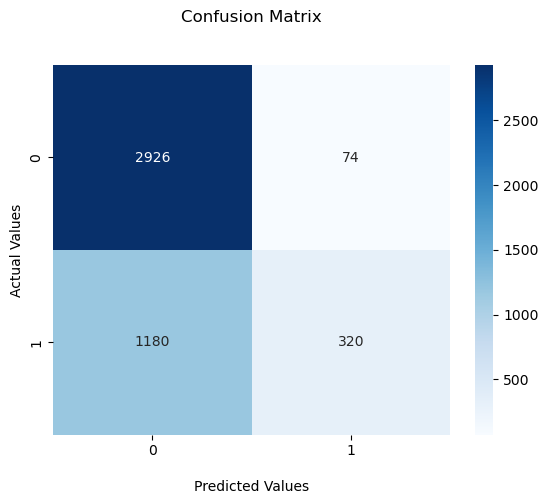

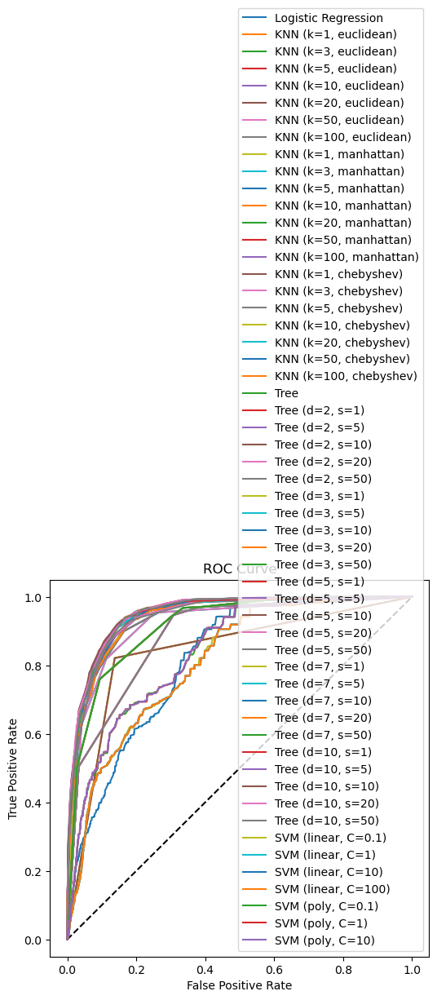


Testing SVM with kernel='poly', C=100
Train F1 score: 0.3058
Test F1 score: 0.3370


<Figure size 1000x600 with 0 Axes>

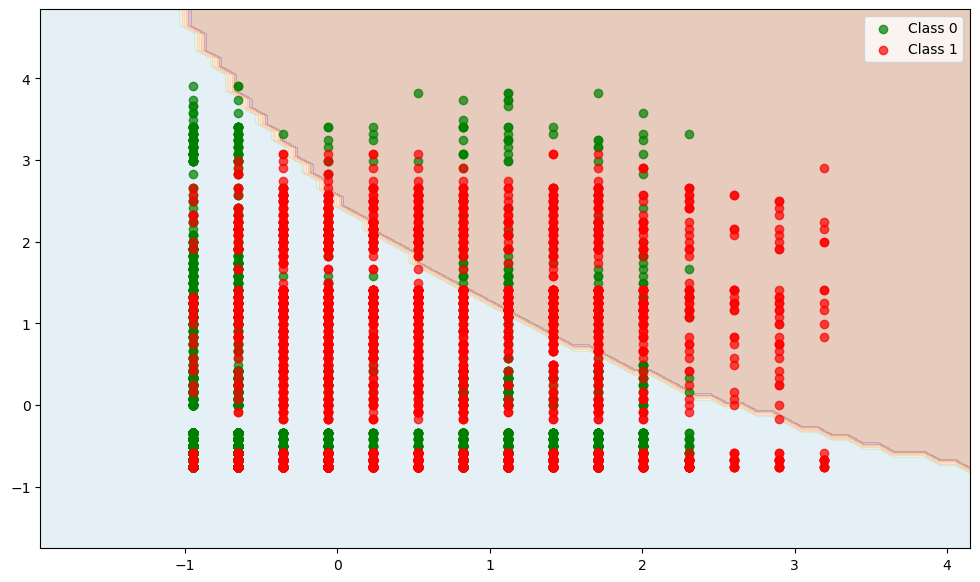

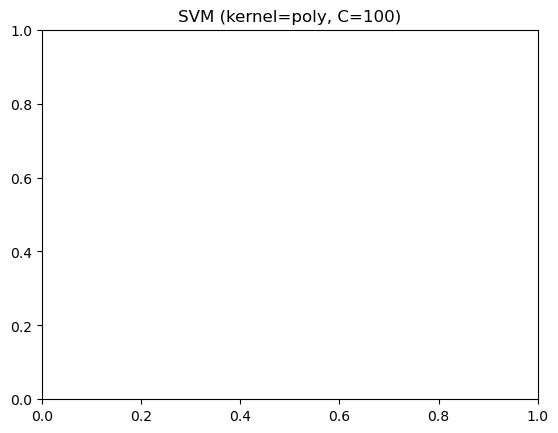

              precision    recall  f1-score   support

           0       0.71      0.98      0.82      3000
           1       0.81      0.21      0.34      1500

    accuracy                           0.72      4500
   macro avg       0.76      0.59      0.58      4500
weighted avg       0.75      0.72      0.66      4500



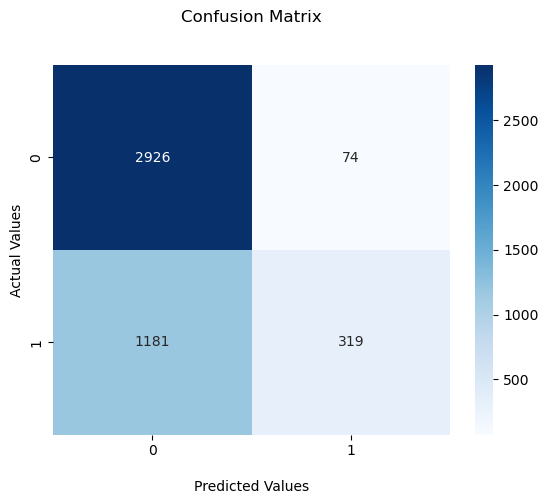

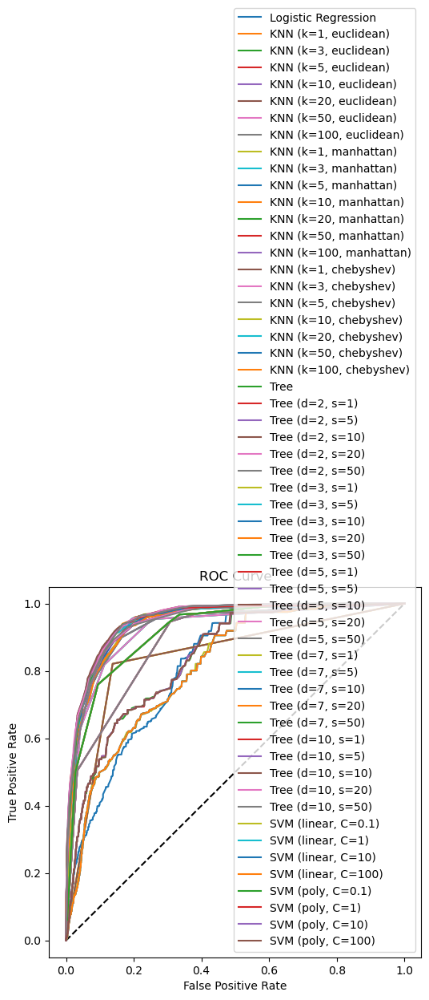


Testing SVM with kernel='rbf', C=0.1
Train F1 score: 0.7834
Test F1 score: 0.7847


<Figure size 1000x600 with 0 Axes>

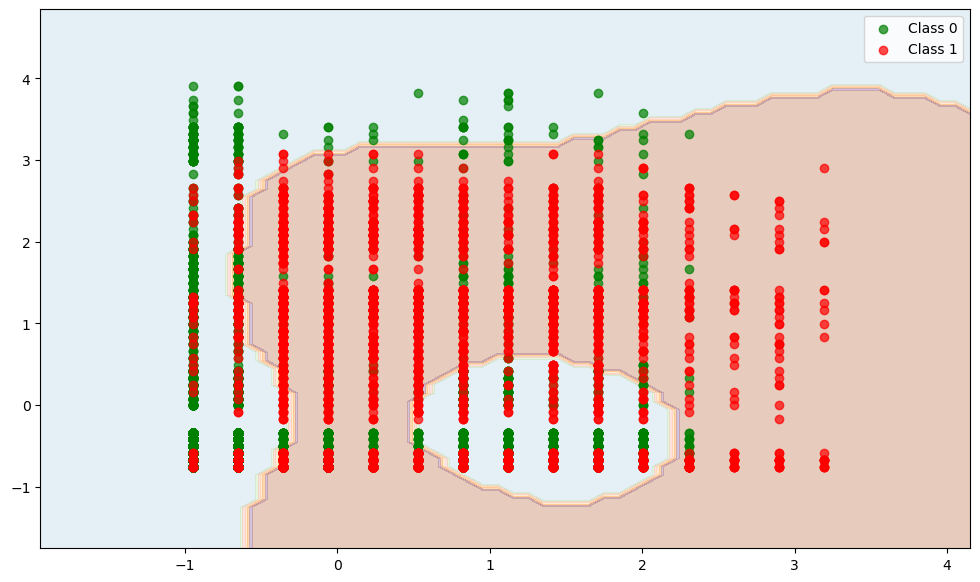

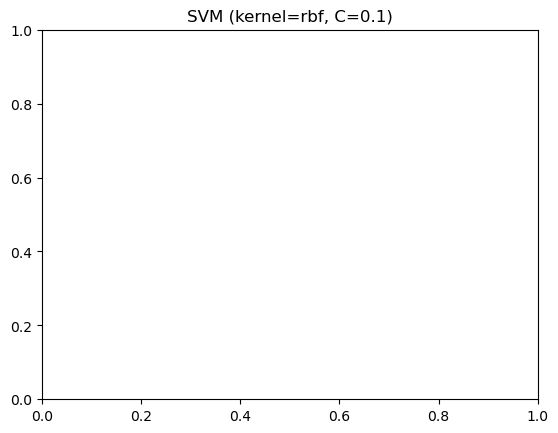

              precision    recall  f1-score   support

           0       0.89      0.90      0.89      3000
           1       0.79      0.78      0.78      1500

    accuracy                           0.86      4500
   macro avg       0.84      0.84      0.84      4500
weighted avg       0.86      0.86      0.86      4500



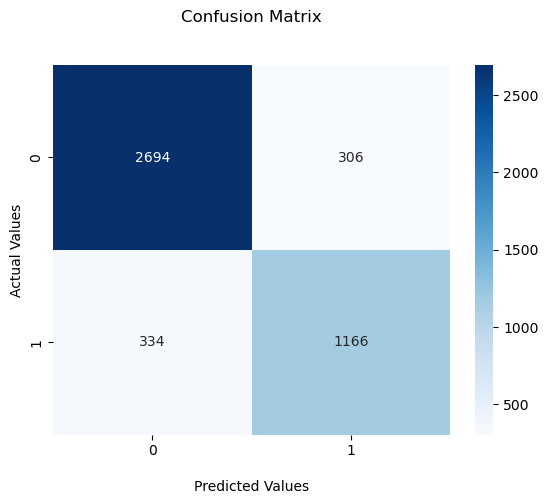

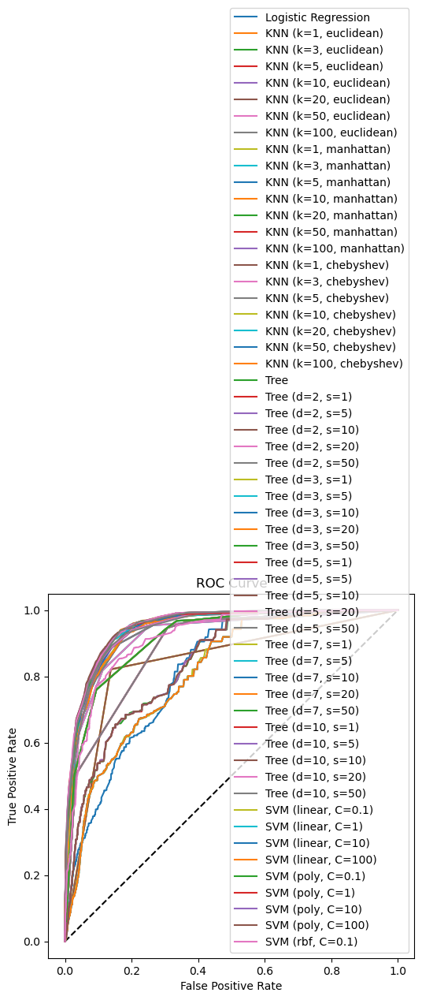


Testing SVM with kernel='rbf', C=1
Train F1 score: 0.7881
Test F1 score: 0.7934


<Figure size 1000x600 with 0 Axes>

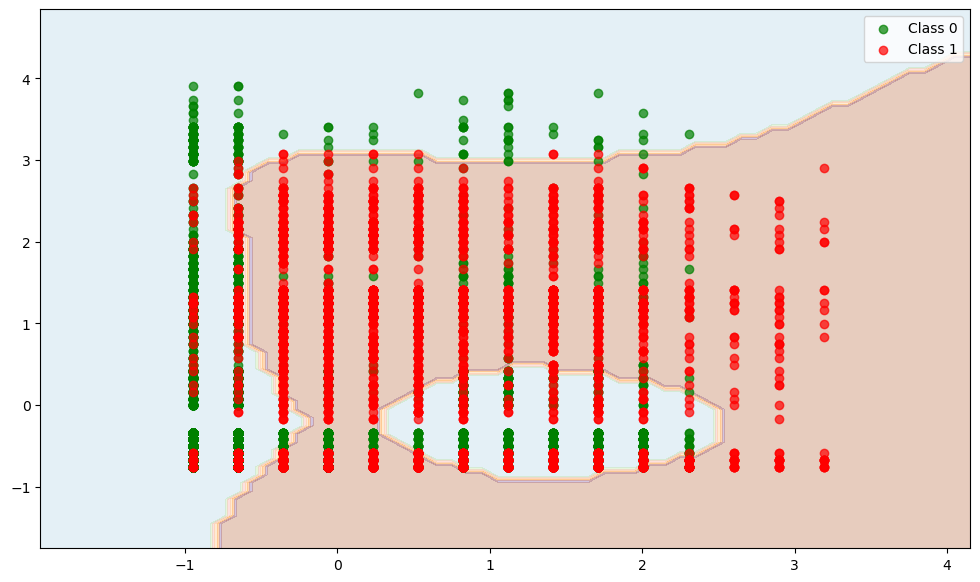

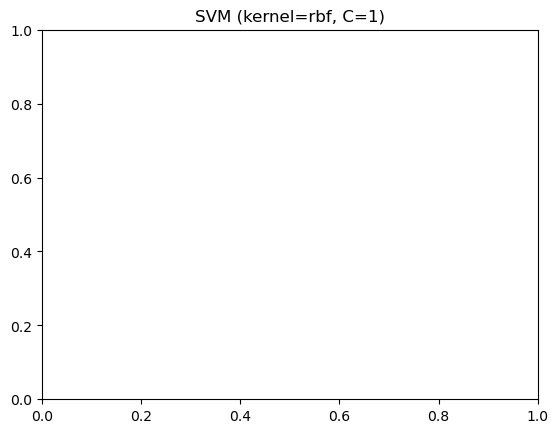

              precision    recall  f1-score   support

           0       0.89      0.90      0.90      3000
           1       0.80      0.79      0.79      1500

    accuracy                           0.86      4500
   macro avg       0.85      0.84      0.85      4500
weighted avg       0.86      0.86      0.86      4500



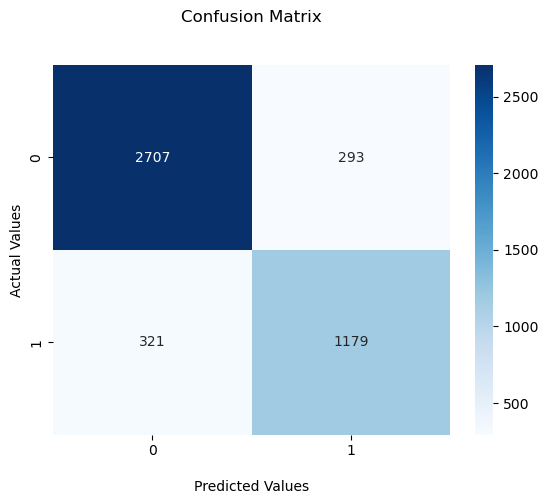

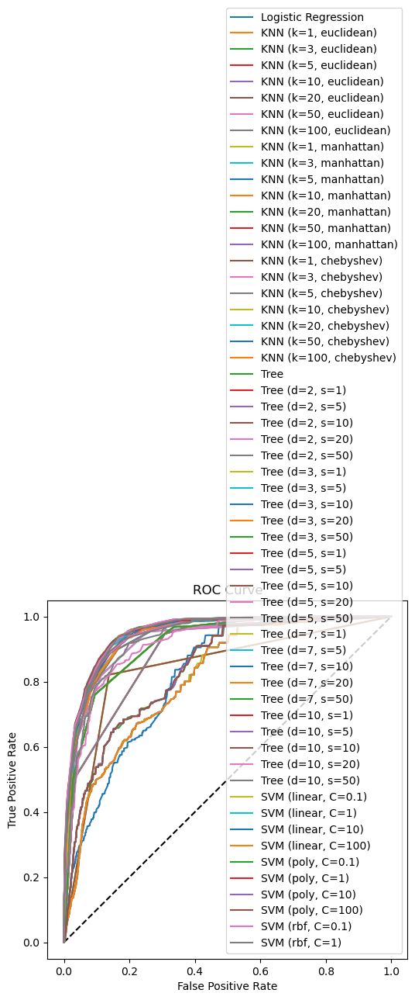


Testing SVM with kernel='rbf', C=10
Train F1 score: 0.7800
Test F1 score: 0.7865


<Figure size 1000x600 with 0 Axes>

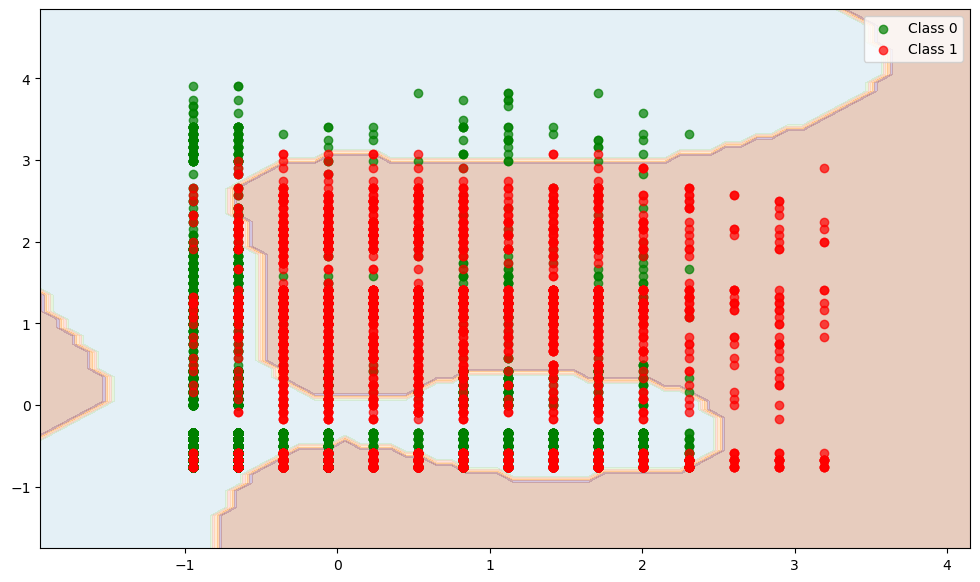

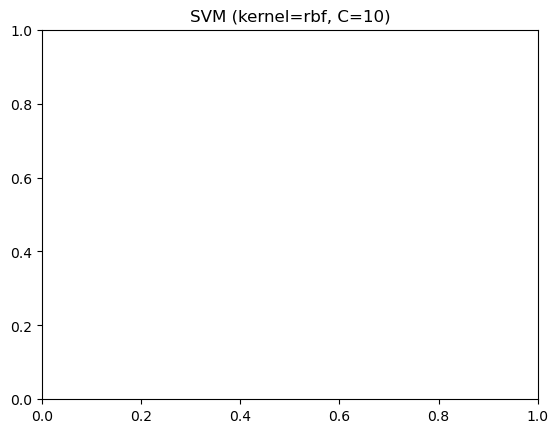

              precision    recall  f1-score   support

           0       0.88      0.92      0.90      3000
           1       0.83      0.75      0.79      1500

    accuracy                           0.86      4500
   macro avg       0.85      0.84      0.84      4500
weighted avg       0.86      0.86      0.86      4500



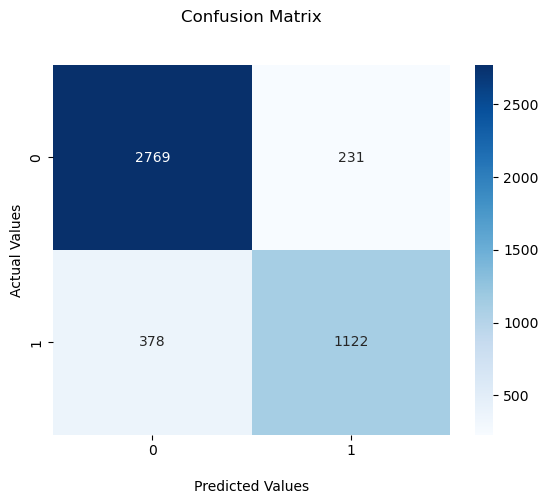

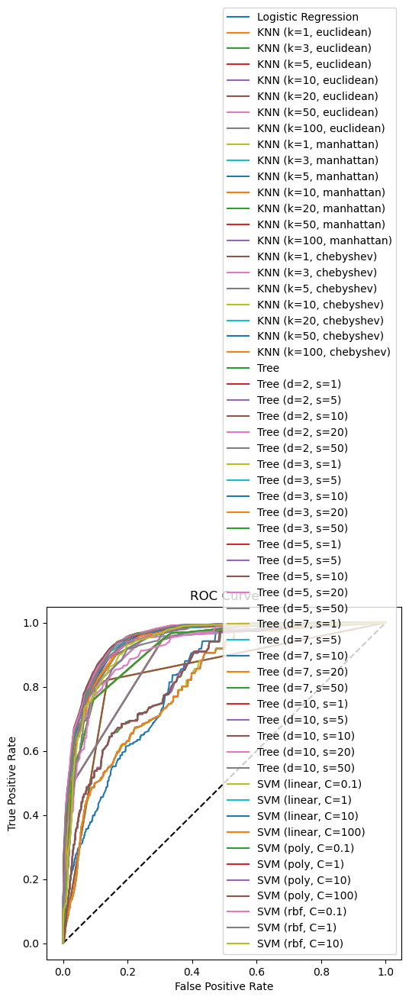


Testing SVM with kernel='rbf', C=100
Train F1 score: 0.7920
Test F1 score: 0.7957


<Figure size 1000x600 with 0 Axes>

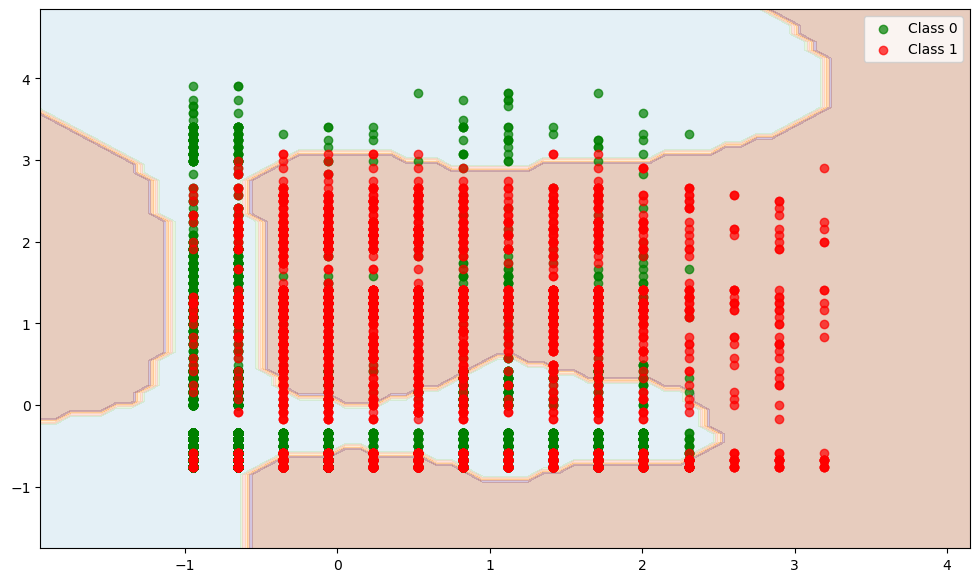

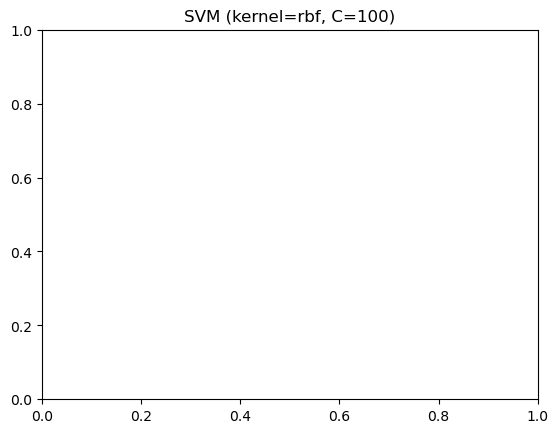

              precision    recall  f1-score   support

           0       0.89      0.92      0.90      3000
           1       0.82      0.77      0.80      1500

    accuracy                           0.87      4500
   macro avg       0.85      0.84      0.85      4500
weighted avg       0.87      0.87      0.87      4500



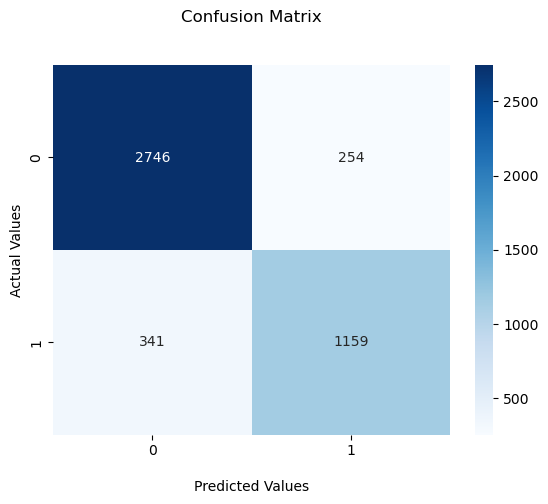

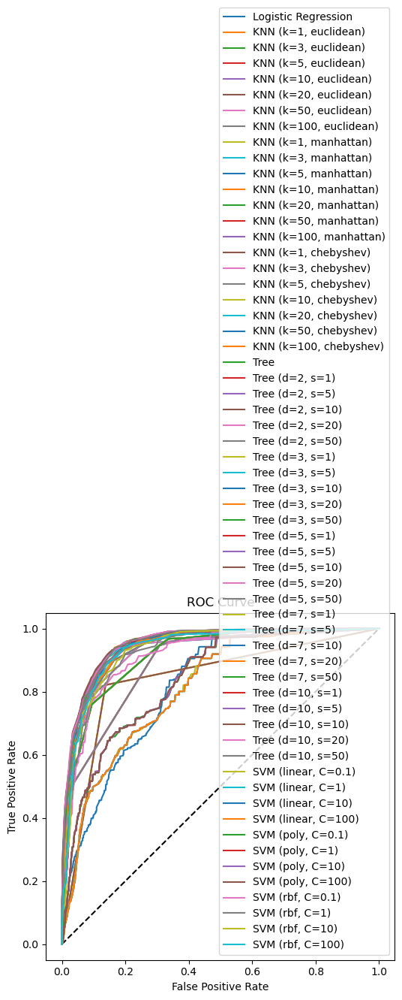


Testing SVM with kernel='sigmoid', C=0.1
Train F1 score: 0.4535
Test F1 score: 0.4439


<Figure size 1000x600 with 0 Axes>

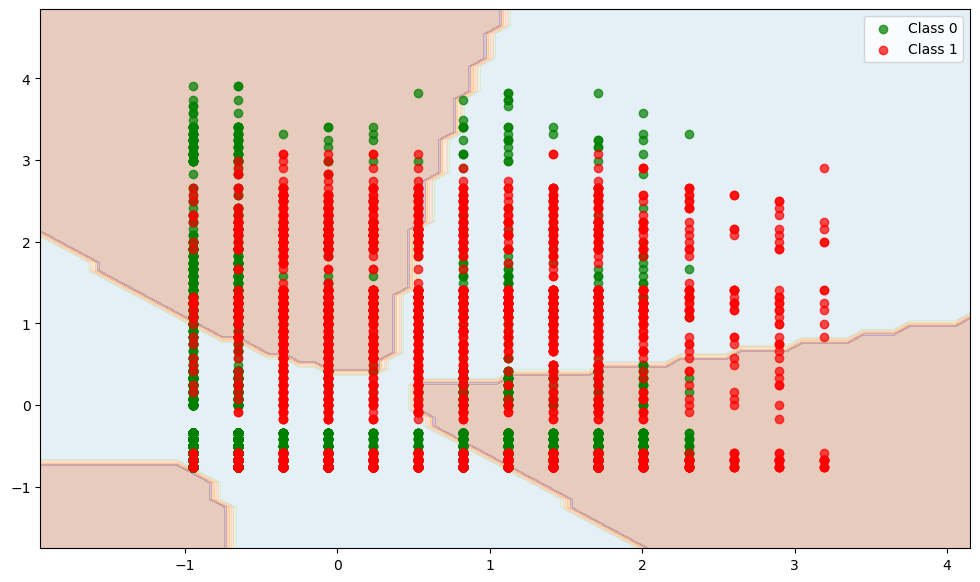

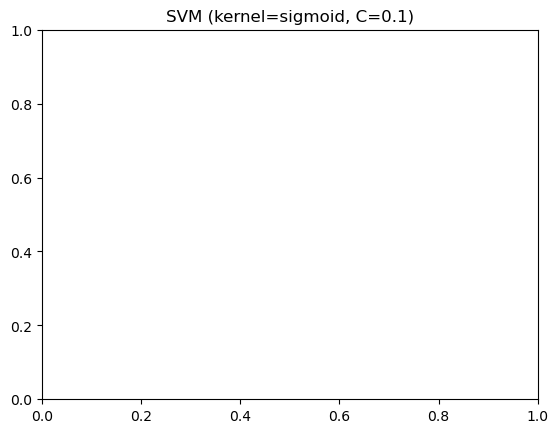

              precision    recall  f1-score   support

           0       0.72      0.76      0.74      3000
           1       0.47      0.42      0.44      1500

    accuracy                           0.65      4500
   macro avg       0.60      0.59      0.59      4500
weighted avg       0.64      0.65      0.64      4500



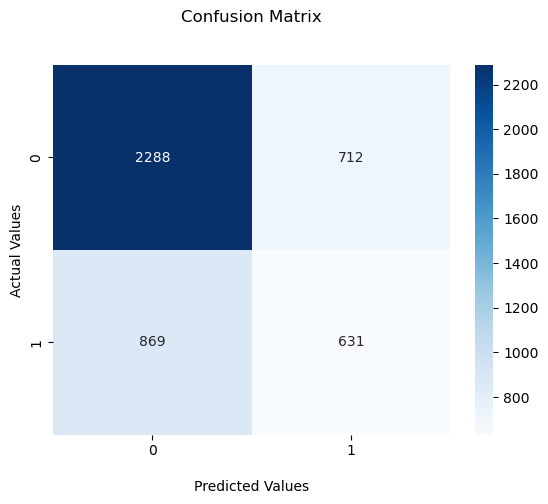

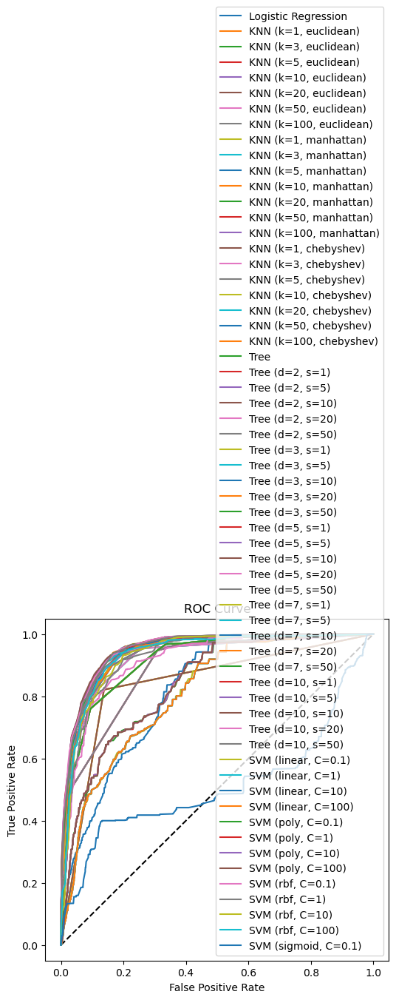


Testing SVM with kernel='sigmoid', C=1
Train F1 score: 0.4523
Test F1 score: 0.4422


<Figure size 1000x600 with 0 Axes>

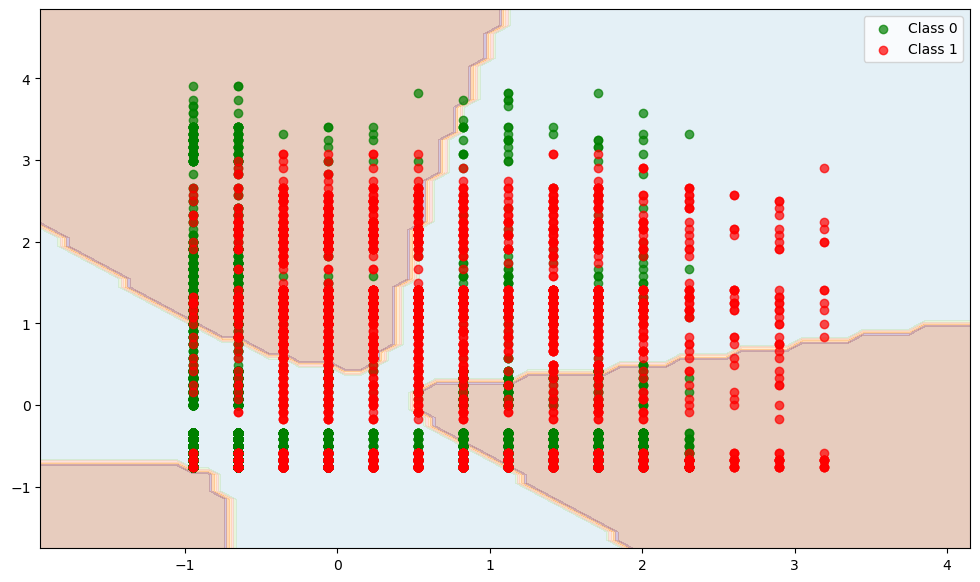

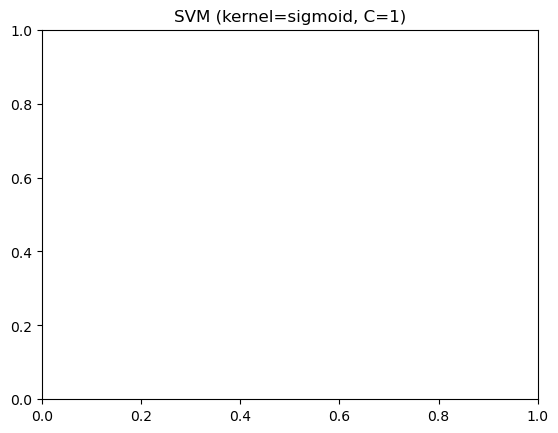

              precision    recall  f1-score   support

           0       0.72      0.76      0.74      3000
           1       0.47      0.42      0.44      1500

    accuracy                           0.65      4500
   macro avg       0.60      0.59      0.59      4500
weighted avg       0.64      0.65      0.64      4500



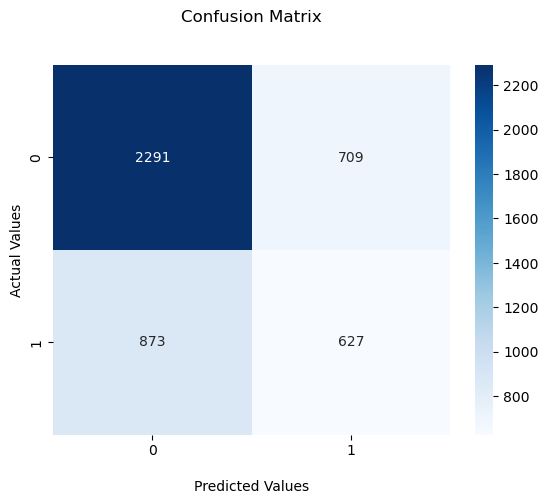

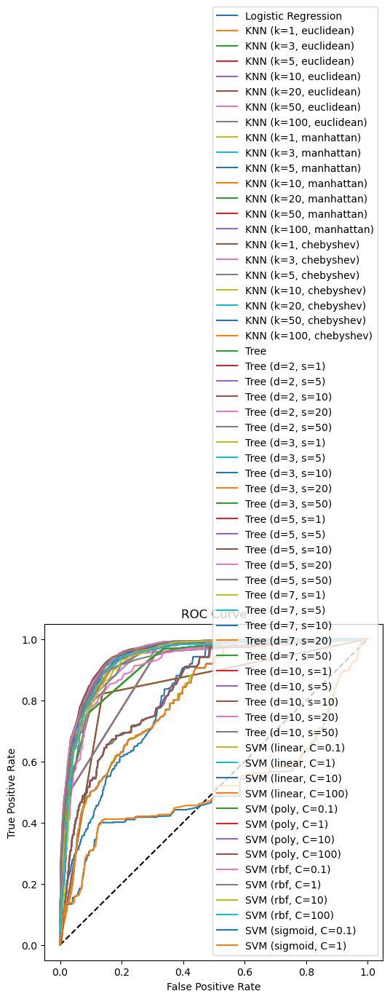


Testing SVM with kernel='sigmoid', C=10
Train F1 score: 0.4517
Test F1 score: 0.4430


<Figure size 1000x600 with 0 Axes>

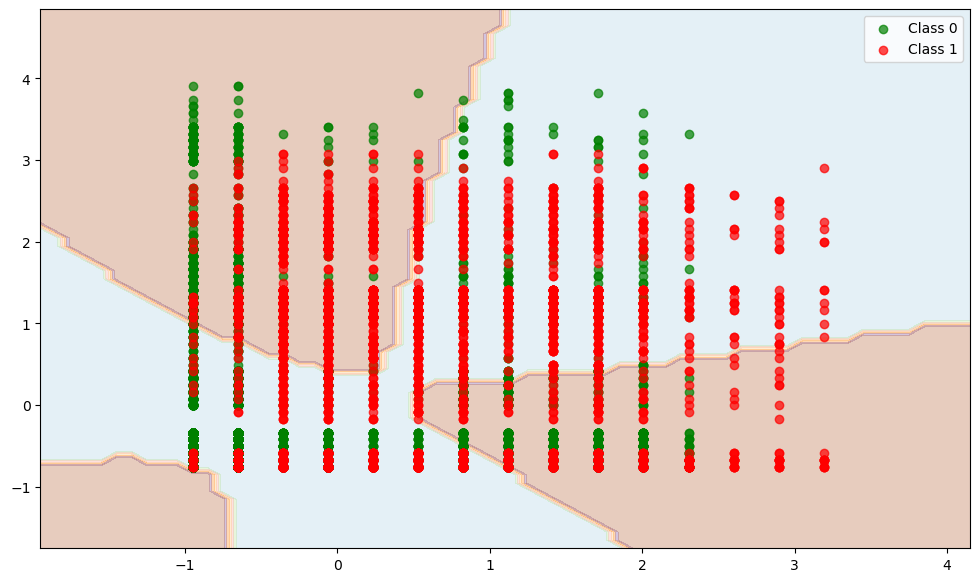

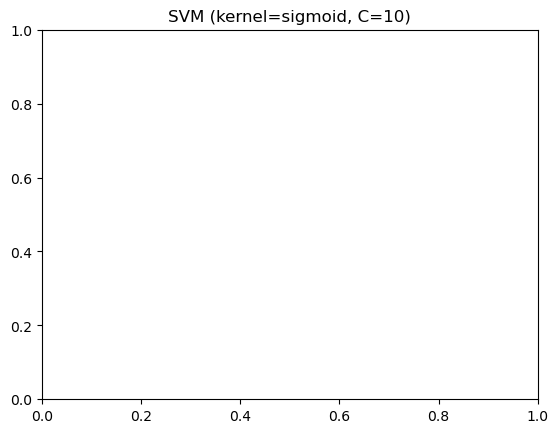

              precision    recall  f1-score   support

           0       0.72      0.76      0.74      3000
           1       0.47      0.42      0.44      1500

    accuracy                           0.65      4500
   macro avg       0.60      0.59      0.59      4500
weighted avg       0.64      0.65      0.64      4500



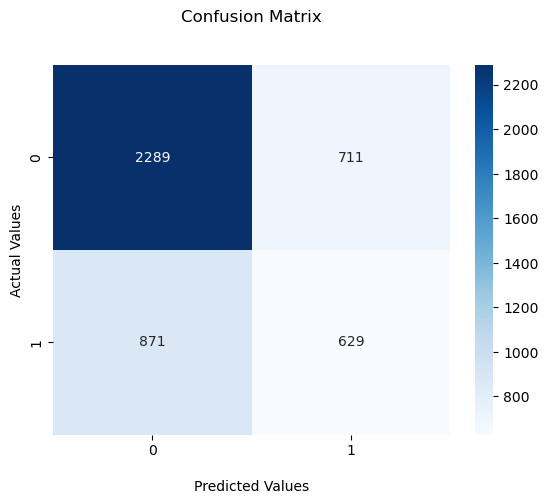

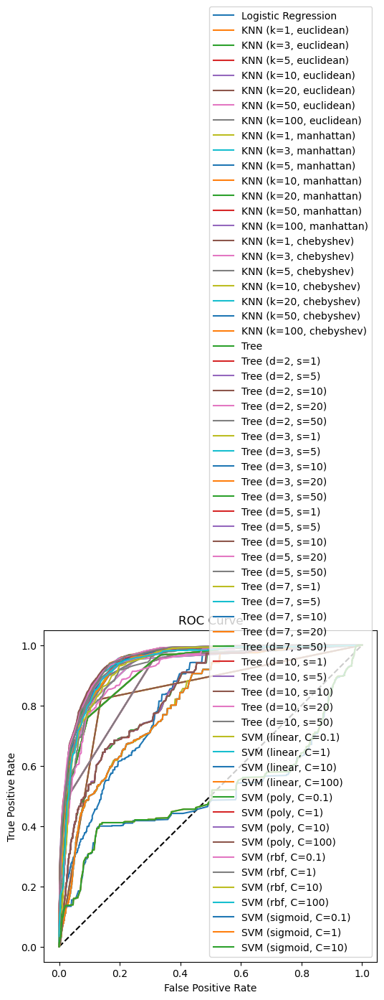


Testing SVM with kernel='sigmoid', C=100
Train F1 score: 0.4517
Test F1 score: 0.4430


<Figure size 1000x600 with 0 Axes>

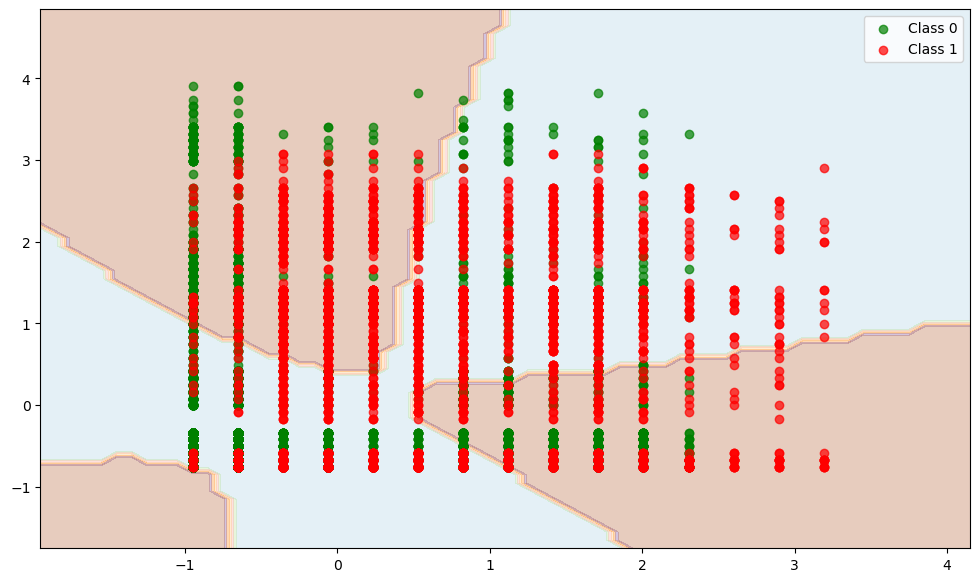

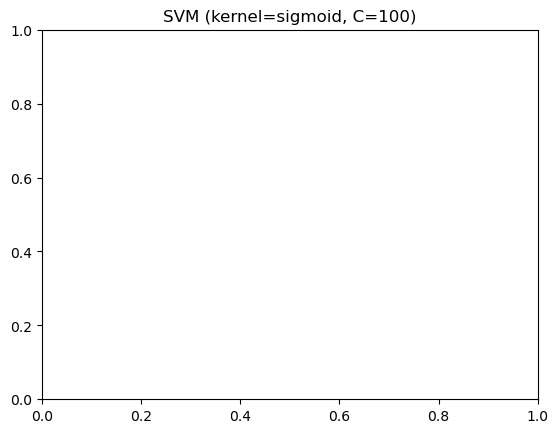

              precision    recall  f1-score   support

           0       0.72      0.76      0.74      3000
           1       0.47      0.42      0.44      1500

    accuracy                           0.65      4500
   macro avg       0.60      0.59      0.59      4500
weighted avg       0.64      0.65      0.64      4500



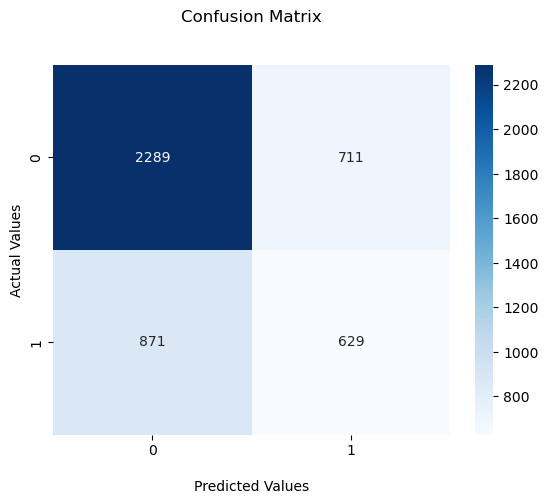

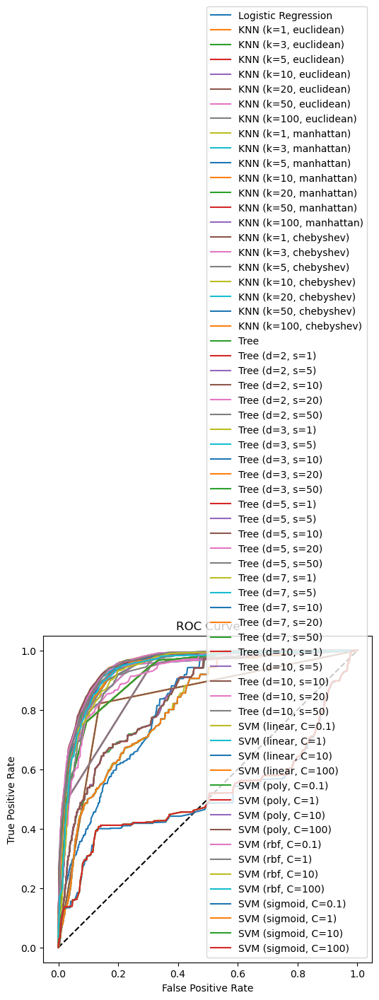

In [93]:
from sklearn.svm import SVC
from sklearn.metrics import f1_score
import matplotlib.pyplot as plt

# Różne wartości parametrów do przetestowania
C_values = [0.1, 1, 10, 100]
kernels = ['linear', 'poly', 'rbf', 'sigmoid']

for kernel in kernels:
    for C in C_values:
        print(f"\n{'='*50}")
        print(f"Testing SVM with kernel='{kernel}', C={C}")
        print(f"{'='*50}")
        
        # Tworzenie i trenowanie modelu
        model_svm = SVC(kernel=kernel, 
                       C=C, 
                       probability=True,  # potrzebne do ROC curve
                       random_state=0)
        model_svm.fit(X_train_standardized, y_train)
        
        # Predykcje i obliczenie F1 score
        y_train_pred = model_svm.predict(X_train_standardized)
        y_test_pred = model_svm.predict(X_test_standardized)
        
        f1_train = f1_score(y_train, y_train_pred)
        f1_test = f1_score(y_test, y_test_pred)
        
        print(f"Train F1 score: {f1_train:.4f}")
        print(f"Test F1 score: {f1_test:.4f}")
        
        # Wizualizacja powierzchni decyzyjnej
        plt.figure(figsize=(10, 6))
        plot_classification_surface(X_plot=X_train_standardized, 
                                  y_plot=y_train, 
                                  trained_model=model_svm)
        plt.title(f'SVM (kernel={kernel}, C={C})')
        plt.show()
        
        # Obliczenie i wyświetlenie innych metryk
        calculate_metrics(model_svm, 
                        f'SVM ({kernel}, C={C})', 
                        X_test_standardized, y_test)

### Random Forest – Las drzew decyzyjnych
### Dlaczego RandomForest działa?
### Ilość drzew decyzyjnych w RandomForest

In [94]:
model_forest = RandomForestClassifier(n_estimators=1000, max_depth=3, min_samples_leaf=int(X_train.shape[0]*0.001))
model_forest.fit(X_train, y_train)
plot_classification_surface(X_plot=np.array(X_train), y_plot=y_train, trained_model=model_forest)

NameError: name 'RandomForestClassifier' is not defined

In [ ]:
calculate_metrics(model_forest, 'Random Forest', X_test, y_test)

### Ćwiczenie
Sprawdź jak zachowuje się model dla różnych hiperparametrów drzewa. Zwizualizuj działanie modelu z wykorzystaniem funkcji plot_classification_surface oraz za każdym razem oblicz F1_score na zbiorze treningowym oraz testowym.

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score
import matplotlib.pyplot as plt

# Różne wartości parametrów do przetestowania
n_estimators_values = [50, 100, 500]  # Liczba drzew w lesie
max_depth_values = [None, 3, 5, 10]    # Maksymalna głębokość drzew
min_samples_leaf_values = [1, 5, 20]   # Minimalna liczba próbek w liściu

for n_est in n_estimators_values:
    for depth in max_depth_values:
        for min_samples in min_samples_leaf_values:
            print(f"\n{'='*50}")
            print(f"Testing Random Forest with n_estimators={n_est}, max_depth={depth}, min_samples_leaf={min_samples}")
            print(f"{'='*50}")
            
            # Tworzenie i trenowanie modelu
            model_forest = RandomForestClassifier(
                n_estimators=n_est,
                max_depth=depth,
                min_samples_leaf=min_samples,
                random_state=0,
                n_jobs=-1  # Wykorzystanie wszystkich procesorów
            )
            model_forest.fit(X_train, y_train)
            
            # Predykcje i obliczenie F1 score
            y_train_pred = model_forest.predict(X_train)
            y_test_pred = model_forest.predict(X_test)
            
            f1_train = f1_score(y_train, y_train_pred)
            f1_test = f1_score(y_test, y_test_pred)
            
            print(f"Train F1 score: {f1_train:.4f}")
            print(f"Test F1 score: {f1_test:.4f}")
            
            # Wizualizacja powierzchni decyzyjnej (tylko dla wybranych kombinacji)
            if depth in [None, 3, 5] and min_samples in [1, 5]:  # Ograniczenie liczby wykresów
                plt.figure(figsize=(10, 6))
                plot_classification_surface(
                    X_plot=np.array(X_train), 
                    y_plot=y_train, 
                    trained_model=model_forest
                )
                plt.title(f'Random Forest (n={n_est}, depth={depth}, min_samples={min_samples})')
                plt.show()
            
            # Obliczenie i wyświetlenie innych metryk
            calculate_metrics(
                model_forest, 
                f'RF (n={n_est}, d={depth}, s={min_samples})', 
                X_test, y_test
            )

### Boosting — AdaBoost

In [ ]:
from sklearn.ensemble import AdaBoostClassifier

model_adaboost = AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=1), n_estimators=50)
model_adaboost.fit(X_train, y_train)
plot_classification_surface(X_plot=np.array(X_train), y_plot=y_train, trained_model=model_adaboost)

### Ćwiczenie
Sprawdź jak zachowuje się model dla różnej liczby estymatorów. Zwizualizuj działanie modelu z wykorzystaniem funkcji plot_classification_surface oraz za każdym razem oblicz F1_score na zbiorze treningowym oraz testowym.

In [99]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score
import matplotlib.pyplot as plt

# Różne wartości liczby estymatorów do przetestowania
n_estimators_values = [10, 20, 50, 100, 200, 500]

for n_est in n_estimators_values:
    print(f"\n{'='*50}")
    print(f"Testing AdaBoost with n_estimators={n_est}")
    print(f"{'='*50}")
    
    # Tworzenie i trenowanie modelu
    model_adaboost = AdaBoostClassifier(
        base_estimator=DecisionTreeClassifier(max_depth=1),  # Słabe uczące (drzewa decyzyjne o głębokości 1)
        n_estimators=n_est,
        random_state=0
    )
    model_adaboost.fit(X_train, y_train)
    
    # Predykcje i obliczenie F1 score
    y_train_pred = model_adaboost.predict(X_train)
    y_test_pred = model_adaboost.predict(X_test)
    
    f1_train = f1_score(y_train, y_train_pred)
    f1_test = f1_score(y_test, y_test_pred)
    
    print(f"Train F1 score: {f1_train:.4f}")
    print(f"Test F1 score: {f1_test:.4f}")
    
    # Wizualizacja powierzchni decyzyjnej (dla wybranych wartości)
    if n_est in [10, 50, 100, 500]:  # Ograniczenie liczby wykresów
        plt.figure(figsize=(10, 6))
        plot_classification_surface(
            X_plot=np.array(X_train), 
            y_plot=y_train, 
            trained_model=model_adaboost
        )
        plt.title(f'AdaBoost (n_estimators={n_est})')
        plt.show()
    
    # Obliczenie i wyświetlenie innych metryk
    calculate_metrics(
        model_adaboost, 
        f'AdaBoost (n={n_est})', 
        X_test, y_test
    )


Testing AdaBoost with n_estimators=10


TypeError: AdaBoostClassifier.__init__() got an unexpected keyword argument 'base_estimator'

### Ensembling – Zespół klasyfikatorów

In [101]:
from sklearn.ensemble import VotingClassifier

model_voting = VotingClassifier(estimators=[('Tree', model_tree),
                                            ('Random Forest', model_forest),
                                            ('AdaBoost', model_adaboost)],
                                voting='soft')

model_voting.fit(X_train, y_train)
plot_classification_surface(X_plot=np.array(X_train), y_plot=y_train, trained_model=model_voting)
calculate_metrics(model_voting, 'VotingClassifier', X_test, y_test)

NameError: name 'model_forest' is not defined

### Ćwiczenie
Sprawdź jak zachowuje się model gdy połączysz modele parametryczne. Zwizualizuj działanie modelu z wykorzystaniem funkcji plot_classification_surface oraz za każdym razem oblicz F1_score na zbiorze treningowym oraz testowym.

In [105]:
from sklearn.ensemble import VotingClassifier
from sklearn.metrics import f1_score
import matplotlib.pyplot as plt
from itertools import combinations

# Lista dostępnych modeli (muszą być wcześniej wytrenowane)
models = [
    ('Logistic Regression', model_lr),
    ('Decision Tree', model_tree),
    ('Random Forest', model_forest),
    ('SVM', model_svm),
    ('AdaBoost', model_adaboost)
]

# Sprawdź wszystkie kombinacje od 2 do 4 modeli
for r in range(2, 5):
    for model_combination in combinations(models, r):
        model_names = [m[0] for m in model_combination]
        print(f"\n{'='*50}")
        print(f"Testing VotingClassifier with: {', '.join(model_names)}")
        print(f"{'='*50}")
        
        # Tworzenie i trenowanie modelu
        model_voting = VotingClassifier(
            estimators=list(model_combination),
            voting='soft',  # ważone głosowanie na podstawie prawdopodobieństw
            n_jobs=-1
        )
        model_voting.fit(X_train, y_train)
        
        # Predykcje i obliczenie F1 score
        y_train_pred = model_voting.predict(X_train)
        y_test_pred = model_voting.predict(X_test)
        
        f1_train = f1_score(y_train, y_train_pred)
        f1_test = f1_score(y_test, y_test_pred)
        
        print(f"Train F1 score: {f1_train:.4f}")
        print(f"Test F1 score: {f1_test:.4f}")
        
        # Wizualizacja powierzchni decyzyjnej (dla wybranych kombinacji)
        if r == 2 or r == 3:  # Ograniczenie liczby wykresów
            plt.figure(figsize=(10, 6))
            plot_classification_surface(
                X_plot=np.array(X_train), 
                y_plot=y_train, 
                trained_model=model_voting
            )
            plt.title(f'VotingClassifier ({", ".join(model_names)})')
            plt.show()
        
        # Obliczenie i wyświetlenie innych metryk
        calculate_metrics(
            model_voting, 
            f'Voting ({", ".join(model_names)})', 
            X_test, y_test
        )

NameError: name 'model_forest' is not defined

### Klasyfikacja na podstawie wielu zmiennych

In [107]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=0, stratify=y)
from sklearn.model_selection import GridSearchCV

random_forest = RandomForestClassifier(n_estimators=1000, n_jobs=-1)
params_rf = {'max_depth': [3, 5, 10, 20],
             'min_samples_leaf': [3, 5, 10, 15]}
rf_gridsearch = GridSearchCV(random_forest,
                             params_rf,
                             scoring='f1_macro',
                             cv=5,
                             verbose=10, n_jobs=-1)
rf_gridsearch.fit(X_train, y_train)
print('\nBest hyperparameter:', rf_gridsearch.best_params_)
rf_model_v2 = rf_gridsearch.best_estimator_


NameError: name 'RandomForestClassifier' is not defined

### Ćwiczenie
Naucz wszystkie poznane modele dla wszystkich zmiennych wybierając hiperparametry z wykorzystaniem GridSearch.

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
import warnings
warnings.filterwarnings('ignore')

# Definicja wszystkich modeli z przestrzenią parametrów
models = {
    'Logistic Regression': {
        'model': LogisticRegression(max_iter=1000),
        'params': {
            'C': [0.1, 1, 10],
            'penalty': ['l1', 'l2'],
            'solver': ['liblinear']
        }
    },
    'KNN': {
        'model': KNeighborsClassifier(),
        'params': {
            'n_neighbors': [3, 5, 7, 10],
            'weights': ['uniform', 'distance'],
            'metric': ['euclidean', 'manhattan']
        }
    },
    'Decision Tree': {
        'model': DecisionTreeClassifier(),
        'params': {
            'max_depth': [3, 5, 7, 10, None],
            'min_samples_leaf': [1, 3, 5, 10],
            'criterion': ['gini', 'entropy']
        }
    },
    'SVM': {
        'model': SVC(probability=True),
        'params': {
            'C': [0.1, 1, 10],
            'kernel': ['linear', 'rbf', 'poly'],
            'gamma': ['scale', 'auto']
        }
    },
    'Random Forest': {
        'model': RandomForestClassifier(n_estimators=100),
        'params': {
            'max_depth': [5, 10, 20, None],
            'min_samples_leaf': [1, 3, 5],
            'max_features': ['sqrt', 'log2']
        }
    },
    'AdaBoost': {
        'model': AdaBoostClassifier(),
        'params': {
            'n_estimators': [50, 100, 200],
            'learning_rate': [0.01, 0.1, 1.0]
        }
    }
}

# Słownik na wyniki
best_models = {}

# Przeszukiwanie siatki dla każdego modelu
for model_name, model_data in models.items():
    print(f'\n{"="*50}')
    print(f'Starting GridSearch for {model_name}')
    print(f'{"="*50}')
    
    grid = GridSearchCV(
        estimator=model_data['model'],
        param_grid=model_data['params'],
        scoring='f1',
        cv=5,
        n_jobs=-1,
        verbose=1
    )
    
    grid.fit(X_train, y_train)
    
    # Zapisz najlepszy model
    best_models[model_name] = grid.best_estimator_
    
    print(f'\nBest parameters for {model_name}:')
    print(grid.best_params_)
    print(f'Best F1 score: {grid.best_score_:.4f}')

# Ocena wszystkich modeli na zbiorze testowym
print('\n\nFinal evaluation on test set:')
for name, model in best_models.items():
    y_pred = model.predict(X_test)
    f1 = f1_score(y_test, y_pred)
    print(f'{name}: F1 = {f1:.4f}')
    
    # Oblicz dodatkowe metryki
    calculate_metrics(model, f'Optimized {name}', X_test, y_test)
    
    # Wizualizacja dla wybranych modeli
    if name in ['Decision Tree', 'SVM', 'Random Forest']:
        plt.figure(figsize=(10, 6))
        plot_classification_surface(
            X_plot=np.array(X_train), 
            y_plot=y_train, 
            trained_model=model
        )
        plt.title(f'Optimized {name} Decision Boundary')
        plt.show()


Starting GridSearch for Logistic Regression
Fitting 5 folds for each of 6 candidates, totalling 30 fits

Best parameters for Logistic Regression:
{'C': 10, 'penalty': 'l1', 'solver': 'liblinear'}
Best F1 score: 0.6514

Starting GridSearch for KNN
Fitting 5 folds for each of 16 candidates, totalling 80 fits

Best parameters for KNN:
{'metric': 'manhattan', 'n_neighbors': 10, 'weights': 'distance'}
Best F1 score: 0.7889

Starting GridSearch for Decision Tree
Fitting 5 folds for each of 40 candidates, totalling 200 fits

Best parameters for Decision Tree:
{'criterion': 'gini', 'max_depth': 10, 'min_samples_leaf': 5}
Best F1 score: 0.8684

Starting GridSearch for SVM
Fitting 5 folds for each of 18 candidates, totalling 90 fits


## 5. Klasyfikacja wieloklasowa